### Imports

In [3]:
import os
import tempfile
import numpy as np
import requests
import scanpy as sc
import scvi
import seaborn as sns
import torch
import sys, os
import anndata as ad
import matplotlib.pyplot as plt
module_dir = os.path.join(os.getcwd(), "/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_TF/analyses_scripts/")
if module_dir not in sys.path:
    sys.path.append(module_dir)
import perturb_seq_heuristic_pipeline as qc
import importlib
import matplotlib.pyplot as plt
importlib.reload(qc)

<module 'perturb_seq_heuristic_pipeline' from '/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_TF/analyses_scripts/perturb_seq_heuristic_pipeline.py'>

### Reading in the Data into MuData Format

In [ ]:
mtx_dir = "/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/cellranger_files/Aggregate/KOLF_Pan_Genome_Aggregate_10x_Analysis_Aggregate/SC_RNA_AGGREGATOR_CS/COUNT_AGGR/SC_RNA_AGGREGATOR/WRITE_MATRICES/fork0/files/filtered_matrix_mex"
save_directory = "/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_TF/adata_files/KOLF_Pan_Genome_Aggregate.h5mu"
adata = qc.read_in_10x_mtx(mtx_dir,save_directory)

    reading /tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/cellranger_files/Aggregate/KOLF_Pan_Genome_Aggregate_10x_Analysis_Aggregate/SC_RNA_AGGREGATOR_CS/COUNT_AGGR/SC_RNA_AGGREGATOR/WRITE_MATRICES/fork0/files/filtered_matrix_mex/matrix.mtx.gz
... writing an h5ad cache file to speedup reading next time


/tscc/nfs/home/ydoctor/.local/lib/python3.11/site-packages/anndata/utils.py:260: UserWarning: Suffix used (-[0-9]+) to deduplicate index values may make index values difficult to interpret. There values with a similar suffixes in the index. Consider using a different delimiter by passing `join={delimiter}`Example key collisions generated by the make_index_unique algorithm: ['SPATA13-1', 'SPATA13-2', 'SPATA13-3', 'MKKS-1', 'MKKS-2']


Number of cells detected: 5386783
Unique gRNA perturbed genes detected: 11691
Average gRNA detected per gene: 3.00
Total GEX UMIs: 36,899,684,352.0
Total CRISPR UMIs: 193,396,656.0
Total cells detected: 5386783
Total genes detected: 38606
Total gRNAs detected: 35989
Total NTC gRNAs detected: 947
Average GEX UMIs per cell: 6,850.04
Average CRISPR UMIs per cell: 35.90


In [1]:
import muon as mu
mdata = mu.read_h5mu("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_TF/adata_files/KOLF_Pan_Genome_Aggregate.h5mu")
adata = mdata.mod["rna"]
adata

/tscc/nfs/home/ydoctor/.local/lib/python3.11/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/tscc/nfs/home/ydoctor/.local/lib/python3.11/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


AnnData object with n_obs × n_vars = 5386783 × 38606
    var: 'gene_ids', 'feature_types'

### Assigning gRNA to Cells from the Protospacer Calls File and Metadata

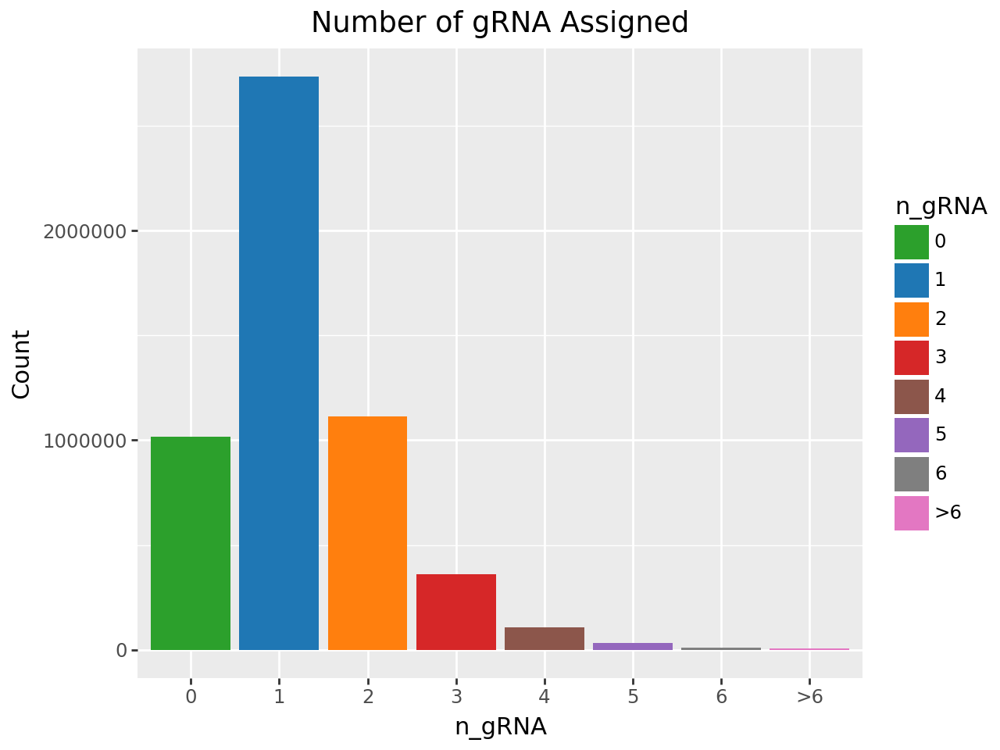

Cells without confident sgRNA calls: 18.89%
Estimated Multiplet Rate: 30.33%


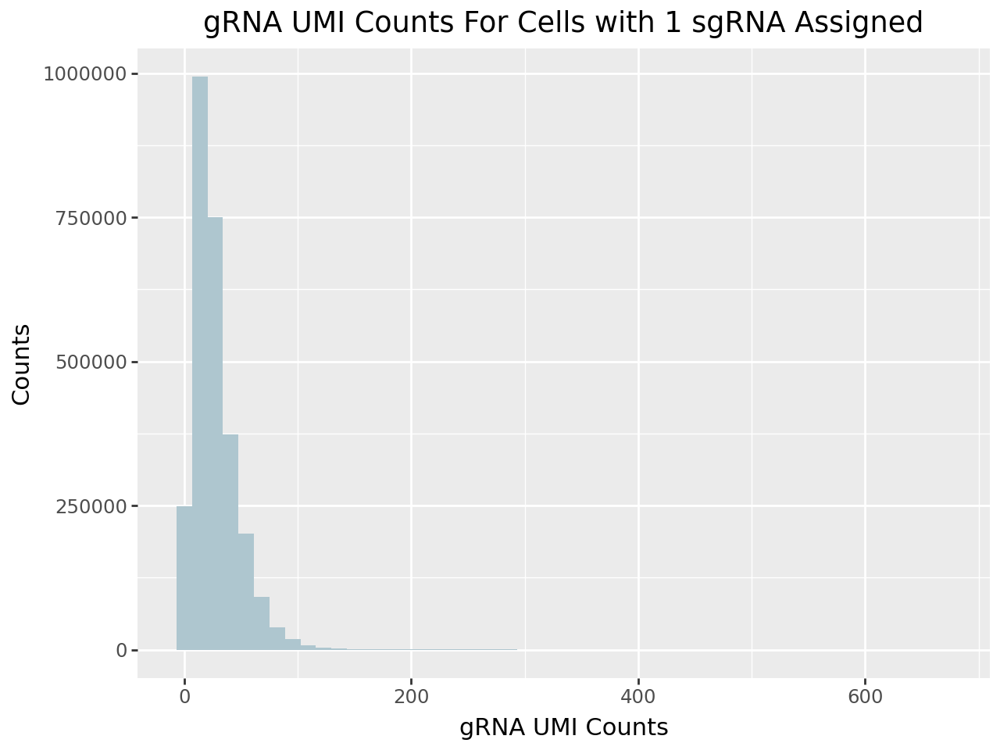

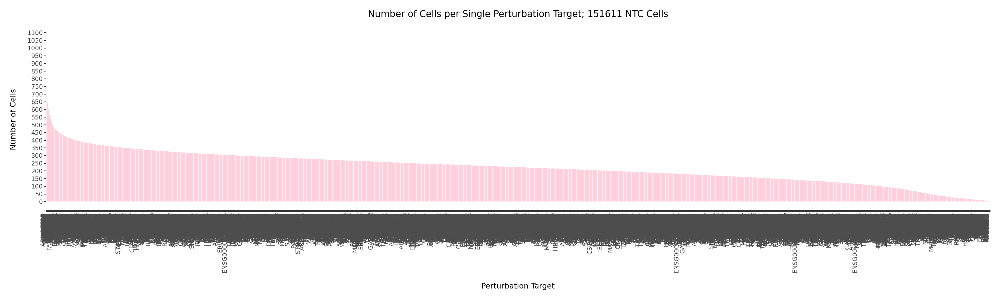

Number of perturbations with >= 50 cells with single guide assigned: 10933/11687 (93.55%)


In [4]:
protospacer_calls_file_path = "/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/cellranger_files/Aggregate/protospacer_calls_per_cell.csv"
adata = qc.assign_protospacers(adata,protospacer_calls_file_path=protospacer_calls_file_path)

In [12]:
import pandas as pd

# Get the gRNA value counts
gRNA_counts = adata[adata.obs.n_gRNA == 1].obs.gRNA.value_counts()

# Create the DataFrame with the desired column names
df = pd.DataFrame({
    "gRNA": gRNA_counts.index,
    "n_cells": gRNA_counts.values
})

print(df)
df.to_csv("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/output_files/cells_per_perturbation_unfiltered.csv")


                    gRNA  n_cells
0              CTAGE15_3      608
1      Non-Targeting_744      495
2                 DUX4_2      484
3      Non-Targeting_629      417
4      Non-Targeting_883      411
...                  ...      ...
35660          ATP6V1D_3        1
35661            NRDE2_2        1
35662            DCTN3_3        1
35663          RSL24D1_2        1
35664           MRPL18_1        1

[35665 rows x 2 columns]


In [4]:
import pandas as pd
d = pd.read_csv('/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/cellranger_files/Aggregate/aggregation_csv.csv')
channel_dict = {str(i+1):channel for i,channel in enumerate(d["sample_id"])}
adata = qc.assign_metadata(adata=adata,cell_type="KOLF2.1J iPSC",perturbation_type="CRISPRi Perturb-Seq",channel_dict=channel_dict)
adata.obs['n_gRNA_UMIs'] = adata.obs['n_gRNA_UMIs'].astype(str)
adata.write("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Pan_Genome_Basic_QC.h5ad")

/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_TF/analyses_scripts/perturb_seq_heuristic_pipeline.py:175: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


normalizing counts per cell
    finished (0:02:29)


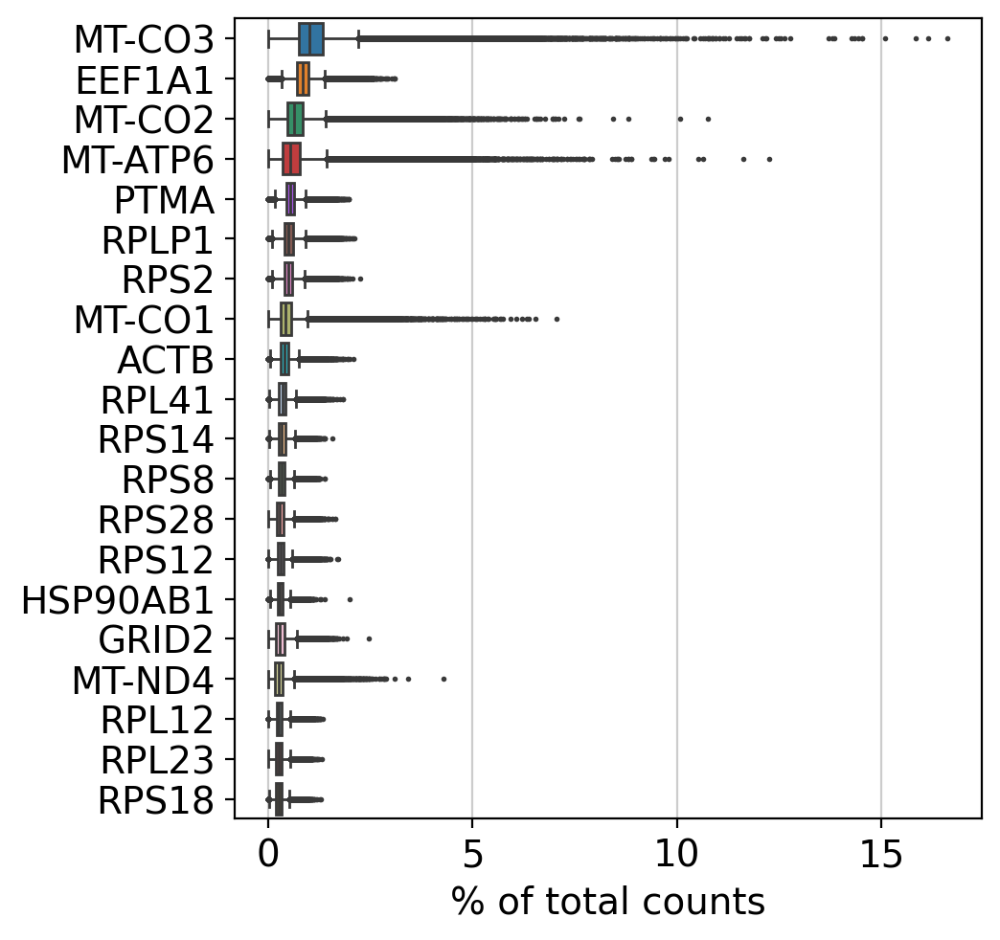

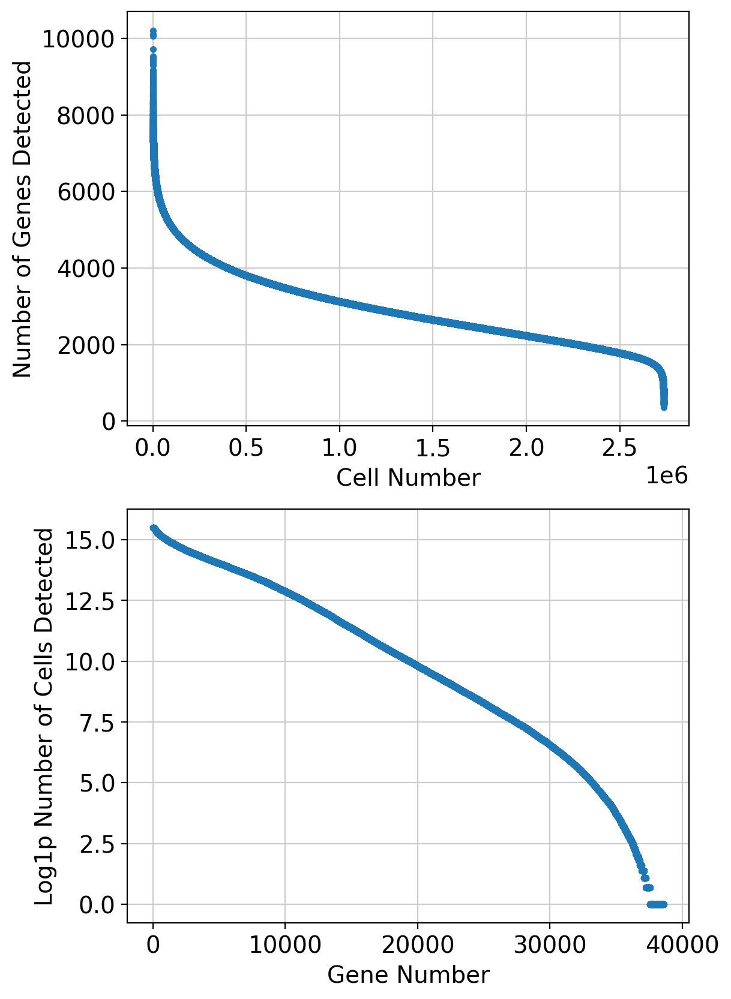

Removing 1039 genes not detected in any cells.


In [5]:
adata = qc.general_qc(adata)

/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_TF/analyses_scripts/perturb_seq_heuristic_pipeline.py:201: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.


outlier
False    2663490
True       71960
Name: count, dtype: int64

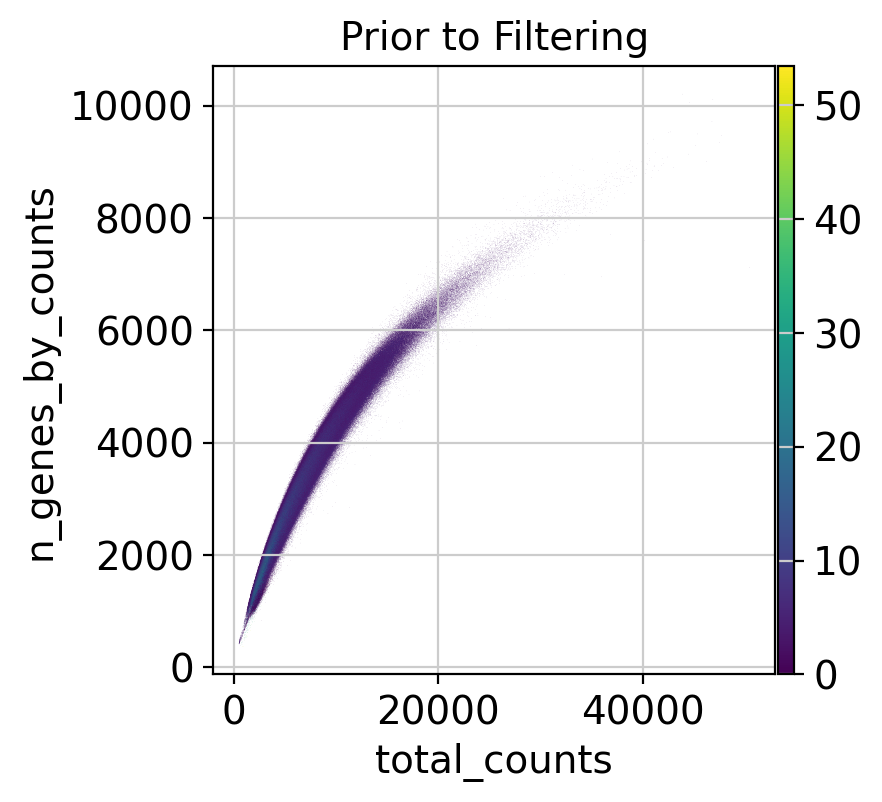

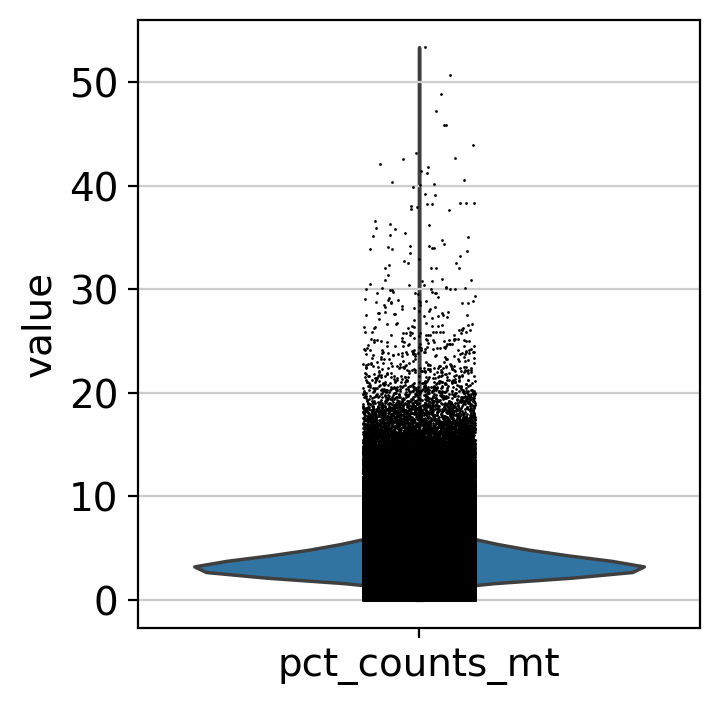

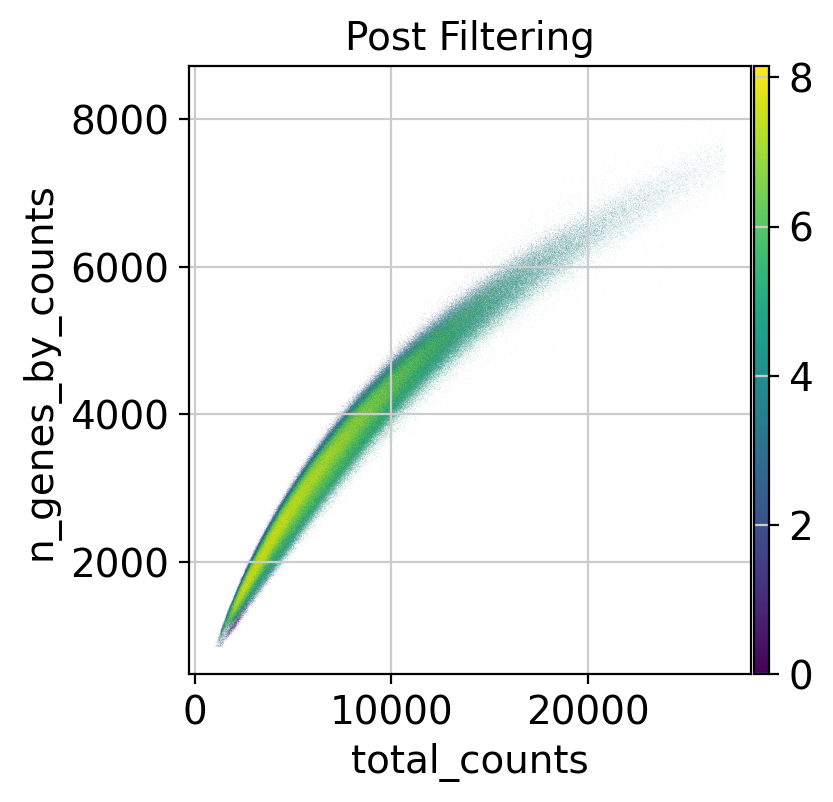

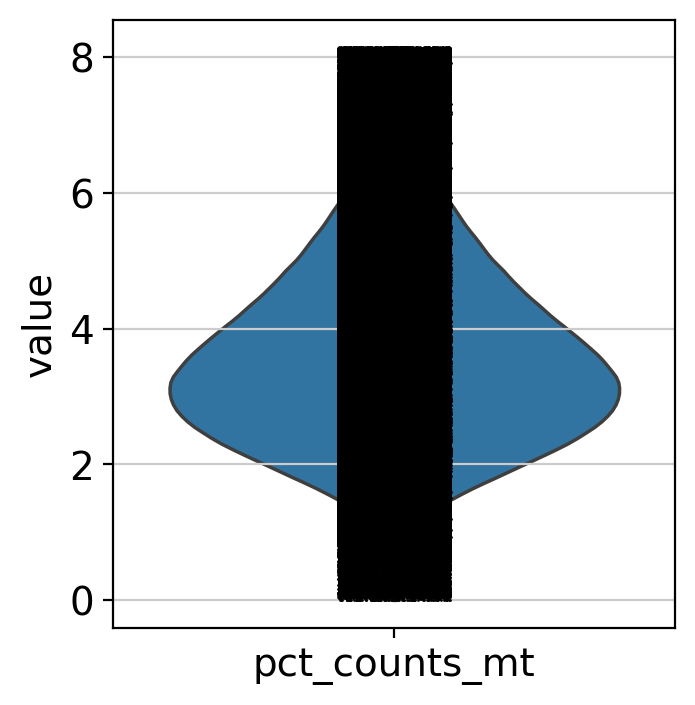

In [6]:
adata = qc.dead_cell_qc(adata, mt_MADs=5)

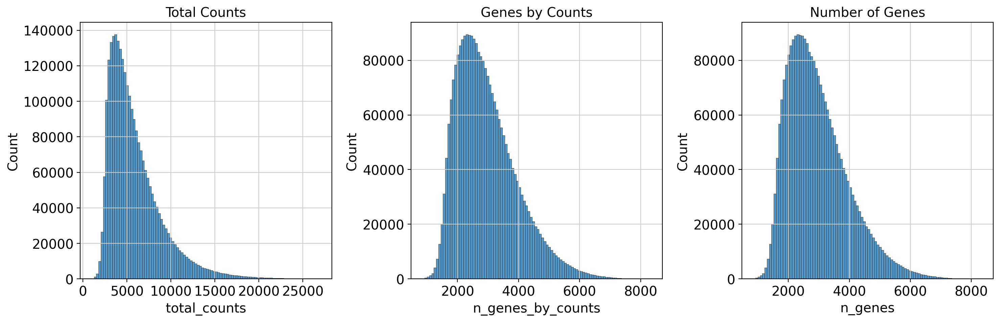

In [7]:
qc.doublet_detection_sanity_check(adata)

In [8]:
#Saving temporarily
adata.write("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_Basic_QC_Cell_QC.h5ad")

### Filtering to Core NTC Cells

We constructed a sgRNA "whitelist" by taking the Day-14 fitness data. We (1) take all sgRNA shared across chip ALPHA, BETA, GAMMA. (2) Filter for sgRNA within the middle 50% IQR of fitness l2fc at day 14. (median is ~0.2, max is 1.0, min is -0.4)

In [2]:
def _get_ntc_view(adata):
  return adata[adata.obs.perturbed=="False"]

def _get_perturbed_view(adata):
  return adata[adata.obs.perturbed=="True"]

In [17]:
adata.layers["counts"] = adata.X.copy()
adata.obs["run"] = [label.split('-')[0] for label in adata.obs.channel]
def _get_ntc_view(adata):
  return adata[adata.obs.perturbed=="False"]

with open("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/input_files/NTC_sgRNA_whitelist.txt", 'r') as f:
  sgRNA_whitelist = f.read().splitlines()
ntc_adata = _get_ntc_view(adata)
ntc_adata = ntc_adata[ntc_adata.obs.gRNA.isin(sgRNA_whitelist)].copy()
ntc_adata

AnnData object with n_obs × n_vars = 53476 × 37567
    obs: 'gRNA', 'n_gRNA', 'n_gRNA_UMIs', 'gene_target', 'celltype', 'perturbation_type', 'n_UMI_counts', 'n_genes', 'perturbed', 'channel', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'run'
    var: 'gene_ids', 'feature_types', 'n_UMI_counts', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    layers: 'counts'

Initial number of NTC Cells: 53476
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)
calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    342 total control genes are used. (0:00:00)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    300 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    with n_comps=100
    finished (0:00:38)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_varian

  0%|          | 0/200 [00:00<?, ?it/s]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:30)


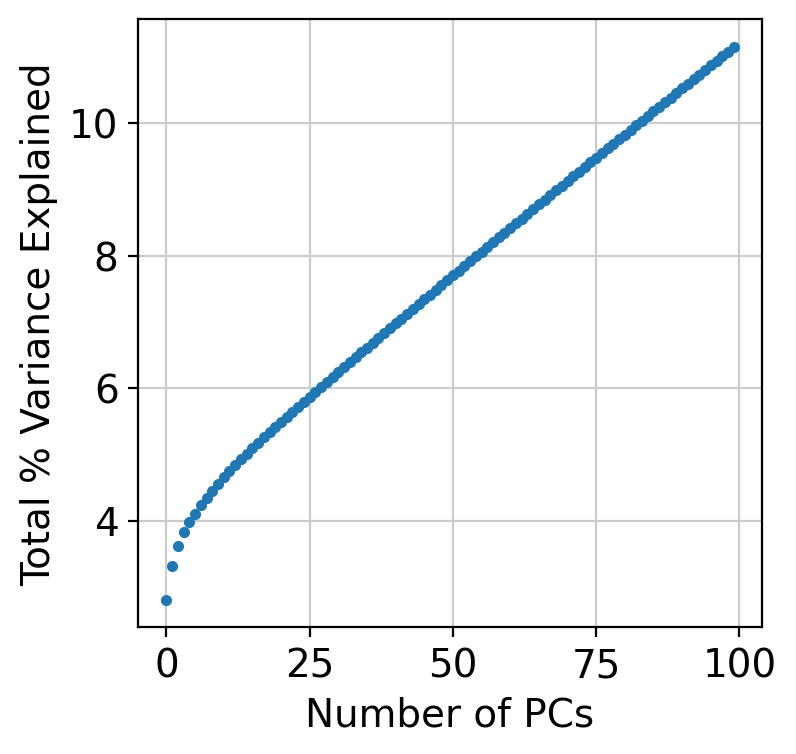

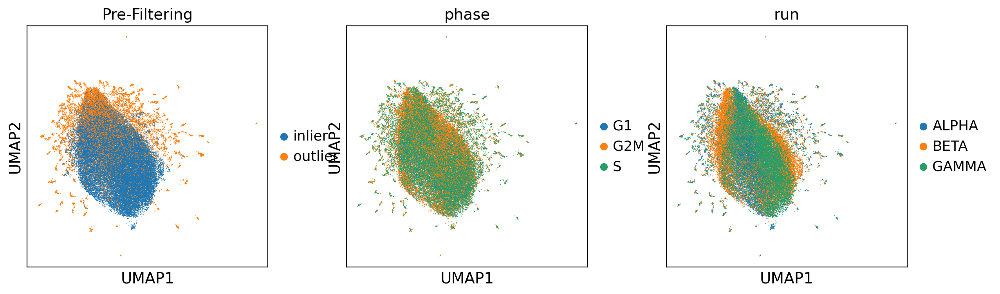

computing density on 'umap'
--> added
    'umap_density', densities (adata.obs)
    'umap_density_params', parameter (adata.uns)


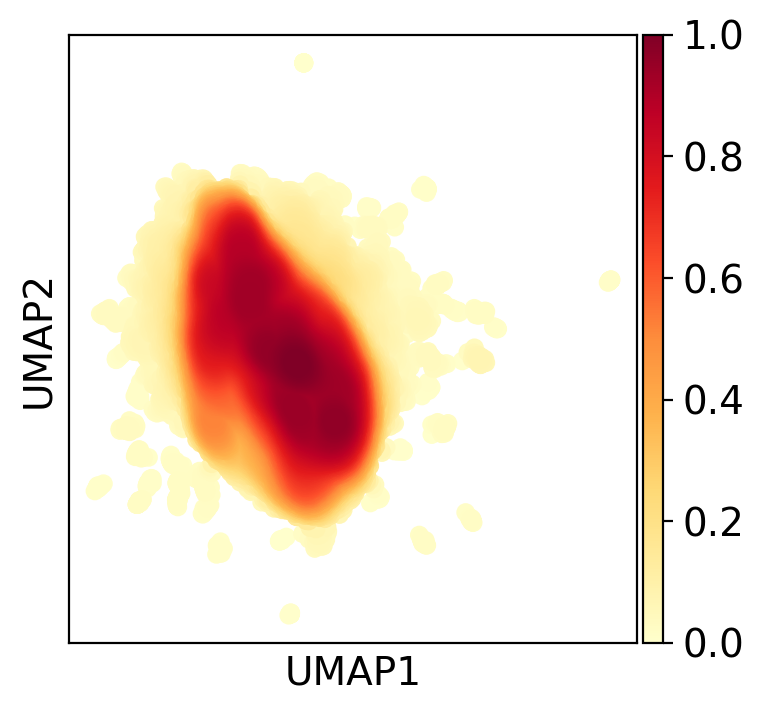

computing neighbors
        initialized `.distances` `.connectivities` 
    computing neighbors


/opt/conda/lib/python3.11/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.


    computed neighbors (0:00:04)
    computed connectivities (0:00:00)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:29)
computing UMAP


  0%|          | 0/200 [00:00<?, ?it/s]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:21)


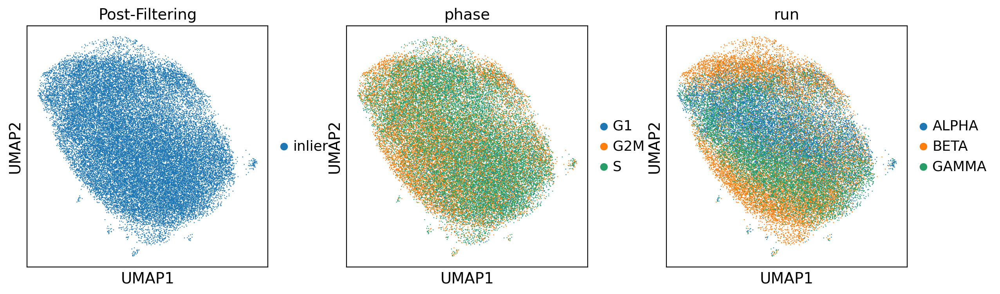

computing density on 'umap'
--> added
    'umap_density', densities (adata.obs)
    'umap_density_params', parameter (adata.uns)


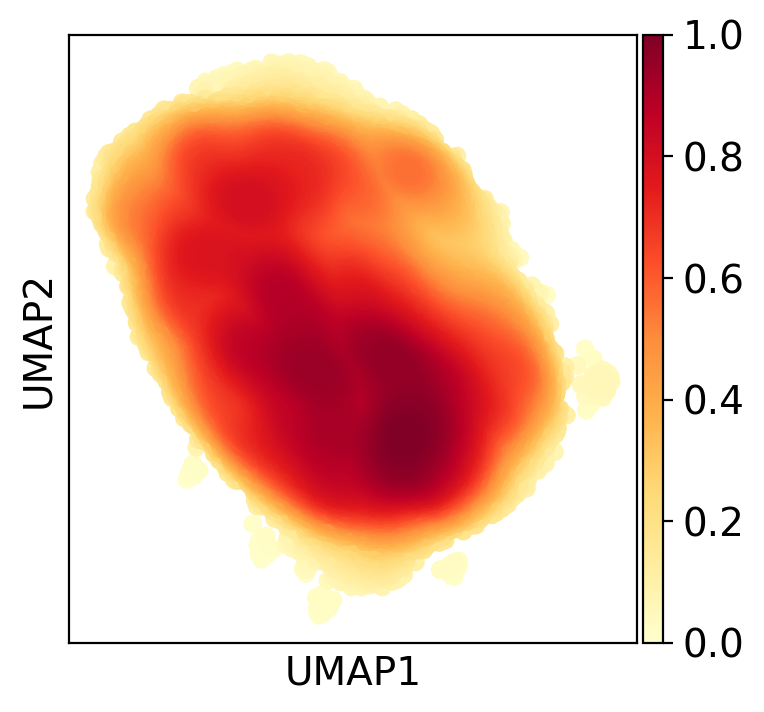

In [18]:
from sklearn.ensemble import IsolationForest

def get_cell_cycle_genes() -> list:
    # Canonical list of cell cycle genes
    url = "https://raw.githubusercontent.com/scverse/scanpy_usage/master/180209_cell_cycle/data/regev_lab_cell_cycle_genes.txt"
    cell_cycle_genes = requests.get(url).text.split("\n")[:-1]
    s_genes = cell_cycle_genes[:43]
    g2m_genes = cell_cycle_genes[43:]
    return s_genes, g2m_genes

def _scrub_ntc_pca(adata):
    sc.pp.highly_variable_genes(adata, n_top_genes=2000, subset=False, flavor='seurat_v3', layer='counts',batch_key="run")
    s_genes, g2m_genes = get_cell_cycle_genes()
    sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes, use_raw=False)
    sc.pp.log1p(adata)
    sc.pp.scale(adata)
    sc.pp.pca(adata,n_comps = 100)
    plt.plot(100 * np.cumsum(adata.uns["pca"]["variance_ratio"]),'.')
    plt.xlabel("Number of PCs")
    plt.ylabel("Total % Variance Explained")

def _scrub_ntc_isolation_forest(adata, contamination_threshold, embedding):
    # Isolate data
    rep = f"X_{embedding}"
    data = adata.obsm[rep]
    # Fit the Isolation Forest4
    clf = IsolationForest(contamination=contamination_threshold)  # By default, conservatively assume half your data is outliers. we have so many NTCs, so we can afford to throw away half.
    clf.fit(data)
    # Classify points as outliers (-1) and inliers (1)
    labels = clf.predict(data)
    adata.obs['is_outlier'] = labels
    adata.obs['is_outlier'] = adata.obs['is_outlier'].replace({-1: 'outlier', 1: 'inlier'})
    # Visualize the outlier classification Pre-Filtering
    sc.pp.neighbors(adata, use_rep=rep)
    sc.tl.umap(adata)
    sc.pl.umap(adata, color=["is_outlier","phase","run"], title="Pre-Filtering")
    sc.tl.embedding_density(adata)
    sc.pl.embedding_density(adata)
    # Visualize the outlier classification Post-Filtering
    adata_filtered = adata[adata.obs.is_outlier == "inlier",:]
    sc.pp.neighbors(adata_filtered, use_rep=rep)
    sc.tl.umap(adata_filtered)
    sc.pl.umap(adata_filtered, color=["is_outlier","phase","run"], title="Post-Filtering")
    sc.tl.embedding_density(adata_filtered)
    sc.pl.embedding_density(adata_filtered)
    return list(adata_filtered.obs.index)


def scrub_ntc(adata_ntc, contamination_threshold = 0.3, embedding = "pca"):
    print(f"Initial number of NTC Cells: {len(adata_ntc)}")
    # Generate an embedding for the data
    if embedding == "pca":
        _scrub_ntc_pca(adata_ntc)
    else:
        print("Embedding type not recognized, defaulting to PCA. ")
        _scrub_ntc_pca(adata_ntc)
    # Scrub for valid NTC Cells
    valid_ntc_cells = _scrub_ntc_isolation_forest(adata_ntc, contamination_threshold, embedding)
    return valid_ntc_cells

ntc_adata = ntc_adata[ntc_adata.obs.index.isin(scrub_ntc(ntc_adata))]

In [19]:
ntc_adata

View of AnnData object with n_obs × n_vars = 37433 × 37567
    obs: 'gRNA', 'n_gRNA', 'n_gRNA_UMIs', 'gene_target', 'celltype', 'perturbation_type', 'n_UMI_counts', 'n_genes', 'perturbed', 'channel', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'run', 'S_score', 'G2M_score', 'phase', 'is_outlier', 'umap_density'
    var: 'gene_ids', 'feature_types', 'n_UMI_counts', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'umap', 'is_outlier_colors', 'phase_colo

In [20]:
ntc_adata.obs.run.value_counts()

run
ALPHA    14146
BETA     13603
GAMMA     9684
Name: count, dtype: int64

In [21]:
#subsetting to core NTC cells
perturbed_mask = adata.obs.perturbed =="True"
valid_ntc_mask = adata.obs.index.isin(ntc_adata.obs.index)
adata = adata[perturbed_mask | valid_ntc_mask,:].copy()
adata.write("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_Core_NTC.h5ad")

### Data Post NTC Filtering

In [2]:
import anndata as ad
import os
import tempfile
import numpy as np
import requests
import scanpy as sc
import scvi
import seaborn as sns
import torch
import sys, os
import anndata as ad
import matplotlib.pyplot as plt
module_dir = os.path.join(os.getcwd(), "/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_TF/analyses_scripts/")
if module_dir not in sys.path:
    sys.path.append(module_dir)
import perturb_seq_heuristic_pipeline as qc
import importlib
import numpy as np
import pertpy as pt
adata = ad.read_h5ad("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_Core_NTC.h5ad")

In [11]:
adata[adata.obs["perturbed"] == "False"]

View of AnnData object with n_obs × n_vars = 37433 × 37567
    obs: 'gRNA', 'n_gRNA', 'n_gRNA_UMIs', 'gene_target', 'celltype', 'perturbation_type', 'n_UMI_counts', 'n_genes', 'perturbed', 'channel', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'run'
    var: 'gene_ids', 'feature_types', 'n_UMI_counts', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    layers: 'counts'

10281/11739 (87.58)% Perturbations have > 100 cells


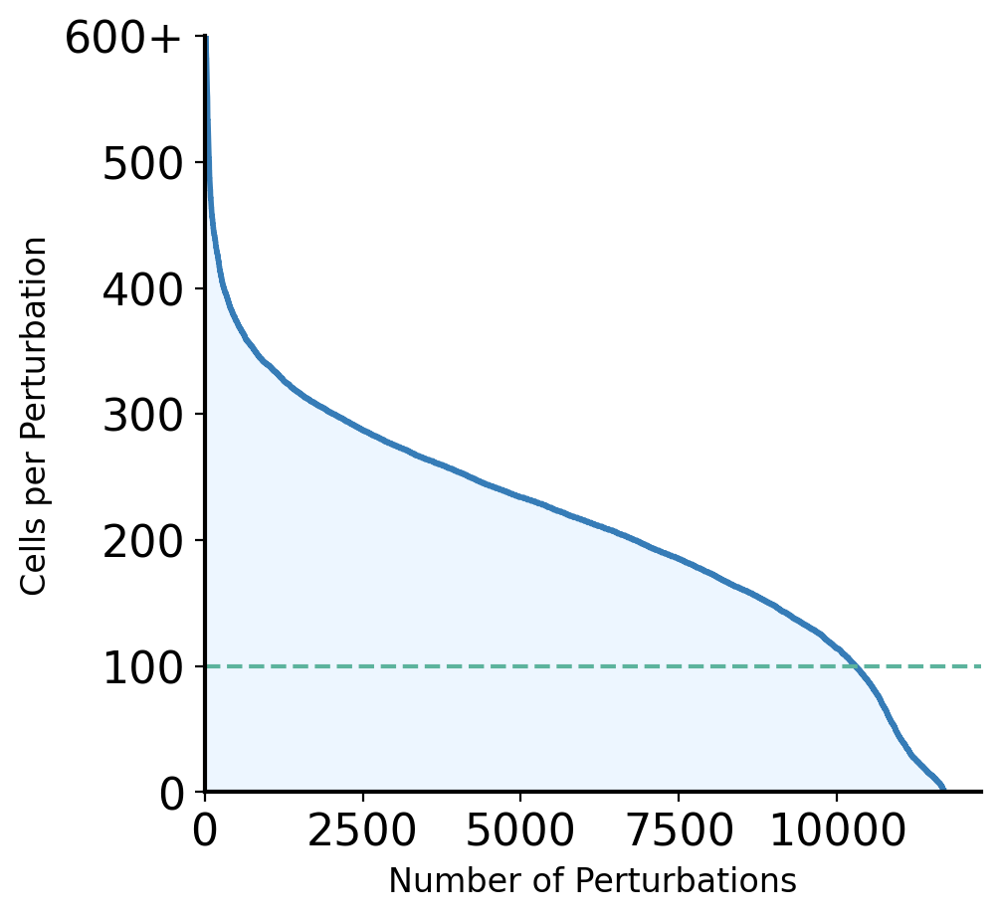

In [31]:
import matplotlib.pyplot as plt
import numpy as np

def plot_cells_per_perturbation(adata, perturbation_key='gene_target', perturbed_key='perturbed'):
    # Filter for perturbed cells
    adata_perturbed = adata[adata.obs[perturbed_key] == "True"]
    
    # Count cells per perturbation
    counts = sorted(list(dict(adata_perturbed.obs[perturbation_key].value_counts()).values()), reverse=True)
    
    # Create the plot
    fig, ax = plt.subplots(figsize=(5, 5))
    ax.plot(range(1, len(counts) + 1), counts, color='#367CB7', linewidth=2)
    
    # Fill the area under the curve
    ax.fill_between(range(1, len(counts) + 1), counts, 0, color='#EDF6FF')
    
    # Set x and y labels
    ax.set_xlabel('Number of Perturbations', fontsize=12)
    ax.set_ylabel('Cells per Perturbation', fontsize=12)
    
    # Style the axes
    ax.set_facecolor('white')
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_linewidth(1.5)
    ax.spines['left'].set_linewidth(1.5)
    
    # Draw the horizontal line at y=100
    ax.axhline(y=100, color='#5CB39D', linestyle='--', linewidth=1.5)
    
    # Find the number of perturbations with more than 100 cells and draw vertical lines
    num_perturbations_gt_100 = sum([1 for count in counts if count > 100])
    print(f"{num_perturbations_gt_100}/{11739} ({100*num_perturbations_gt_100/11739:.2f})% Perturbations have > 100 cells")
    
    # Adjust y-axis limits and label the top as "600+"
    ax.set_ylim(0, 600)
    ax.set_xlim(0)
    y_ticks = list(range(0, 601, 100))
    y_labels = [str(y) for y in y_ticks[:-1]] + ["600+"]
    ax.set_yticks(y_ticks)
    ax.set_yticklabels(y_labels)
    
    ax.tick_params(axis='both', which='major', labelsize=16)
    
    # Remove the grid
    ax.grid(False)
    
    plt.show()
    return fig

# Example usage:
f = plot_cells_per_perturbation(adata)
f.savefig("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/output_files/cells_per_perturbation.svg", pad_inches=.1)


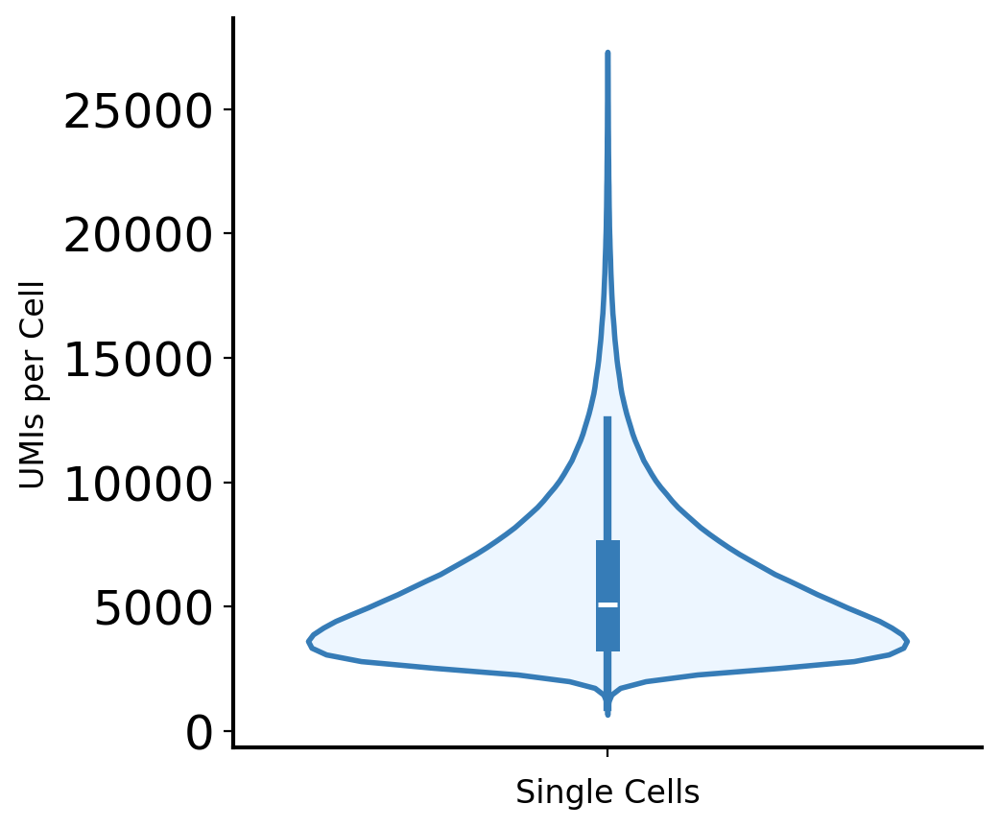

In [13]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_umis_per_cell(adata, umi_key='n_UMI_counts'):
    # Extract UMIs per cell
    umis_per_cell = adata.obs[umi_key]
    
    # Create the plot
    fig, ax = plt.subplots(figsize=(5, 5))
    
    # Plot the violin 
    sns.violinplot(data=umis_per_cell, ax=ax, inner='box', color='#EDF6FF', linewidth=2, linecolor="#367CB7", saturation=1)

    # Set x and y labels
    ax.set_xlabel('Single Cells', fontsize=12)
    ax.set_ylabel('UMIs per Cell', fontsize=12)
    
    # Style the axes
    ax.set_facecolor('white')
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_linewidth(1.5)
    ax.spines['left'].set_linewidth(1.5)
    ax.tick_params(axis='both', which='major', labelsize=18)
    
    # Remove the grid
    ax.grid(False)
    
    plt.show()
    return fig

# Example usage:
f = plot_umis_per_cell(adata)
f.savefig("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/output_files/UMIs_per_cell.svg", pad_inches=.1)

#### Assigning Metadata

In [4]:
def assign_gene_ids(adata, gene_id_filepath, ntc_label="NTC"):
    def gene_ids_to_ensg(filepath):
        ensembl_ids = {}
        with open(filepath, 'r') as file:
            for line in file:
                gene, ensg = line.strip().split('\t')
                ensembl_ids[gene] = ensg
        return ensembl_ids
    gene_to_ensembl_ids = gene_ids_to_ensg(filepath=gene_id_filepath)
    gene_to_ensembl_ids[ntc_label] = ntc_label #incase NTC was not included in the file path
    ensembl_ids_to_gene = {v: k for k, v in gene_to_ensembl_ids.items()}
    adata.obs["gene_target_ensembl_id"] = [gene_to_ensembl_ids[gene] for gene in adata.obs["gene_target"]]

import numpy as np

def remove_invalid_gene_targets_in_place(adata, obs_key, var_key, whitelist=["NTC"]):
    """
    Removes cells in place from the anndata object where the gene_target_ensembl_id in obs is not present in the var,
    except for those in a provided whitelist.
    
    Parameters:
    - adata: AnnData object (modified in place)
    - obs_key: The key in .obs corresponding to gene_target_ensembl_id
    - var_key: The key in .var corresponding to gene_ids
    - whitelist: A list or set of gene targets that are allowed even if they are not in var (default is None)
    """
    # Ensure obs_key exists in .obs and var_key exists in .var
    if obs_key not in adata.obs.columns:
        raise ValueError(f"{obs_key} not found in .obs.")
    if var_key not in adata.var.columns:
        raise ValueError(f"{var_key} not found in .var.")
    
    # Create a set of valid gene IDs from .var
    valid_gene_ids = set(adata.var[var_key].values)
    
    # If a whitelist is provided, add it to the valid_gene_ids set
    if whitelist is not None:
        if isinstance(whitelist, (list, set)):
            valid_gene_ids.update(whitelist)
        else:
            raise ValueError("Whitelist must be a list or set of gene targets.")
    
    # Identify invalid gene targets that are not in the valid_gene_ids set
    invalid_mask = ~adata.obs[obs_key].isin(valid_gene_ids)
    invalid_genes = adata.obs.loc[invalid_mask, obs_key].unique()
    
    # Print a warning if there are any invalid gene targets
    if len(invalid_genes) > 0:
        print(f"Warning: The following gene targets were not found in var[{var_key}] and are not in the whitelist. They will be dropped:")
        for gene in invalid_genes:
            print(f"  - {gene}")
    
    # Drop cells with invalid gene targets in place
    adata=adata[~invalid_mask]
    return adata


assign_gene_ids(adata,"/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/input_files/gene_ids.txt")
adata = remove_invalid_gene_targets_in_place(adata,obs_key="gene_target_ensembl_id",var_key="gene_ids")


  - ENSG00000234414
  - ENSG00000251380
  - ENSG00000182415
  - ENSG00000172288
  - ENSG00000262664
  - ENSG00000129864
  - ENSG00000268994
  - ENSG00000286190
  - ENSG00000253797


In [5]:
adata_alpha = adata[adata.obs.run=="ALPHA"]
adata_beta = adata[adata.obs.run=="BETA"]
adata_gamma = adata[adata.obs.run=="GAMMA"]
adata_alpha = adata_alpha.copy()
adata_beta = adata_beta.copy()
adata_gamma = adata_gamma.copy()
adata_alpha.write("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_ALPHA.h5ad")
adata_beta.write("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_BETA.h5ad")
adata_gamma.write("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_GAMMA.h5ad")

###

### Assigning Per Cell Gene Target Knockdown

In [33]:
import anndata as ad
adata_alpha = ad.read_h5ad("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_ALPHA.h5ad")
adata_beta = ad.read_h5ad("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_BETA.h5ad")
adata_gamma = ad.read_h5ad("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_GAMMA.h5ad")

In [34]:
import scanpy as sc
import numpy as np

def evaluate_per_sgRNA_knockdown(adata, label_interval=100, repression_threshold=30, cells_per_gRNA_threshold=25):
    """
    Evaluates the median knockdown efficiency per sgRNA, plots the results, and prints the
    number of sgRNAs (excluding "NTC") with more than 30% knockdown.
    
    Parameters:
    - adata: AnnData object containing the data. The .obs attribute should contain a "gRNA" column
            and a "target_knockdown" column.
    - label_interval: Interval for displaying x-axis labels. Default is every 10th label.
    
    Returns:
    - A pandas Series containing the median knockdown values for each sgRNA.
    """
    # Ensure the necessary columns exist in .obs
    if "gRNA" not in adata.obs.columns:
        raise ValueError("'gRNA' column not found in .obs.")
    if "target_knockdown" not in adata.obs.columns:
        raise ValueError("'target_knockdown' column not found in .obs.")
    
    # Group by the gRNA column and compute the median knockdown for each group
    median_knockdown_per_gRNA = 100 * adata.obs.groupby("gRNA")["target_knockdown"].mean()

    # Filter out gRNAs that contain "NTC" in their name
    non_ntc_sgRNAs = median_knockdown_per_gRNA[~median_knockdown_per_gRNA.index.str.contains("NTC")]

    # Count the number of sgRNAs with more than 30% knockdown
    count_above_thresh = (non_ntc_sgRNAs > repression_threshold).sum()
    total_non_ntc = len(non_ntc_sgRNAs)

    print(f"{count_above_thresh} out of {total_non_ntc} ({100*count_above_thresh/total_non_ntc:.2f}%) non-NTC sgRNAs have more than {repression_threshold}% knockdown.")

    def plot_sorted_dict(data_dict, ylabel="Mean Knockdown per Cell (%)", label_interval=label_interval, invert_y=False, axvline=0, axhline=0):
        # Sort the dictionary by value in descending order
        sorted_items = sorted(data_dict.items(), key=lambda item: item[1], reverse=True)
        
        # Separate keys and values
        keys = [item[0] for item in sorted_items]
        values = [item[1] if item[1] > -100 else -100 for item in sorted_items]
        
        # Create the plot
        plt.figure(figsize=(20, 8))
        plt.bar(keys, values, color='skyblue')
        plt.axhline(0,color="black",ls=':')
        plt.axhline(axhline,color="skyblue",ls=':')
        plt.axvline(axvline,color="skyblue",ls=":")
        plt.ylabel(ylabel)
        
        # Rotate x-axis labels
        plt.xticks(rotation=45, ha="right", fontsize=10)
        plt.yticks(fontsize=12)
        
        # Invert the y-axis
        if invert_y:
            plt.gca().invert_yaxis()
        
        # Turn off vertical grid lines and improve horizontal grid lines
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        plt.grid(axis='x', linestyle='', which='both')  # Disable vertical grid lines
        
        # Set x-tick labels to display every nth label
        plt.xticks(ticks=range(0, len(keys), label_interval), labels=[keys[i] for i in range(0, len(keys), label_interval)])
        
        # Show the plot with tight layout
        plt.tight_layout()
        
        plt.show()
    
    plot_sorted_dict(median_knockdown_per_gRNA,invert_y=True,axvline=count_above_thresh,axhline=repression_threshold)
    invalid_sgRNA = [gRNA for gRNA in dict(median_knockdown_per_gRNA) if ("Non-Targeting" not in gRNA and median_knockdown_per_gRNA[gRNA] <= repression_threshold)]
    print(f"Removing {len(invalid_sgRNA)} perturbing sgRNA for not having more than {repression_threshold}% knockdown")
    mask = adata.obs.gRNA.isin(invalid_sgRNA)
    print(f"Before filter: {len(adata.obs.gRNA.unique())},{adata.obs.perturbed.value_counts()}")
    adata = adata[~mask]
    print(f"After filter: {len(adata.obs.gRNA.unique())},{adata.obs.perturbed.value_counts()}")
    #Removing any cell that is not atleast repressed
    invalid_cells = (adata.obs["target_knockdown"] < 0) & (adata.obs.perturbed == "True")
    print(f"Removing {sum(invalid_cells)} perturbed cells for not having any measureable repression.")
    print(f"Before filter: {len(adata.obs.gRNA.unique())},{adata.obs.perturbed.value_counts()}")
    adata = adata[~invalid_cells]
    print(f"After filter: {len(adata.obs.gRNA.unique())},{adata.obs.perturbed.value_counts()}")
    adata_perturbed = adata[adata.obs.perturbed=="True"]
    cells_per_guide = dict(adata_perturbed.obs.gRNA.value_counts())
    plot_sorted_dict(cells_per_guide,ylabel="Number of Cells per gRNA",label_interval=len(cells_per_guide)%10,axhline=cells_per_gRNA_threshold)
    invalid_sgRNA = [gRNA for gRNA in cells_per_guide if cells_per_guide[gRNA] <= cells_per_gRNA_threshold]
    print(f"Before filter: {len(adata.obs.gRNA.unique())},{adata.obs.perturbed.value_counts()}")
    print(f"Removing {len(invalid_sgRNA)} perturbing sgRNA for not having more than {cells_per_gRNA_threshold} cells")
    adata=adata[~adata.obs.gRNA.isin(invalid_sgRNA)]
    print(f"After filter: {len(adata.obs.gRNA.unique())},{adata.obs.perturbed.value_counts()}")
    return adata



def knockdown_qc(adata, obs_key, var_key, 
                                   gene_target_expr_col="gene_target_expression (CPM)", 
                                   ntc_target_expr_col="NTC_target_gene_expression (CPM)", 
                                   knockdown_col="target_knockdown",
                                   zscore_col="target_knockdown_z_score",
                                   ntc_label="NTC", 
                                   layer="counts",
                                   normalized_layer="normalized_counts"):
    """
    Assigns gene target expression values, NTC mean expression values, calculates knockdown efficiency,
    and computes the z-score for knockdown efficiency to specified columns in .obs.
    
    If the gene_target_ensembl_id is not found in var, assigns a value of zero.
    The knockdown efficiency is calculated as gene_target_expression / NTC_target_gene_expression.
    The z-score is calculated using the mean and variance of NTCs.
    Any division by zero is handled by setting the knockdown efficiency to 1.0.
    
    Parameters:
    - adata: AnnData object
    - obs_key: The key in .obs corresponding to gene_target_ensembl_id
    - var_key: The key in .var corresponding to gene_ids
    - gene_target_expr_col: The name of the new column in .obs for storing the gene target expression values
    - ntc_target_expr_col: The name of the new column in .obs for storing the mean NTC expression values
    - knockdown_col: The name of the new column in .obs for storing the knockdown efficiency values
    - zscore_col: The name of the new column in .obs for storing the z-score of knockdown efficiency
    - ntc_label: The label for non-targeting control (NTC), for which expression is set to zero
    - layer: The layer of the AnnData object to use for the calculations. Defaults to "counts".
    - normalized_layer: The layer of the AnnData object to store the normalized counts.
    
    Returns:
    - The modified AnnData object with the new gene target expression, NTC mean expression, knockdown efficiency, and z-score columns added to .obs.
    """
    # Ensure obs_key exists in .obs and var_key exists in .var
    if obs_key not in adata.obs.columns:
        raise ValueError(f"{obs_key} not found in .obs.")
    if var_key not in adata.var.columns:
        raise ValueError(f"{var_key} not found in .var.")
    
    # Copy the original counts to a new layer for normalization
    adata.layers[normalized_layer] = adata.layers[layer].copy()

    # Normalize counts per cell using Scanpy (this normalizes the new layer)
    sc.pp.normalize_total(adata, target_sum=1e6, layer=normalized_layer)

    # Choose the data matrix from the normalized layer
    data = adata.layers[normalized_layer]

    # Create a dictionary to map gene IDs to their indices in .var
    var_dict = {gene: idx for idx, gene in enumerate(adata.var[var_key].values)}
    
    # Map gene_target_ensembl_id in .obs to indices in .var
    var_indices = adata.obs[obs_key].map(var_dict).fillna(-1).astype(int).values
    
    # Initialize gene_target_expression and ntc_target_expression arrays with zeros
    gene_target_expression = np.zeros(adata.n_obs)
    ntc_target_expression = np.zeros(adata.n_obs)
    
    # Handle case where there might be NTC cells
    is_ntc = (adata.obs[obs_key] == ntc_label).values  # Convert to boolean array
    if np.any(is_ntc):
        ntc_data = data[is_ntc]
        ntc_mean_expression = np.array(ntc_data.mean(axis=0)).flatten()
        ntc_square_mean = np.array(ntc_data.multiply(ntc_data).mean(axis=0)).flatten()
        ntc_variance_expression = ntc_square_mean - np.square(ntc_mean_expression)
    else:
        ntc_mean_expression = np.zeros(adata.shape[1])
        ntc_variance_expression = np.ones(adata.shape[1])  # Set to 1 to avoid division by zero in z-score
    
    # Filter out invalid indices (-1) and assign expression values
    valid_mask = var_indices >= 0
    gene_target_expression[valid_mask] = np.array(data[np.arange(adata.n_obs)[valid_mask], var_indices[valid_mask]]).flatten()
    ntc_target_expression[valid_mask] = ntc_mean_expression[var_indices[valid_mask]]
    
    # Calculate the knockdown efficiency
    with np.errstate(divide='ignore', invalid='ignore'):
        knockdown_efficiency = 1-np.divide(gene_target_expression, ntc_target_expression, out=np.ones_like(gene_target_expression), where=ntc_target_expression != 0)
    
    # Initialize the z-score array
    knockdown_zscore = np.zeros(adata.n_obs)

    # Perform the subtraction and z-score calculation with a check for zero variance
    with np.errstate(divide='ignore', invalid='ignore'):
        # Compute the difference between gene target expression and NTC expression
        expression_difference = gene_target_expression[valid_mask] - ntc_target_expression[var_indices[valid_mask]]
        
        # Compute the z-score where the variance is not zero
        variance_mask = ntc_variance_expression[var_indices[valid_mask]] != 0
        knockdown_zscore[valid_mask] = np.where(
            variance_mask,
            expression_difference / np.sqrt(ntc_variance_expression[var_indices[valid_mask]]),
            0
        )

    # Add the gene target expression, NTC mean expression, knockdown efficiency, and z-score columns to .obs
    adata.obs[gene_target_expr_col] = gene_target_expression
    adata.obs[ntc_target_expr_col] = ntc_target_expression
    adata.obs[knockdown_col] = knockdown_efficiency
    adata.obs[zscore_col] = knockdown_zscore

    # Evaluate the knockdown per sgRNA and Cell
    return evaluate_per_sgRNA_knockdown(adata, label_interval=100)

normalizing counts per cell
    finished (0:00:17)
8190 out of 11304 (72.45%) non-NTC sgRNAs have more than 30% knockdown.


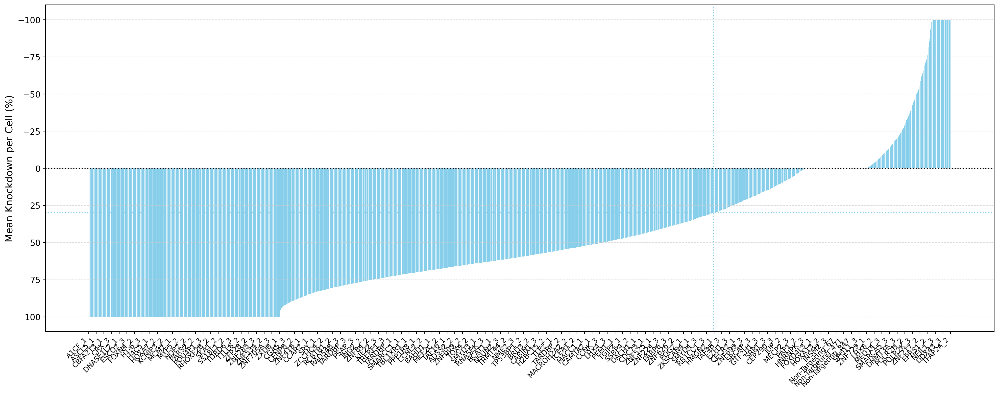

Removing 2878 perturbing sgRNA for not having more than 30% knockdown
Before filter: 11307,perturbed
True     887720
False     14146
Name: count, dtype: int64
After filter: 8429,perturbed
True     663039
False     14146
Name: count, dtype: int64
Removing 41471 perturbed cells for not having any measureable repression.
Before filter: 8429,perturbed
True     663039
False     14146
Name: count, dtype: int64
After filter: 8429,perturbed
True     621568
False     14146
Name: count, dtype: int64


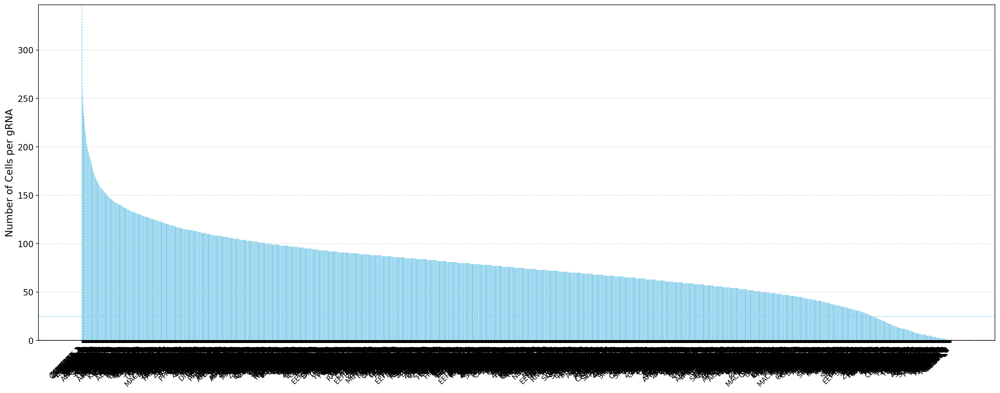

Before filter: 8429,perturbed
True     621568
False     14146
Name: count, dtype: int64
Removing 753 perturbing sgRNA for not having more than 25 cells
After filter: 7676,perturbed
True     613518
False     14146
Name: count, dtype: int64
normalizing counts per cell
    finished (0:00:35)
9805 out of 12155 (80.67%) non-NTC sgRNAs have more than 30% knockdown.


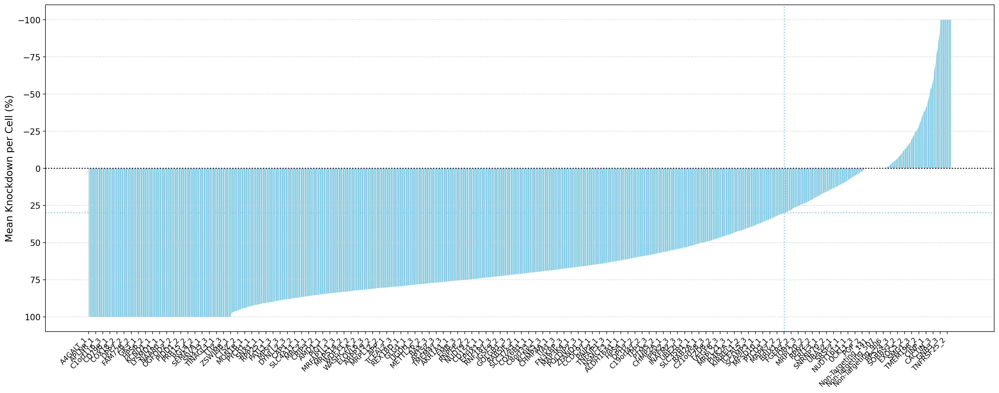

Removing 2114 perturbing sgRNA for not having more than 30% knockdown
Before filter: 12155,perturbed
True     948581
False     13603
Name: count, dtype: int64
After filter: 10041,perturbed
True     807578
False     13603
Name: count, dtype: int64
Removing 44898 perturbed cells for not having any measureable repression.
Before filter: 10041,perturbed
True     807578
False     13603
Name: count, dtype: int64
After filter: 10041,perturbed
True     762680
False     13603
Name: count, dtype: int64


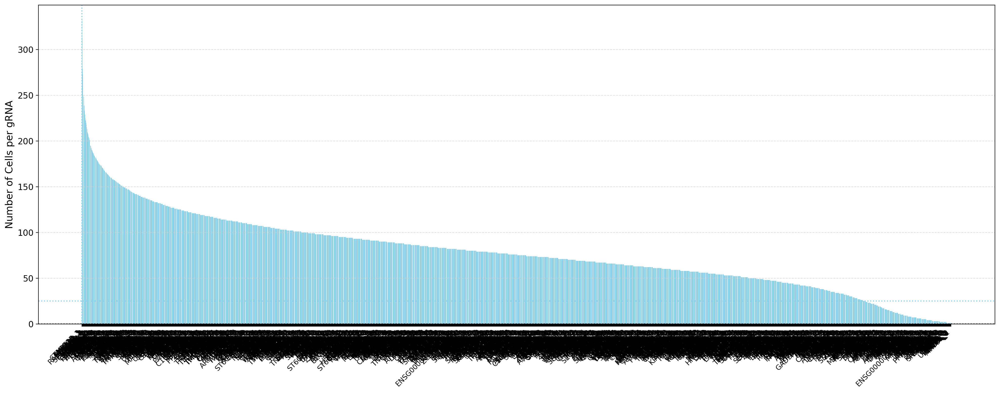

Before filter: 10041,perturbed
True     762680
False     13603
Name: count, dtype: int64
Removing 997 perturbing sgRNA for not having more than 25 cells
After filter: 9044,perturbed
True     752295
False     13603
Name: count, dtype: int64
normalizing counts per cell
    finished (0:00:10)
9888 out of 12002 (82.39%) non-NTC sgRNAs have more than 30% knockdown.


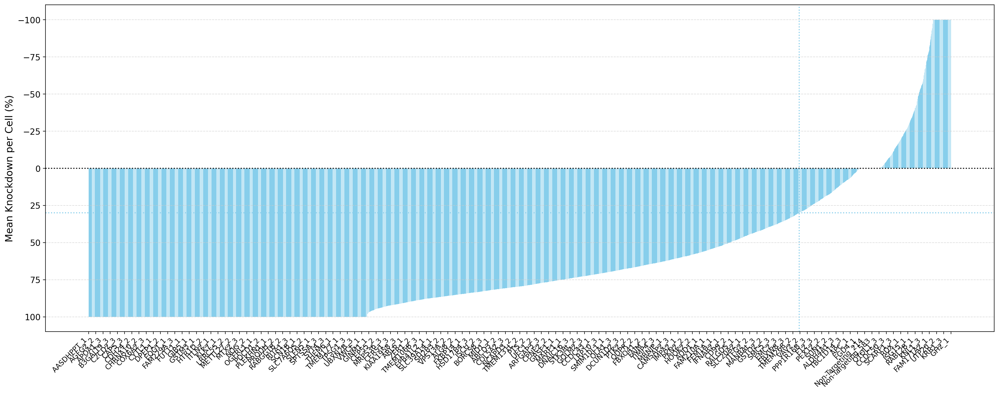

Removing 1879 perturbing sgRNA for not having more than 30% knockdown
Before filter: 12002,perturbed
True     678499
False      9684
Name: count, dtype: int64
After filter: 10123,perturbed
True     575427
False      9684
Name: count, dtype: int64
Removing 24950 perturbed cells for not having any measureable repression.
Before filter: 10123,perturbed
True     575427
False      9684
Name: count, dtype: int64
After filter: 10123,perturbed
True     550477
False      9684
Name: count, dtype: int64


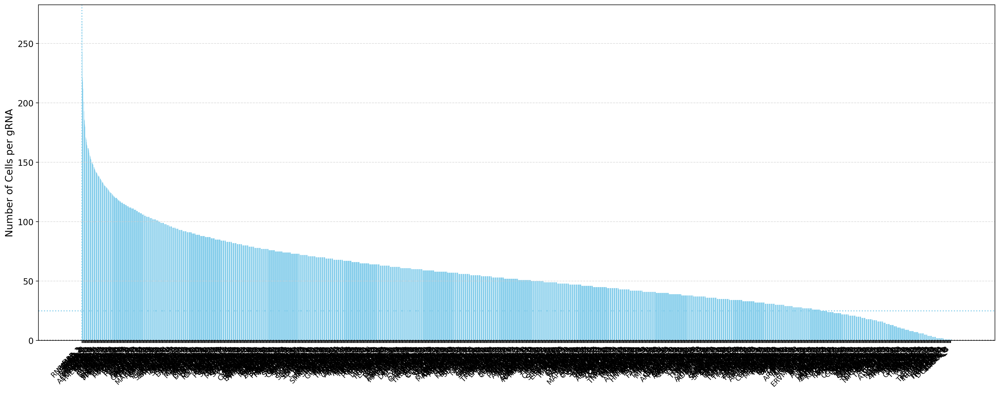

Before filter: 10123,perturbed
True     550477
False      9684
Name: count, dtype: int64
Removing 1494 perturbing sgRNA for not having more than 25 cells
After filter: 8629,perturbed
True     530130
False      9684
Name: count, dtype: int64


In [35]:
knockdown_adata_alpha=knockdown_qc(adata_alpha, 'gene_target_ensembl_id', 'gene_ids').copy()
knockdown_adata_beta=knockdown_qc(adata_beta, 'gene_target_ensembl_id', 'gene_ids').copy()
knockdown_adata_gamma=knockdown_qc(adata_gamma, 'gene_target_ensembl_id', 'gene_ids').copy()


In [38]:
import numpy as np
alpha_knockdown = list(_get_perturbed_view(adata_alpha).obs.groupby("gene_target")["target_knockdown"].mean())
beta_knockdown = list(_get_perturbed_view(adata_beta).obs.groupby("gene_target")["target_knockdown"].mean())
gamma_knockdown = list(_get_perturbed_view(adata_gamma).obs.groupby("gene_target")["target_knockdown"].mean())
total_knockdown = np.sort(np.clip(np.array(alpha_knockdown + beta_knockdown + gamma_knockdown),a_min=0,a_max=1))[::-1]

9531/11739 (0.8119090212113468) Perturbations achieve > 30% Knockdown


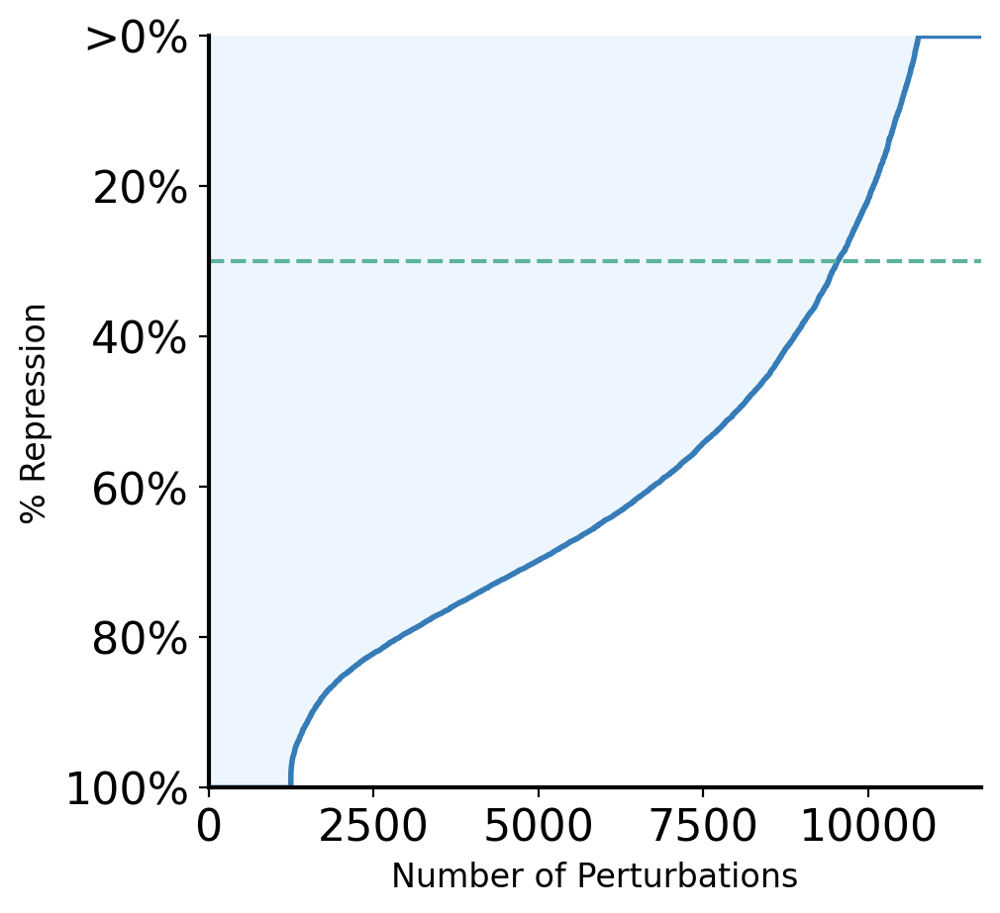

In [50]:
import matplotlib.pyplot as plt
import numpy as np


def plot_percentage_perturbations_by_repression(total_knockdown):

    # Sort the knockdown values in ascending order (to have % repression on y-axis)
    sorted_knockdown = np.sort(total_knockdown)[::-1]

    # Create the plot
    fig, ax = plt.subplots(figsize=(5, 5))
    ax.fill_between(range(1, len(sorted_knockdown) + 1), 0, sorted_knockdown * 100, color='#EDF6FF')
    ax.plot(range(1, len(sorted_knockdown) + 1), sorted_knockdown * 100, color='#367CB7', linewidth=2)

    # Set x and y labels
    ax.set_xlabel('Number of Perturbations', fontsize=12)
    ax.set_ylabel('% Repression', fontsize=12)

    # Style the axes
    ax.set_facecolor('white')
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_linewidth(1.5)
    ax.spines['left'].set_linewidth(1.5)

    # Adjust y-axis limit and ticks, and invert the axis
    ax.set_ylim(0, 100)
    y_ticks = list(range(0, 101, 20))
    y_labels = [str(y) + '%' if y != 0 else '>0%' for y in y_ticks]
    ax.set_yticks(y_ticks)
    ax.set_yticklabels(y_labels)
    ax.invert_yaxis()

    # Draw a horizontal line at 30% repression
    ax.axhline(y=30, color='#5CB39D', linestyle='--', linewidth=1.5)
    
    # Find the x position where the repression is 30% and draw a vertical line
    x_at_30 = np.sum(sorted_knockdown >= .30)
    print(f"{x_at_30}/{11739} ({x_at_30/11739}) Perturbations achieve > 30% Knockdown")

    # Adjust x-axis limits
    ax.set_xlim(left=0, right=len(sorted_knockdown) + 1)
    
    ax.tick_params(axis='both', which='major', labelsize=16)

    # Remove the grid
    ax.grid(False)

    plt.show()
    return fig

# Example usage:
# total_knockdown = [your data here]
f = plot_percentage_perturbations_by_repression(total_knockdown)
f.savefig("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/output_files/repression_per_perturbation.svg", pad_inches=.1)


In [12]:
sum(total_knockdown > 0.3)/11739

0.8119090212113468

### Assesing gRNA which induce a Transcriptional Phenotype via Energy Distance

In [124]:
median_NTC = np.median(list(_get_ntc_view(knockdown_adata_alpha).obs.n_UMI_counts) + list(_get_ntc_view(knockdown_adata_beta).obs.n_UMI_counts) + list(_get_ntc_view(knockdown_adata_gamma).obs.n_UMI_counts))
sc.pp.normalize_total(knockdown_adata_alpha,target_sum=median_NTC)
sc.pp.normalize_total(knockdown_adata_beta,target_sum=median_NTC)
sc.pp.normalize_total(knockdown_adata_gamma,target_sum=median_NTC)
sc.pp.log1p(knockdown_adata_alpha)
sc.pp.log1p(knockdown_adata_beta)
sc.pp.log1p(knockdown_adata_gamma)
sc.pp.scale(knockdown_adata_alpha)
sc.pp.scale(knockdown_adata_beta)
sc.pp.scale(knockdown_adata_gamma)

normalizing counts per cell
    finished (0:00:10)
normalizing counts per cell
    finished (0:00:16)
normalizing counts per cell
    finished (0:00:08)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [125]:
import numpy as np
import anndata as ad
import pandas as pd
import dcor
from scipy.stats import gamma

def subsample_anndata(adata, category, n_min, ref_size = 3000, control_string=None):
    """
    Subsample an anndata object down to n_min samples per category. For any control group that contains
    the control_string in its name, subsample n_min samples and label them as "reference", while labeling
    the rest as "NTC". Handle non-control groups by subsampling n_min samples.

    Parameters:
    adata (anndata.AnnData): The input anndata object.
    category (str): The category to subsample.
    n_min (int): The minimum number of samples to retain in each category.
    control_string (str): The substring to identify control groups.

    Returns:
    anndata.AnnData: A view of the subsampled anndata object.
    """
    # Check if the category exists in the observations
    if category not in adata.obs:
        raise ValueError(f"Category '{category}' not found in adata.obs")
    
    # Initialize a list to store the indices of samples to keep
    keep_indices = []
    adata.obs["ed_category"] = "None"
    
    # First, handle control groups
    control_mask = adata.obs[category].str.contains(control_string)
    control_indices = adata.obs.index[control_mask].tolist()

    if len(control_indices) < ref_size:
        raise ValueError(f"Control group(s) with '{control_string}' has fewer samples ({len(control_indices)}) than ref_size ({ref_size}).")
    
    # Randomly sample n_min control samples and label them as "reference"
    sampled_indices = np.random.choice(control_indices, ref_size, replace=False).tolist()
    adata.obs.loc[sampled_indices,"ed_category"] = "reference"
    keep_indices.extend(sampled_indices)
    
    # Label the rest as "NTC"
    remaining_indices = np.setdiff1d(control_indices, sampled_indices).tolist()
    adata.obs.loc[remaining_indices,"ed_category"] = "NTC"
    keep_indices.extend(remaining_indices)

    # Then, handle non-control groups
    for group, indices in adata.obs.groupby(category).groups.items():
        if control_string not in group:
            if len(indices) >= n_min:
                selected_indices = np.random.choice(indices, n_min, replace=False).tolist()
                adata.obs.loc[selected_indices,"ed_category"] = group
                keep_indices.extend(selected_indices)
    
    # Return a view of the anndata object with only the selected samples
    return adata[keep_indices].copy()

def preprocess_for_ed(adata_subsampled):
    n_var_max = 2000  # max total features to select
    adata_class_balance = adata_subsampled[adata_subsampled.obs.ed_category != "NTC"].copy()
    sc.pp.highly_variable_genes(adata_class_balance, n_top_genes=n_var_max, subset=False, flavor='seurat_v3', layer='counts')
    adata_subsampled.var["highly_variable"] = adata_class_balance.var["highly_variable"].copy()
    del adata_class_balance
    sc.pp.pca(adata_subsampled, use_highly_variable=True)
    sc.pp.neighbors(adata_subsampled)

import numpy as np
import anndata as ad
from joblib import Parallel, delayed
from tqdm import tqdm
from tqdm_joblib import tqdm_joblib
import os
import dcor

os.environ["OMP_NUM_THREADS"] = "1"
os.environ["OMP_MAX_ACTIVE_LEVELS"] = "1"
os.environ["KMP_WARNINGS"] = "0"  # For Intel's OpenMP implementation


def compute_energy_distance(adata, category="ed_category", reference_name="reference", control_name="NTC", n_replicates=10000, ref_sample_size=20, use_rep="X_pca", n_jobs=-1):
    """
    Compute energy distance between reference samples and control samples in an anndata object.

    Parameters:
    - adata (anndata.AnnData): The input anndata object.
    - category (str): The category to compare (e.g., 'gene_target').
    - reference_name (str): The name of the reference group.
    - control_name (str): The name of the control group.
    - n_replicates (int): The number of random replicates for computing the null distribution.
    - use_rep (str or None): The representation to use from adata.obsm (e.g., 'X_pca'). If None, use adata.X.
    - n_jobs (int): The number of jobs to run in parallel. Default is -1 (use all available cores).

    Returns:
    - dict: A dictionary containing the energy distance scores for both the null distribution
      and each non-reference group.
    """
    # Determine the data representation to use
    if use_rep is None:
        data = adata.X
    else:
        if use_rep in adata.obsm:
            data = adata.obsm[use_rep]
        else:
            raise ValueError(f"Representation '{use_rep}' not found in adata.obsm")
    
    # Convert data to dense if it is sparse
    if hasattr(data, "toarray"):
        data = data.toarray()
    
    # Extract the reference and control data
    reference_data = data[adata.obs[category] == reference_name]
    control_data = data[adata.obs[category] == control_name]
    
    # Define the function to compute the energy distance for a random sample
    def compute_random_energy_distance():
        random_sample = control_data[np.random.choice(control_data.shape[0], ref_sample_size, replace=False), :]
        return dcor.energy_distance(random_sample, reference_data)
    
    # Compute the null distribution using parallel processing
    with tqdm_joblib(desc="Computing null distribution", total=n_replicates):
        null_distances = Parallel(n_jobs=n_jobs)(delayed(compute_random_energy_distance)() for _ in range(n_replicates))
    
    # Define the function to compute the energy distance for each non-reference group
    def compute_group_energy_distance(group_indices):
        group_data = data[group_indices]
        return dcor.energy_distance(group_data, reference_data)
    
    # Prepare non-reference groups using cell barcodes
    non_reference_groups = {group: adata.obs[category] == group for group in adata.obs[category].unique() if group != reference_name}
    
    
    with tqdm_joblib(desc="Computing group distances", total=len(non_reference_groups)):
        group_distances = Parallel(n_jobs=n_jobs)(
            delayed(compute_group_energy_distance)(np.array(indices))
            for group, indices in non_reference_groups.items()
        )
    
    # # Combine the null distribution and group distances into the results dictionary
    results = {group: dist for group, dist in zip(non_reference_groups.keys(), group_distances)}

    def remove_non_perturbing_sgRNA(null, data, threshold=0.75):
        # Fit a gamma distribution to the control data
        alpha_mle, loc_mle, beta_mle = gamma.fit(null,loc=0.3)

        #Get perturbed cell distribution
        perturbed_gRNA_edist = np.array(list(data.values()))
        perturbed_gRNA = np.array(list(data.keys()))

        # Plot the histogram of the data and the fitted gamma distribution
        x = np.linspace(np.min(null), np.max(null), 1000)
        pdf_fitted = gamma.pdf(x, alpha_mle, loc=loc_mle, scale=beta_mle)
        thresh_val = gamma.ppf(threshold, alpha_mle, loc=loc_mle, scale=beta_mle)

        plt.figure(figsize=(10, 6))
        plt.hist(null, bins=300, density=True, alpha=0.6, color='b', label="Control sgRNA")
        plt.hist(np.clip(perturbed_gRNA_edist,0,max(null)*3), bins=300, density=True, alpha=0.6, color='g', label="Perturbing sgRNA")
        plt.plot(x, pdf_fitted, 'r-', lw=2, label="Fitted Gamma Distribution")
        plt.axvline(x=thresh_val, color='r', linestyle='--', label=f"{threshold*100}% Probabilty of not being in Control")
        plt.xlabel("Energy Distance")
        plt.ylabel("Density (%)")
        plt.legend()
        plt.show()
        print(f"{sum(perturbed_gRNA_edist > thresh_val)}/{len(perturbed_gRNA_edist)} Perturbing sgRNA cross threshold of {threshold}")
        valid_gRNA = perturbed_gRNA[perturbed_gRNA_edist > thresh_val]
        return valid_gRNA
    valid_gRNA = remove_non_perturbing_sgRNA(null_distances, results)
    return valid_gRNA, null_distances, results

def filter_sgRNA(adata):
    subsampled_adata = subsample_anndata(adata, category="gRNA", n_min=20, control_string="Non-Targeting")
    preprocess_for_ed(subsampled_adata)
    valid_sgRNA, null_distances, results = compute_energy_distance(subsampled_adata,ref_sample_size=20)
    valid_mask = adata.obs.gRNA.isin(valid_sgRNA) | (adata.obs.perturbed == "False")
    adata=adata[valid_mask]
    return adata, null_distances, results



extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)
computing PCA
    with n_comps=50
    finished (0:00:51)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)
computing neighbors
    computing neighbors
    using 'X_pca' with n_pcs = 50
    computed neighbors (0:00:36)
    computed connectivities (0:00:00)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:37)


Computing null distribution:   0%|          | 0/10000 [00:00<?, ?it/s]

Computing group distances:   0%|          | 0/7441 [00:00<?, ?it/s]

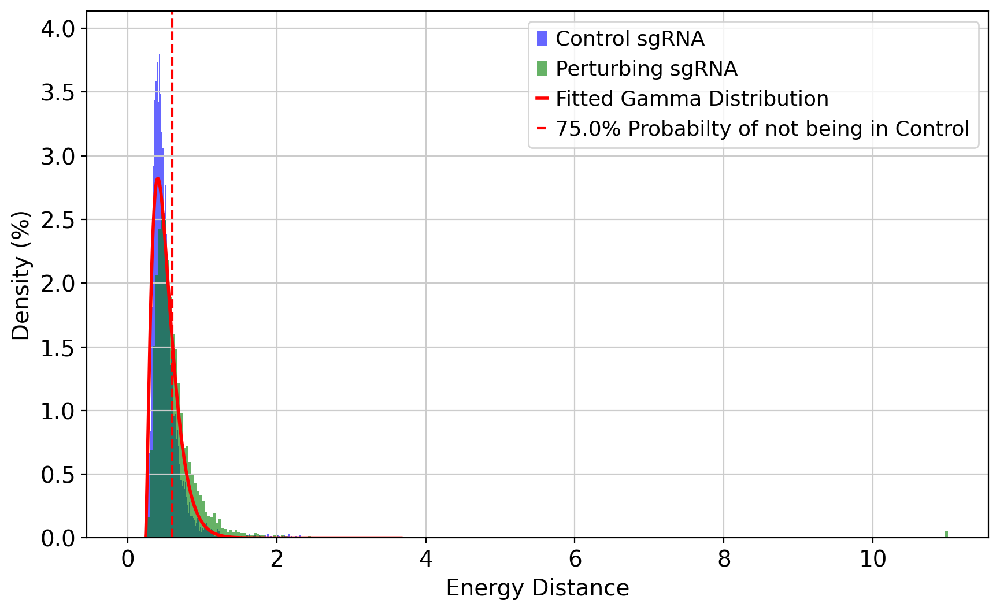

2910/7441 Perturbing sgRNA cross threshold of 0.75
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)
computing PCA
    with n_comps=50
    finished (0:00:54)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)
computing neighbors
    computing neighbors
    using 'X_pca' with n_pcs = 50
    computed neighbors (0:00:27)
    computed connectivities (0:00:00)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:28)


Computing null distribution:   0%|          | 0/10000 [00:00<?, ?it/s]

Computing group distances:   0%|          | 0/8809 [00:00<?, ?it/s]

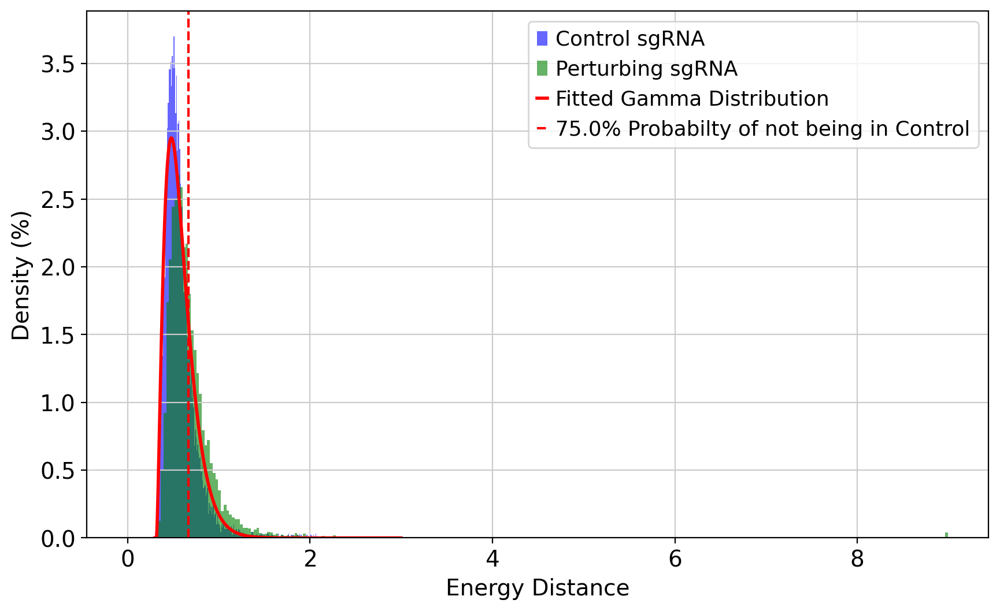

3517/8809 Perturbing sgRNA cross threshold of 0.75
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)
computing PCA
    with n_comps=50
    finished (0:00:36)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)
computing neighbors
    computing neighbors
    using 'X_pca' with n_pcs = 50
    computed neighbors (0:00:23)
    computed connectivities (0:00:00)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:23)


Computing null distribution:   0%|          | 0/10000 [00:00<?, ?it/s]

Computing group distances:   0%|          | 0/8395 [00:00<?, ?it/s]

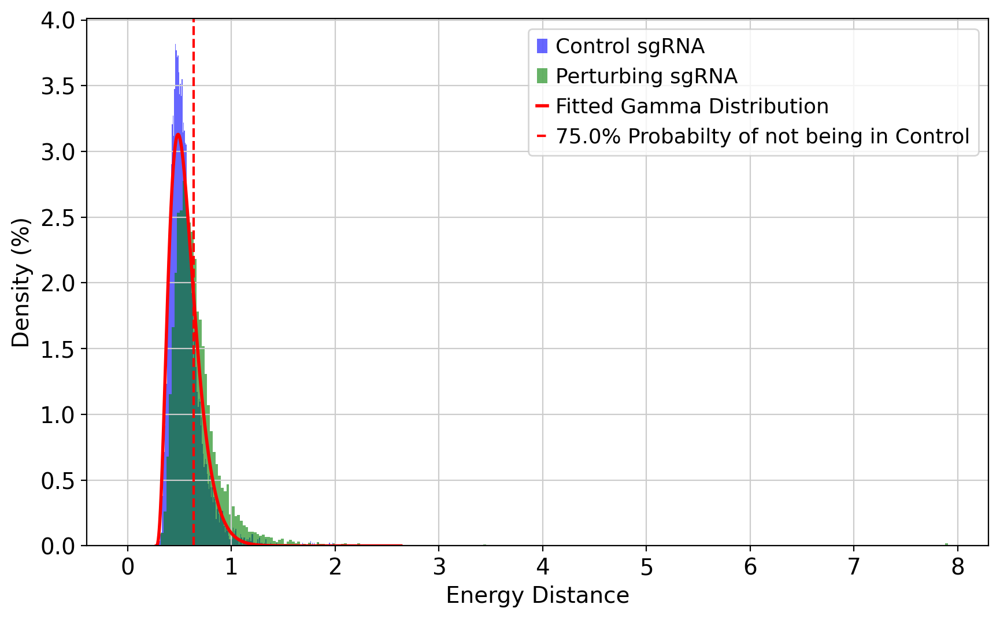

3603/8395 Perturbing sgRNA cross threshold of 0.75


In [126]:
alpha_filtered, alpha_null_distances, alpha_results = filter_sgRNA(knockdown_adata_alpha)
beta_filtered, beta_null_distances, beta_results = filter_sgRNA(knockdown_adata_beta)
gamma_filtered, gamma_null_distances, gamma_results = filter_sgRNA(knockdown_adata_gamma)

In [130]:
alpha_filtered = alpha_filtered.copy()
beta_filtered = beta_filtered.copy()
gamma_filtered = gamma_filtered.copy()

In [131]:
alpha_filtered.write("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_ALPHA_sgRNA_Filtered.h5ad")
beta_filtered.write("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_BETA_sgRNA_Filtered.h5ad")
gamma_filtered.write("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_GAMMA_sgRNA_Filtered.h5ad")

In [178]:
total_null_distances = alpha_null_distances + beta_null_distances + gamma_null_distances
percentile_75 = np.percentile(total_null_distances, 75)
np.log10(percentile_75)

-0.214984481030074

In [24]:
total_energy_distances = alpha_results | beta_results | gamma_results
total_null_distances = alpha_null_distances + beta_null_distances + gamma_null_distances
percentile_75 = np.percentile(total_null_distances, 75)
import matplotlib.pyplot as plt
import numpy as np
def plot_energy_distance_dotplot(total_energy_distances, percentile_75_ntc):
    """
    Plots a dot plot of energy distances, labeling the top 20 results with arrows for readability.
    Shades a rectangle at the 75th percentile.

    Parameters:
    - total_energy_distances: dict, a dictionary where keys are perturbations and values are energy distances.
    - percentile_75_ntc: float, the 75th percentile value to shade.
    """
    # Sort the dictionary by energy distances in descending order
    sorted_energy_distances = dict(sorted(total_energy_distances.items(), key=lambda item: item[1], reverse=True))
    
    # Remove the "NTC" key
    if "NTC" in sorted_energy_distances:
        del sorted_energy_distances["NTC"]

    # Get the top 20 perturbations
    top_20 = list(sorted_energy_distances.keys())[:20]  # Use the top 20 from the sorted list

    # Plotting
    fig, ax = plt.subplots(figsize=(6, 6))
    x_values = range(len(sorted_energy_distances))
    y_values = np.log10(list(sorted_energy_distances.values()))

    # Add a rectangle at the 75th percentile
    ax.axhspan(ymin=min(y_values), ymax=np.log10(percentile_75_ntc), color='lightcoral', alpha=0.5)

    # Plot the data points
    ax.plot(x_values, y_values, 'o', color='skyblue')

    # Add labels with arrows for the top 20 perturbations
    for i, perturbation in enumerate(sorted_energy_distances.keys()):
        if perturbation in top_20:
            # Adjust the offset position for the text
            offset = (150, 0-8*i) if i < len(x_values) // 2 else (-50, 0)
            ax.annotate(perturbation,
                        xy=(i, y_values[i]), 
                        xytext=offset, 
                        textcoords='offset points',
                        ha='right' if i < len(x_values) // 2 else 'left',
                        fontsize=10,
                        arrowprops=dict(facecolor='black', arrowstyle='->', lw=0.5))

    # Set labels
    ax.set_ylabel("Log10 Energy Distance to NTC", fontsize=12)
    ax.set_xticks([])
    ax.set_ylim(bottom=min(y_values))
    ax.set_xlabel("sgRNA", fontsize=12)
    ax.grid(False)
    ax.axhline(np.log10(percentile_75_ntc),color='lightcoral', linestyle='--', label="NTC 75th Percentile")
    ax.tick_params(axis='y', labelsize=20)
    ax.legend(loc='upper right', fontsize=10)

    # Style the axes
    ax.set_facecolor('white')
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_linewidth(1.5)
    ax.spines['left'].set_linewidth(1.5)

    plt.tight_layout()
    plt.show()
    return fig

# Example usage:
# total_energy_distances = {'NTC': 0.004176866765794429, 'A1CF_1': 0.35730543801194514, ... }
f = plot_energy_distance_dotplot(total_energy_distances,percentile_75)
f.savefig("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/output_files/energydistance.svg")

NameError: name 'alpha_results' is not defined

### Removing Non-Perturbed Cells

In [3]:
import anndata as ad
adata_alpha = ad.read_h5ad("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_ALPHA_sgRNA_Filtered.h5ad")
adata_beta = ad.read_h5ad("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_BETA_sgRNA_Filtered.h5ad")
adata_gamma = ad.read_h5ad("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_GAMMA_sgRNA_Filtered.h5ad")

In [4]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.svm import OneClassSVM

def remove_unperturbed_cells(adata, threshold=0.75):
    # Recompute the PCA
    adata.X = adata.layers["counts"].copy()
    sc.pp.highly_variable_genes(adata, flavor='seurat_v3', n_top_genes=2000,layer='counts')
    sc.pp.normalize_total(adata)
    sc.pp.log1p(adata)
    sc.pp.scale(adata)
    sc.pp.pca(adata)

    # Separate the NTC and perturbed cells
    adata_ntc = adata[adata.obs.gene_target == "NTC", :]
    adata_perturbed = adata[adata.obs.gene_target != "NTC", :]

    # Centering
    center = adata_ntc.obsm["X_pca"].mean(axis=0)

    # Fit the One-Class SVM model on NTC data only
    clf = OneClassSVM(kernel='rbf', nu=1-threshold) 
    clf.fit(adata_ntc.obsm["X_pca"])  # Train on NTC cells

    # Get anomaly scores for both NTC and perturbed cells
    control_anom_score = -clf.decision_function(adata_ntc.obsm["X_pca"])
    pert_anom_score = -clf.decision_function(adata_perturbed.obsm["X_pca"])
    all_anom_score = -clf.decision_function(adata.obsm["X_pca"])

    # Assign anomaly scores to the data
    adata.obs["anomaly_score"] = all_anom_score

    plt.figure(figsize=(10, 6))
    plt.hist(control_anom_score, bins=100, density=True, alpha=0.4, color='b', label="Control Cells")
    plt.hist(pert_anom_score, bins=100, density=True, alpha=0.4, color='g', label="Perturbed Cells")
    plt.axvline(x=0, color='r', linestyle='--', label=f"{threshold*100}% Probability of not being in Control")
    plt.xlabel("- Decision Function")
    plt.ylabel("Density (%)")
    plt.legend()
    plt.show()
    
    print(f"{sum(pert_anom_score > 0)}/{len(pert_anom_score)} Perturbed Cells cross threshold of {threshold}")
    valid_cells = list(adata_perturbed.obs.index[pert_anom_score > 0])
    ntc_cells = list(adata_ntc.obs.index)
    valid_cells.extend(ntc_cells)
    adata_reduced = adata[adata.obs.index.isin(valid_cells), :].copy()

    # # Plot correlation coefficients
    # plt.hist(100 * adata_reduced[adata_reduced.obs.perturbed == "True"].obs.target_knockdown)
    # plt.title(f"Cells with {threshold*100}% Probability of not being in Control")
    # plt.ylabel("Number of Cells")
    # plt.xlabel("% Repression")
    
    return adata_reduced, control_anom_score, pert_anom_score



extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:03)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    with n_comps=50
    finished (0:01:28)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


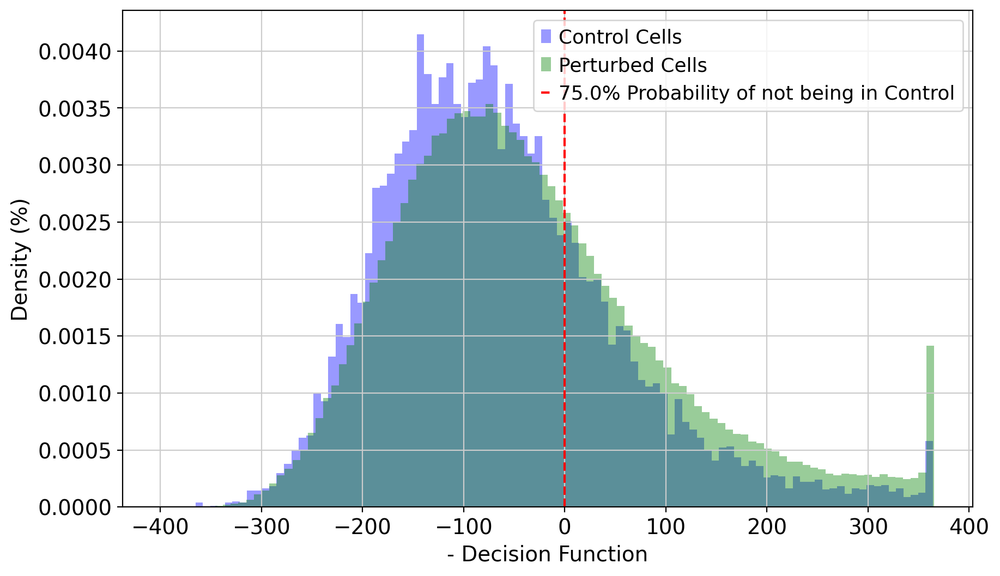

75349/230532 Perturbed Cells cross threshold of 0.75
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:04)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    with n_comps=50
    finished (0:01:36)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


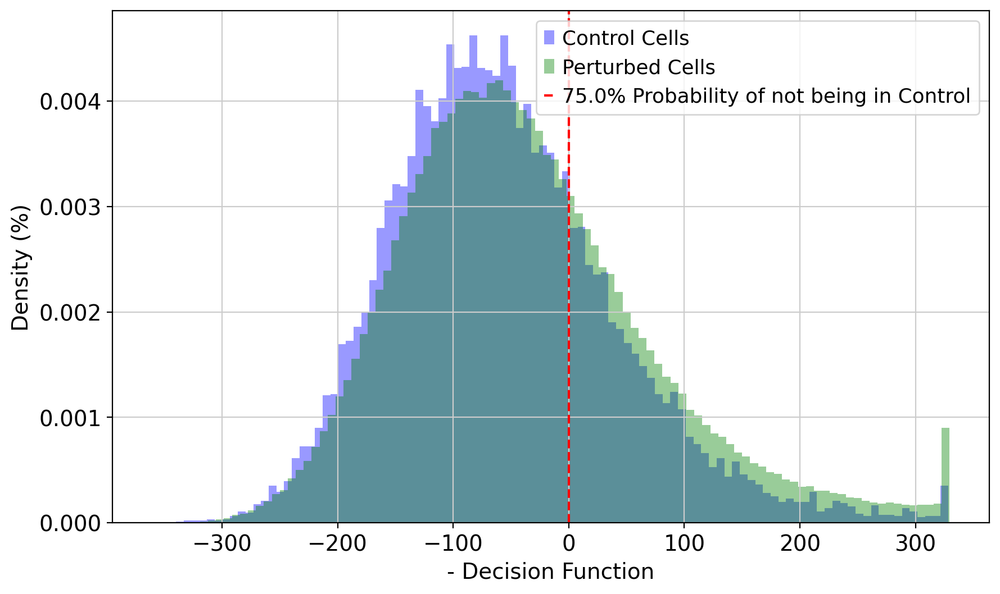

90540/291850 Perturbed Cells cross threshold of 0.75
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:03)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    with n_comps=50
    finished (0:01:32)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


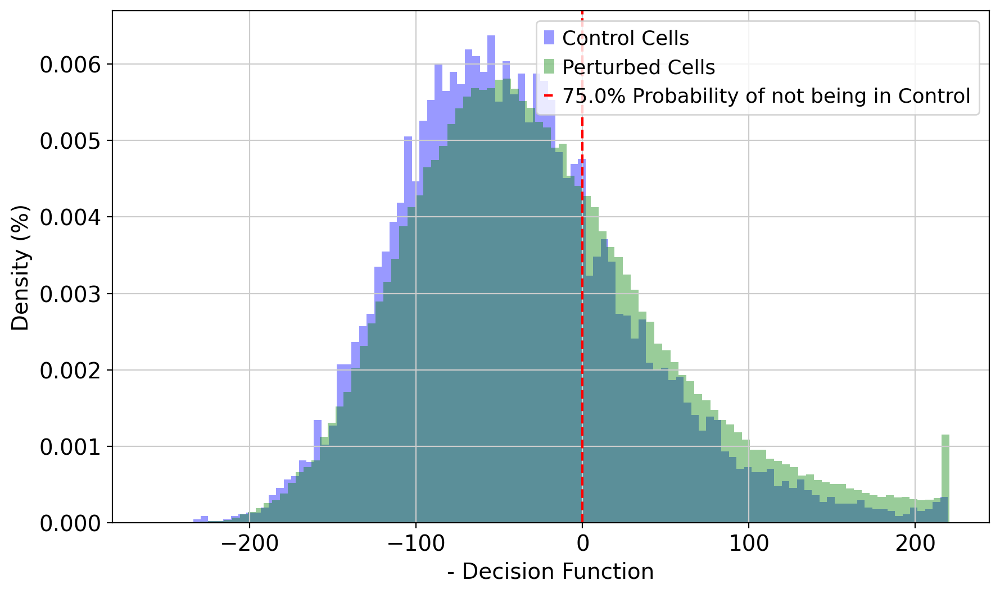

68798/220652 Perturbed Cells cross threshold of 0.75


In [5]:
adata_alpha_filtered, c, p = remove_unperturbed_cells(adata_alpha, threshold=0.75)
adata_beta_filtered, c, p = remove_unperturbed_cells(adata_beta, threshold=0.75)
adata_gamma_filtered, c, p = remove_unperturbed_cells(adata_gamma, threshold=0.75)

In [9]:
perturbation_counts = dict(adata_alpha_filtered.obs.gene_target.value_counts())
remaining_perturbations = [k for k,v in perturbation_counts.items() if v >= 25]
print(len(remaining_perturbations),remaining_perturbations)

1344 ['NTC', 'KAT2A', 'ADNP2', 'LRPPRC', 'DNMT1', 'ARHGAP35', 'CABIN1', 'BMAL2', 'EHMT1', 'EMSY', 'CHAMP1', 'PCGF1', 'TAF6L', 'TBXT', 'PNPT1', 'ZFP41', 'SIN3B', 'DMBX1', 'ONECUT3', 'FOXH1', 'EHMT2', 'ZFP57', 'ZNF829', 'ZNF580', 'GBX1', 'TFAM', 'EZH2', 'BRPF1', 'ZNF219', 'DHX36', 'SLFN13', 'ZNF562', 'ELOA', 'SOX4', 'ALKBH1', 'SMARCE1', 'POU5F1', 'ACTB', 'PITX3', 'ZNF875', 'TTLL8', 'DMRT3', 'SCAI', 'DDX6', 'ZNF594', 'ESRRA', 'EBF2', 'POLRMT', 'SLC22A1', 'ZFYVE26', 'FOXG1', 'BHLHE40', 'ZNF836', 'CCDC25', 'SNAI3', 'SIX6', 'PKNOX2', 'NOBOX', 'MED19', 'POGZ', 'ACSF3', 'ZKSCAN1', 'RPS6KA4', 'OVOL1', 'SMAD4', 'ZNF556', 'NANOG', 'ZNF81', 'CDK17', 'LEMD3', 'SUZ12', 'SHOX2', 'KMT2D', 'PLAGL2', 'IRX1', 'NR1I3', 'CDK13', 'THAP7', 'ID4', 'MAF1', 'GATAD1', 'AIRE', 'MACROH2A2', 'ATXN1L', 'H2BW2', 'SETDB1', 'GLI1', 'H3-7', 'ZNF16', 'RLIM', 'PHF13', 'PRDM13', 'PHF14', 'SUPT7L', 'ZNF596', 'ERI1', 'ISL1', 'SSBP1', 'DNASE2B', 'NPAS2', 'CIRBP', 'ELF4', 'ZNF276', 'RCOR2', 'AGXT2', 'ZBTB47', 'ZSCAN18', 'ZNF69

In [7]:
perturbation_counts = dict(adata_beta_filtered.obs.gene_target.value_counts())
remaining_perturbations = [k for k,v in perturbation_counts.items() if v >= 25]
print(len(remaining_perturbations),remaining_perturbations)

1597 ['NTC', 'HCCS', 'VPS33A', 'VHL', 'UBE2M', 'METRN', 'SLC11A2', 'SELENOW', 'UBFD1', 'VPS37C', 'CASP6', 'SH3BGRL3', 'ANKS3', 'NAE1', 'SCAF4', 'TESK1', 'AMIGO2', 'PTEN', 'SLC30A1', 'FTH1', 'MRPL36', 'CASP3', 'COL9A3', 'CLCN7', 'MZT2A', 'UBE2L6', 'HMBS', 'CAP1', 'UBB', 'STK25', 'LAMTOR1', 'COA7', 'TTC14', 'AKAP17A', 'FASTKD5', 'TMEM98', 'MTRF1L', 'IFITM1', 'MAN2C1', 'LAMTOR5', 'NDUFB9', 'AGMAT', 'CCDC6', 'JOSD1', 'AGRN', 'AK1', 'WDCP', 'GAS2L1', 'SNN', 'CYCS', 'MRPL11', 'CDKN3', 'PRUNE1', 'TEFM', 'EXT2', 'DESI2', 'IDS', 'LYSMD3', 'RINL', 'SPRY2', 'IKBIP', 'C19orf47', 'ARL4D', 'TAGLN2', 'TMEM248', 'FAAP20', 'PDLIM1', 'UBAC1', 'TBRG4', 'PPP1R1A', 'FJX1', 'EI24', 'OXCT2', 'GPHA2', 'TNKS2', 'FBXO46', 'MYADM', 'FAM210B', 'ARHGEF16', 'IPO9', 'CCDC14', 'DHRS11', 'MRPL24', 'INA', 'ST13', 'TMEM37', 'KCTD3', 'TOE1', 'SPRING1', 'KHDC4', 'POLDIP2', 'ELOVL6', 'ROR1', 'CASP9', 'MST1R', 'TSC1', 'ZSWIM4', 'RNF26', 'PLA2G12A', 'ART5', 'SH2D2A', 'IFFO1', 'PVR', 'HSPBP1', 'ZNF106', 'B3GALT6', 'C1R', 'LEF

In [8]:
perturbation_counts = dict(adata_gamma_filtered.obs.gene_target.value_counts())
remaining_perturbations = [k for k,v in perturbation_counts.items() if v >= 25]
print(len(remaining_perturbations),remaining_perturbations)

1166 ['NTC', 'FLYWCH2', 'DDT', 'SUPT20H', 'SCARB1', 'HS2ST1', 'FAM193A', 'NF2', 'BAK1', 'DNAL4', 'SAMD8', 'NOMO1', 'CCDC18', 'FLCN', 'ADAMTS13', 'STOML1', 'SNX22', 'BLTP1', 'FUT10', 'CA12', 'MBP', 'TIMM50', 'CNST', 'ERVMER34-1', 'FECH', 'FABP3', 'GABRD', 'SCAF8', 'SAMD10', 'CCDC112', 'C11orf86', 'SLC35E4', 'DTX2', 'EIF4ENIF1', 'SLC39A3', 'RETREG2', 'TGFBR2', 'RASA2', 'C2CD4B', 'RAB8B', 'FBXO31', 'HIPK2', 'KLHL24', 'DHODH', 'CBLC', 'MROH1', 'DGCR6L', 'DECR2', 'ARHGEF12', 'STK10', 'STK38L', 'CTRL', 'PIK3C2B', 'AKAP9', 'SSTR1', 'ABCG1', 'LRRC45', 'ALCAM', 'RNF207', 'RGPD6', 'NPEPPS', 'LHFPL2', 'BEND4', 'MPPE1', 'VAC14', 'TSC2', 'SPINT2', 'B9D1', 'CNNM2', 'NRBP1', 'EEIG2', 'GLDC', 'RALGAPB', 'CAPN10', 'CARD11', 'CALB1', 'CYB5RL', 'PDZD8', 'MTPAP', 'PLEKHF1', 'GRSF1', 'NNT', 'CFAP418', 'PALM3', 'TRIM4', 'QTRT2', 'KLHL34', 'CYBRD1', 'SLC4A7', 'USP14', 'DACT2', 'BECN1', 'HSPH1', 'ARIH1', 'PTGR2', 'RBM5', 'TTYH1', 'IGFBP5', 'INKA1', 'DNAJC18', 'GSTM4', 'TMEM179B', 'PIP4K2A', 'CCDC87', 'RSAD1',

In [17]:
def remove_perturbations_by_cell_threshold(adata, cell_threshold=25):
    perturbation_counts = dict(adata.obs.gene_target.value_counts())
    remaining_perturbations = [k for k,v in perturbation_counts.items() if v >= cell_threshold]
    print(f"Removing {len(perturbation_counts) - len(remaining_perturbations)} perturbations for having under {cell_threshold} cells.")
    return adata[adata.obs.gene_target.isin(remaining_perturbations),:].copy()
adata_alpha_filtered = remove_perturbations_by_cell_threshold(adata_alpha_filtered)
adata_beta_filtered = remove_perturbations_by_cell_threshold(adata_beta_filtered)
adata_gamma_filtered = remove_perturbations_by_cell_threshold(adata_gamma_filtered)

Removing 715 perturbations for having under 25 cells.


Removing 850 perturbations for having under 25 cells.
Removing 1332 perturbations for having under 25 cells.


In [18]:
adata_alpha_filtered.write("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_ALPHA_Core_Cells.h5ad")
adata_beta_filtered.write("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_BETA_Core_Cells.h5ad")
adata_gamma_filtered.write("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_GAMMA_Core_Cells.h5ad")

### DEGs

In [3]:
import numpy as np
import pandas as pd
from tqdm_joblib import tqdm
import matplotlib.pyplot as plt
import seaborn as sns
from pydeseq2.dds import DeseqDataSet
from pydeseq2.ds import DeseqStats
from pydeseq2.default_inference import DefaultInference
from joblib import Parallel, delayed, parallel_backend 
from tqdm.auto import tqdm
from tqdm_joblib import tqdm_joblib

def generate_pseudo_bulk_replicates_for_de(adata, gene_target, ntc_cells, n_replicates=3, sample_fraction=0.85, layer=None):
    """
    Generate pseudo-bulk replicates for a given gene target and matched NTC cells.
    """
    data_matrix = adata.layers[layer] if layer else adata.X
    target_indices = np.where(adata.obs['gene_target'] == gene_target)[0]
    n_target = len(target_indices)
    target_bulk = []
    ntc_bulk = []
    sample_names = []
    control_names = []

    for i in range(n_replicates):
        # Sample from gene_target
        sampled_target_indices = np.random.choice(target_indices, int(n_target * sample_fraction), replace=False)
        target_profile = data_matrix[sampled_target_indices].sum(axis=0)
        target_bulk.append(target_profile)
        sample_names.append(f"{gene_target}_rep_{i+1}")

        # Sample from NTC
        sampled_ntc_indices = np.random.choice(ntc_cells, int(n_target * sample_fraction), replace=False)
        ntc_profile = data_matrix[sampled_ntc_indices].sum(axis=0)
        ntc_bulk.append(ntc_profile)
        control_names.append(f"NTC_rep_{i+1}")
        
    
    # Convert to DataFrame
    sample_names.extend(control_names)
    metadata_records = [{'condition': sample.split('_')[0]} for sample in sample_names]
    pseudo_bulk_df = pd.DataFrame(np.vstack(target_bulk + ntc_bulk), index=sample_names, columns=adata.var_names)
    pseudo_bulk_df = pseudo_bulk_df[pseudo_bulk_df.columns[pseudo_bulk_df.sum(axis=0)>=1]] #Remove any samples with 0s in both NTC and Perturbed Sample
    metadata_df = pd.DataFrame(metadata_records, index=sample_names)
    
    return pseudo_bulk_df, metadata_df

def deseq2(data, metadata, contrast, alpha=0.05):
    dds = DeseqDataSet(
        counts=data,
        metadata=metadata,
        design_factors="condition",
        refit_cooks=True,
        ref_level=["condition", "NTC"],
        quiet = True
    )
    dds.deseq2()
    stat_res = DeseqStats(dds, contrast=contrast,quiet=True,alpha=alpha)
    stat_res.summary()
    results = stat_res.results_df
    return results

def run_deseq2_analysis(adata, gene_target_obs_column="gene_target", ntc_cells_delimiter="NTC", n_replicates=3, sample_fraction=0.7, layer=None, alpha=0.05, n_jobs=-1):
    ntc_cells = np.where(adata.obs[gene_target_obs_column] == ntc_cells_delimiter)[0]
    gene_targets = list(adata.obs[gene_target_obs_column].unique())
    gene_targets.remove(ntc_cells_delimiter)  # Remove the control group

    def process_gene_target(gene_target):
        pseudo_bulk_df, metadata_df = generate_pseudo_bulk_replicates_for_de(
            adata, gene_target, ntc_cells, n_replicates=n_replicates, sample_fraction=sample_fraction, layer=layer
        )
        return deseq2(pseudo_bulk_df, metadata_df, contrast=["condition", gene_target, ntc_cells_delimiter], alpha=alpha)

    with tqdm_joblib(desc="Running DE analysis", total=len(gene_targets)):
        results = Parallel(n_jobs=n_jobs)(delayed(process_gene_target)(gene_target) for gene_target in gene_targets)
    
    results_dict = dict(zip(gene_targets, results))
    
    return results_dict



import pandas as pd

def save_DEG_df(results_dict, p_threshold=0.05, save=True, filepath=None, num_show=10):
    # Initialize a dictionary to store columns for the final DataFrame
    final_dict = {}

    for gene_target, df in results_dict.items():
        # Filter the DataFrame based on the padj (adjusted p-value) threshold
        filtered_df = df[df['padj'] < p_threshold]

        # Sort by L2FC
        l2fc_sorted = filtered_df.sort_values('log2FoldChange')
        
        # Create columns for DEGs, L2FC, and Adj_P and add them to the final_dict
        final_dict[f'{gene_target}_DEGs'] = l2fc_sorted.index.tolist()
        final_dict[f'{gene_target}_L2FC'] = l2fc_sorted['log2FoldChange'].tolist()
        final_dict[f'{gene_target}_Adj_P'] = l2fc_sorted['padj'].tolist()

    # Group keys by gene target to maintain adjacency
    gene_targets = list(results_dict.keys())
    
    # Sort the gene targets by the number of DEGs
    sorted_gene_targets = sorted(gene_targets, key=lambda gt: len(final_dict[f'{gt}_DEGs']), reverse=True)
    
    # Reorder the final_dict to keep DEGs, L2FC, and Adj_P together for each gene target
    ordered_dict = {}
    for gene_target in sorted_gene_targets:
        ordered_dict[f'{gene_target}_DEGs'] = final_dict[f'{gene_target}_DEGs']
        ordered_dict[f'{gene_target}_L2FC'] = final_dict[f'{gene_target}_L2FC']
        ordered_dict[f'{gene_target}_Adj_P'] = final_dict[f'{gene_target}_Adj_P']

    # Find the maximum length of lists in the ordered_dict to handle unequal lengths
    max_length = max(len(lst) for lst in ordered_dict.values())

    # Pad shorter lists with None to ensure equal length columns
    for key in ordered_dict:
        ordered_dict[key].extend([None] * (max_length - len(ordered_dict[key])))

    # Create the final DataFrame directly from the dictionary
    combined_df = pd.DataFrame(ordered_dict)

    if save and filepath:
        with pd.ExcelWriter(filepath) as writer:
            combined_df.to_excel(writer, sheet_name='DEG Results', index=False)

    # Display the first few rows of the p-value sorted DataFrame
    display(combined_df.head(num_show))
    display(combined_df.head(-num_show))
    
    # Return the combined DataFrame
    return combined_df



import numpy as np
import matplotlib.pyplot as plt

def plot_differentially_expressed_genes(results_dict, p_value_threshold=0.05, l2fc_threshold=0, deg_cutoff=25):
    """
    Plots the number of significantly upregulated and downregulated genes per perturbation.

    Parameters:
    - results_dict: dict, dictionary containing DESeq2 results DataFrames, where each key is a perturbation (gene_target).
    - p_value_threshold: float, p-value threshold for considering a gene as differentially expressed.
    - l2fc_threshold: float, log2 fold change threshold for directionality of gene regulation.
    - deg_cutoff: int, cutoff for the minimum number of DEGs required to highlight the bar in a different color.
    """
    
    # Initialize dictionaries to hold the counts of upregulated and downregulated genes
    significant_counts = {}
    
    # Iterate through the perturbations
    for perturbation, df in results_dict.items():
        # Get the padj (adjusted p-values) and log2FoldChange for the current perturbation
        p_values = df['padj']
        l2fc = df['log2FoldChange']
        
        # Determine which genes are significantly upregulated or downregulated
        upregulated = (p_values < p_value_threshold) & (l2fc > l2fc_threshold)
        downregulated = (p_values < p_value_threshold) & (l2fc < -l2fc_threshold)
        
        significant_counts[perturbation] = (upregulated.sum(), downregulated.sum())
    
    # Calculate the maximum count for setting y-axis limits
    max_count = max(max(abs(count) for count in counts) for counts in significant_counts.values())
    
    # Order perturbations by the total number of significantly regulated genes
    ordered_perturbations = sorted(significant_counts.keys(), key=lambda x: abs(sum(significant_counts[x])), reverse=True)
    
    # Plot the results
    plt.figure(figsize=(20, 12))
    
    for perturbation in ordered_perturbations:
        total_deg = significant_counts[perturbation][0] + significant_counts[perturbation][1]
        color_up = '#008000' if total_deg > deg_cutoff else '#BDE7BD'  # Darker green for upregulated
        color_down = '#800000' if total_deg > deg_cutoff else '#FFB6B3'  # Darker red for downregulated
        plt.bar(perturbation, significant_counts[perturbation][0], color=color_up)
        plt.bar(perturbation, -significant_counts[perturbation][1], color=color_down)  # Invert downregulated count
    
    plt.xlabel('Perturbation')
    plt.ylabel(f'Count of Significant Genes (p-value < {p_value_threshold})')
    plt.title('Count of Significantly Regulated Genes per Perturbation')
    plt.xticks(rotation=90)
    plt.ylim(-max_count, max_count)  # Set y-axis limits
    
    # Set y-axis to show positive values for both directions
    num_ticks = 10
    step = max_count / num_ticks
    y_ticks = np.arange(-max_count, max_count + step, step)
    y_labels = [str(abs(int(tick))) for tick in y_ticks]
    plt.yticks(y_ticks, y_labels)
    plt.legend(['Upregulated', 'Downregulated'])
    plt.axhline(0, color='black', linewidth=0.5)
    plt.grid(True, which='both', linestyle='-', color='gray', alpha=0.25)
    plt.subplots_adjust(left=0.01, right=0.95, top=0.95, bottom=0.25)
    plt.show()


Running DE analysis:   0%|          | 0/1343 [00:00<?, ?it/s]

/tscc/nfs/home/ydoctor/.local/lib/python3.11/site-packages/pydeseq2/dds.py:716: UserWarning: The dispersion trend curve fitting did not converge. Switching to a mean-based dispersion trend.
  self._fit_parametric_dispersion_trend(vst)
/tscc/nfs/home/ydoctor/.local/lib/python3.11/site-packages/pydeseq2/dds.py:716: UserWarning: The dispersion trend curve fitting did not converge. Switching to a mean-based dispersion trend.
  self._fit_parametric_dispersion_trend(vst)
/tscc/nfs/home/ydoctor/.local/lib/python3.11/site-packages/pydeseq2/dds.py:716: UserWarning: The dispersion trend curve fitting did not converge. Switching to a mean-based dispersion trend.
  self._fit_parametric_dispersion_trend(vst)
/tscc/nfs/home/ydoctor/.local/lib/python3.11/site-packages/pydeseq2/dds.py:716: UserWarning: The dispersion trend curve fitting did not converge. Switching to a mean-based dispersion trend.
  self._fit_parametric_dispersion_trend(vst)
/tscc/nfs/home/ydoctor/.local/lib/python3.11/site-packages/p

,POU5F1_DEGs,POU5F1_L2FC,POU5F1_Adj_P,POU5F1B_DEGs,POU5F1B_L2FC,POU5F1B_Adj_P,POU3F2_DEGs,POU3F2_L2FC,POU3F2_Adj_P,KAT2A_DEGs,...,BARHL1_Adj_P,IKZF4_DEGs,IKZF4_L2FC,IKZF4_Adj_P,SMAD5_DEGs,SMAD5_L2FC,SMAD5_Adj_P,ERBB2_DEGs,ERBB2_L2FC,ERBB2_Adj_P
0,DNER,-5.639592,0.037909,ENSG00000260834,-4.713631,8.719460e-04,LAMC3,-4.514775,0.048854,MT1H,...,None,None,None,None,None,None,None,None,None,None
1,LEFTY1,-5.581670,0.042005,ETS1,-4.542041,2.774524e-02,COMTD1,-3.947577,0.013530,ZNF581,...,None,None,None,None,None,None,None,None,None,None
2,AP3B2,-5.451315,0.049300,VAT1L,-4.481019,4.147879e-02,PER3,-3.763364,0.025508,PCK2,...,None,None,None,None,None,None,None,None,None,None
3,ENSG00000259048,-4.890572,0.000130,PIWIL4-AS1,-4.394804,3.701809e-02,TUBA4A,-3.551956,0.042226,MT1G,...,None,None,None,None,None,None,None,None,None,None
4,ENSG00000290685,-4.737234,0.014314,TENM2,-4.281473,5.034153e-03,GRIK5,-3.368701,0.015300,STC2,...,None,None,None,None,None,None,None,None,None,None
5,IGSF9B,-3.886803,0.007532,FOXD3-AS1,-4.218117,1.114194e-04,HES6,-3.239361,0.021154,SLC7A11,...,None,None,None,None,None,None,None,None,None,None
6,DGKB,-3.791288,0.001022,LINC00707,-4.020787,8.340991e-03,SPOCK3,-3.157455,0.007583,GNAO1,...,None,None,None,None,None,None,None,None,None,None
7,B3GALT5,-3.784159,0.010231,ENSG00000228204,-3.567298,3.237916e-03,PNP,-2.804920,0.004863,DFFA,...,None,None,None,None,None,None,None,None,None,None
8,ENSG00000269842,-3.533645,0.021776,MGAT4C,-3.529606,7.593213e-07,AGAP6,-2.624473,0.010464,KEAP1,...,None,None,None,None,None,None,None,None,None,None
9,LINC02700,-3.530056,0.021465,COA6,-3.494567,2.997828e-02,ADM,-2.510738,0.039566,PIM1,...,None,None,None,None,None,None,None,None,None,None


,POU5F1_DEGs,POU5F1_L2FC,POU5F1_Adj_P,POU5F1B_DEGs,POU5F1B_L2FC,POU5F1B_Adj_P,POU3F2_DEGs,POU3F2_L2FC,POU3F2_Adj_P,KAT2A_DEGs,...,BARHL1_Adj_P,IKZF4_DEGs,IKZF4_L2FC,IKZF4_Adj_P,SMAD5_DEGs,SMAD5_L2FC,SMAD5_Adj_P,ERBB2_DEGs,ERBB2_L2FC,ERBB2_Adj_P
0,DNER,-5.639592,0.037909,ENSG00000260834,-4.713631,0.000872,LAMC3,-4.514775,0.048854,MT1H,...,None,None,None,None,None,None,None,None,None,None
1,LEFTY1,-5.581670,0.042005,ETS1,-4.542041,0.027745,COMTD1,-3.947577,0.013530,ZNF581,...,None,None,None,None,None,None,None,None,None,None
2,AP3B2,-5.451315,0.049300,VAT1L,-4.481019,0.041479,PER3,-3.763364,0.025508,PCK2,...,None,None,None,None,None,None,None,None,None,None
3,ENSG00000259048,-4.890572,0.000130,PIWIL4-AS1,-4.394804,0.037018,TUBA4A,-3.551956,0.042226,MT1G,...,None,None,None,None,None,None,None,None,None,None
4,ENSG00000290685,-4.737234,0.014314,TENM2,-4.281473,0.005034,GRIK5,-3.368701,0.015300,STC2,...,None,None,None,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1680,ENSG00000258631,7.051984,0.000015,None,NaN,NaN,None,NaN,NaN,None,...,None,None,None,None,None,None,None,None,None,None
1681,LMO1,7.077343,0.004077,None,NaN,NaN,None,NaN,NaN,None,...,None,None,None,None,None,None,None,None,None,None
1682,MEIS1,7.093489,0.003984,None,NaN,NaN,None,NaN,NaN,None,...,None,None,None,None,None,None,None,None,None,None
1683,ANKRD1,7.114162,0.003809,None,NaN,NaN,None,NaN,NaN,None,...,None,None,None,None,None,None,None,None,None,None


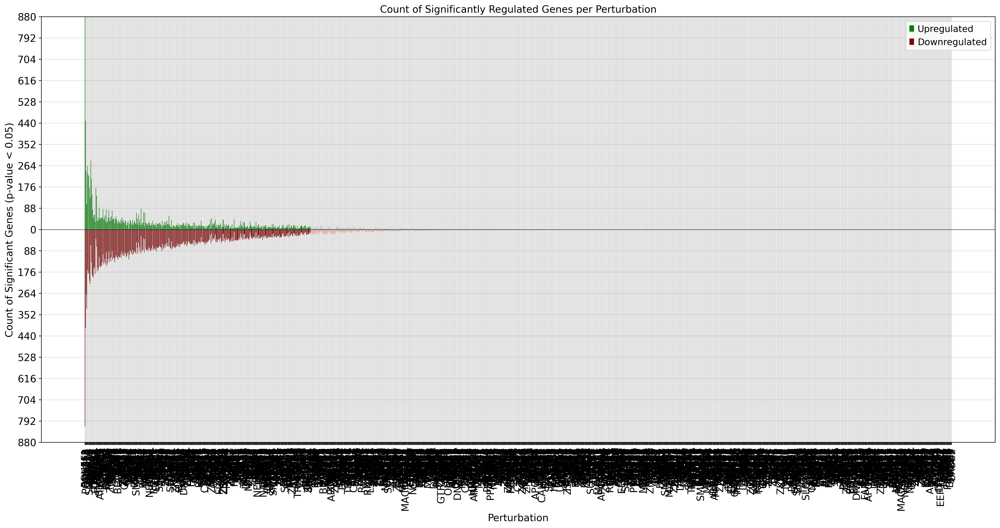

Running DE analysis:   0%|          | 0/1596 [00:00<?, ?it/s]

/tscc/nfs/home/ydoctor/.local/lib/python3.11/site-packages/pydeseq2/dds.py:716: UserWarning: The dispersion trend curve fitting did not converge. Switching to a mean-based dispersion trend.
  self._fit_parametric_dispersion_trend(vst)
/tscc/nfs/home/ydoctor/.local/lib/python3.11/site-packages/pydeseq2/dds.py:716: UserWarning: The dispersion trend curve fitting did not converge. Switching to a mean-based dispersion trend.
  self._fit_parametric_dispersion_trend(vst)
/tscc/nfs/home/ydoctor/.local/lib/python3.11/site-packages/pydeseq2/dds.py:716: UserWarning: The dispersion trend curve fitting did not converge. Switching to a mean-based dispersion trend.
  self._fit_parametric_dispersion_trend(vst)
/tscc/nfs/home/ydoctor/.local/lib/python3.11/site-packages/pydeseq2/dds.py:716: UserWarning: The dispersion trend curve fitting did not converge. Switching to a mean-based dispersion trend.
  self._fit_parametric_dispersion_trend(vst)
/tscc/nfs/home/ydoctor/.local/lib/python3.11/site-packages/p

,DBR1_DEGs,DBR1_L2FC,DBR1_Adj_P,MYADM_DEGs,MYADM_L2FC,MYADM_Adj_P,PTPN1_DEGs,PTPN1_L2FC,PTPN1_Adj_P,JOSD1_DEGs,...,CFAP20_Adj_P,IGDCC3_DEGs,IGDCC3_L2FC,IGDCC3_Adj_P,FZD5_DEGs,FZD5_L2FC,FZD5_Adj_P,AGAP3_DEGs,AGAP3_L2FC,AGAP3_Adj_P
0,SNRNP27,-3.649577,0.002122,SLC9C1,-3.752310,1.843060e-03,ENSG00000260362,-6.565694,1.518739e-02,ANKRD9,...,None,None,None,None,None,None,None,None,None,None
1,SORBS2,-3.495849,0.000687,RNF125,-2.486398,5.805370e-03,PTPN1,-5.879380,4.255530e-02,TYK2,...,None,None,None,None,None,None,None,None,None,None
2,ADGRB3,-3.171319,0.000045,CFAP95,-2.397166,1.578734e-02,LINC02540,-5.863990,4.545400e-02,FAM174C,...,None,None,None,None,None,None,None,None,None,None
3,HIGD1A,-3.070884,0.002619,RNF141,-2.341277,1.749023e-03,AP3B2,-4.467399,4.255530e-02,CPXM2,...,None,None,None,None,None,None,None,None,None,None
4,ZMYM3,-3.034929,0.005830,LINC02751,-2.146955,6.434765e-03,ACOXL,-4.038622,7.729047e-08,SCAMP5,...,None,None,None,None,None,None,None,None,None,None
5,DNPH1,-2.756158,0.007183,HDDC3,-2.076247,1.509435e-02,KCNG3,-3.966632,9.181795e-03,PUSL1,...,None,None,None,None,None,None,None,None,None,None
6,TMEM220-AS1,-2.752055,0.013038,LSM14B,-1.962700,1.744947e-02,EPHA1-AS1,-3.775013,1.678820e-02,EXO1,...,None,None,None,None,None,None,None,None,None,None
7,ENSG00000257496,-2.744354,0.000133,FZD6,-1.928301,1.535817e-02,LINC02570,-3.740686,2.182504e-02,ADI1,...,None,None,None,None,None,None,None,None,None,None
8,CLTB,-2.716313,0.012515,TMEM220-AS1,-1.922194,5.805370e-03,ENSG00000231698,-3.539526,1.965325e-07,ENSG00000188897,...,None,None,None,None,None,None,None,None,None,None
9,HES6,-2.654794,0.004394,TMSB15A,-1.896139,5.121429e-09,LINC02335,-3.477766,1.115431e-13,ENSG00000289509,...,None,None,None,None,None,None,None,None,None,None


,DBR1_DEGs,DBR1_L2FC,DBR1_Adj_P,MYADM_DEGs,MYADM_L2FC,MYADM_Adj_P,PTPN1_DEGs,PTPN1_L2FC,PTPN1_Adj_P,JOSD1_DEGs,...,CFAP20_Adj_P,IGDCC3_DEGs,IGDCC3_L2FC,IGDCC3_Adj_P,FZD5_DEGs,FZD5_L2FC,FZD5_Adj_P,AGAP3_DEGs,AGAP3_L2FC,AGAP3_Adj_P
0,SNRNP27,-3.649577,2.122342e-03,SLC9C1,-3.752310,0.001843,ENSG00000260362,-6.565694,1.518739e-02,ANKRD9,...,None,None,None,None,None,None,None,None,None,None
1,SORBS2,-3.495849,6.872864e-04,RNF125,-2.486398,0.005805,PTPN1,-5.879380,4.255530e-02,TYK2,...,None,None,None,None,None,None,None,None,None,None
2,ADGRB3,-3.171319,4.475503e-05,CFAP95,-2.397166,0.015787,LINC02540,-5.863990,4.545400e-02,FAM174C,...,None,None,None,None,None,None,None,None,None,None
3,HIGD1A,-3.070884,2.618812e-03,RNF141,-2.341277,0.001749,AP3B2,-4.467399,4.255530e-02,CPXM2,...,None,None,None,None,None,None,None,None,None,None
4,ZMYM3,-3.034929,5.829712e-03,LINC02751,-2.146955,0.006435,ACOXL,-4.038622,7.729047e-08,SCAMP5,...,None,None,None,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1120,INO80,2.654057,7.653069e-12,None,NaN,NaN,None,NaN,NaN,None,...,None,None,None,None,None,None,None,None,None,None
1121,CDKN1A,2.669027,8.106973e-04,None,NaN,NaN,None,NaN,NaN,None,...,None,None,None,None,None,None,None,None,None,None
1122,ACSM6,2.738692,4.891148e-03,None,NaN,NaN,None,NaN,NaN,None,...,None,None,None,None,None,None,None,None,None,None
1123,ENSG00000267523,2.760056,1.274104e-02,None,NaN,NaN,None,NaN,NaN,None,...,None,None,None,None,None,None,None,None,None,None


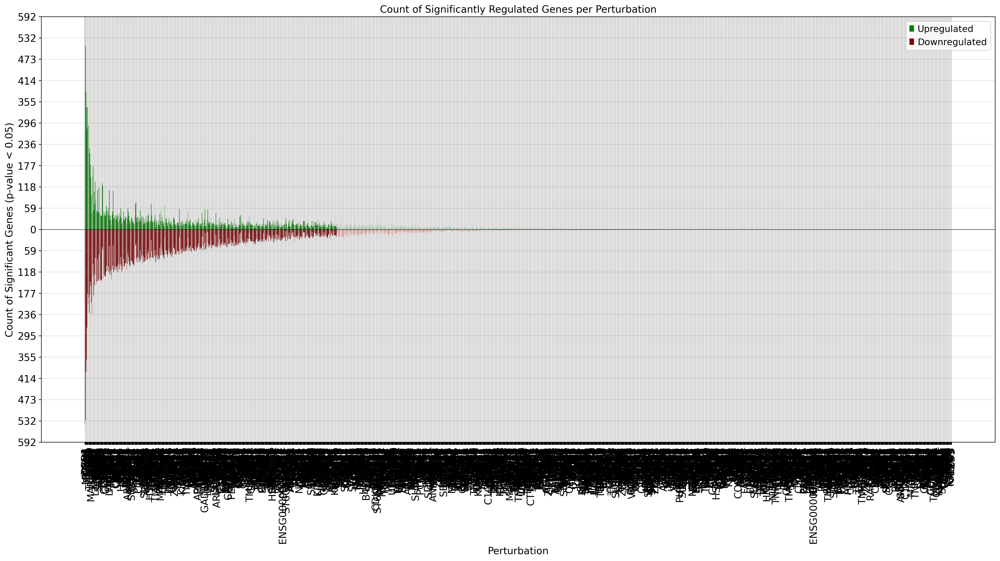

Running DE analysis:   0%|          | 0/1165 [00:00<?, ?it/s]

/tscc/nfs/home/ydoctor/.local/lib/python3.11/site-packages/pydeseq2/dds.py:716: UserWarning: The dispersion trend curve fitting did not converge. Switching to a mean-based dispersion trend.
  self._fit_parametric_dispersion_trend(vst)
/tscc/nfs/home/ydoctor/.local/lib/python3.11/site-packages/pydeseq2/dds.py:716: UserWarning: The dispersion trend curve fitting did not converge. Switching to a mean-based dispersion trend.
  self._fit_parametric_dispersion_trend(vst)
/tscc/nfs/home/ydoctor/.local/lib/python3.11/site-packages/pydeseq2/dds.py:716: UserWarning: The dispersion trend curve fitting did not converge. Switching to a mean-based dispersion trend.
  self._fit_parametric_dispersion_trend(vst)
/tscc/nfs/home/ydoctor/.local/lib/python3.11/site-packages/pydeseq2/dds.py:716: UserWarning: The dispersion trend curve fitting did not converge. Switching to a mean-based dispersion trend.
  self._fit_parametric_dispersion_trend(vst)
/tscc/nfs/home/ydoctor/.local/lib/python3.11/site-packages/p

,RNF7_DEGs,RNF7_L2FC,RNF7_Adj_P,FLYWCH2_DEGs,FLYWCH2_L2FC,FLYWCH2_Adj_P,C5orf34_DEGs,C5orf34_L2FC,C5orf34_Adj_P,STOML1_DEGs,...,UQCRB_Adj_P,GAS8_DEGs,GAS8_L2FC,GAS8_Adj_P,CLCN6_DEGs,CLCN6_L2FC,CLCN6_Adj_P,EEIG1_DEGs,EEIG1_L2FC,EEIG1_Adj_P
0,ENSG00000235152,-6.302025,0.040403,SMOC2,-2.158958,0.000408,TOMM6,-1.149432,6.248716e-04,CAPN15,...,None,None,None,None,None,None,None,None,None,None
1,RNF7,-5.926842,0.000003,NUCB1,-1.833384,0.045724,KDELR1,-1.108887,1.766439e-03,CHMP7,...,None,None,None,None,None,None,None,None,None,None
2,PEX5L,-3.227315,0.033658,TRIML2,-1.801491,0.041711,BASP1,-1.020041,7.216186e-03,ENSG00000283415,...,None,None,None,None,None,None,None,None,None,None
3,CEBPB,-3.171419,0.037724,SLC25A38,-1.720320,0.008689,LSM3,-1.016578,1.334388e-02,ENSG00000233290,...,None,None,None,None,None,None,None,None,None,None
4,ENSG00000287392,-3.055194,0.017055,RHOBTB3,-1.547695,0.039591,COA4,-0.972973,1.429057e-02,MGAT4C,...,None,None,None,None,None,None,None,None,None,None
5,MRPL58,-2.909678,0.033658,OTUD6B,-1.451700,0.043376,POLR2L,-0.968291,2.039804e-02,MRGBP,...,None,None,None,None,None,None,None,None,None,None
6,KCNG3,-2.777776,0.019369,NUP35,-1.389747,0.005864,MRPS26,-0.934474,2.134096e-02,FAM32A,...,None,None,None,None,None,None,None,None,None,None
7,NSUN2,-2.569078,0.024973,NAA10,-1.320763,0.023100,NDUFA13,-0.919970,1.892190e-02,PDZD4,...,None,None,None,None,None,None,None,None,None,None
8,SDF2L1,-2.376177,0.030426,MACROD1,-1.268213,0.045757,RPS14,-0.910067,2.668116e-16,ENSG00000282048,...,None,None,None,None,None,None,None,None,None,None
9,UNC119,-2.331969,0.042209,NDUFS7,-1.234166,0.037735,SELENOH,-0.897006,1.746429e-02,HTR1F,...,None,None,None,None,None,None,None,None,None,None


,RNF7_DEGs,RNF7_L2FC,RNF7_Adj_P,FLYWCH2_DEGs,FLYWCH2_L2FC,FLYWCH2_Adj_P,C5orf34_DEGs,C5orf34_L2FC,C5orf34_Adj_P,STOML1_DEGs,...,UQCRB_Adj_P,GAS8_DEGs,GAS8_L2FC,GAS8_Adj_P,CLCN6_DEGs,CLCN6_L2FC,CLCN6_Adj_P,EEIG1_DEGs,EEIG1_L2FC,EEIG1_Adj_P
0,ENSG00000235152,-6.302025,4.040257e-02,SMOC2,-2.158958,0.000408,TOMM6,-1.149432,0.000625,CAPN15,...,None,None,None,None,None,None,None,None,None,None
1,RNF7,-5.926842,3.427494e-06,NUCB1,-1.833384,0.045724,KDELR1,-1.108887,0.001766,CHMP7,...,None,None,None,None,None,None,None,None,None,None
2,PEX5L,-3.227315,3.365803e-02,TRIML2,-1.801491,0.041711,BASP1,-1.020041,0.007216,ENSG00000283415,...,None,None,None,None,None,None,None,None,None,None
3,CEBPB,-3.171419,3.772393e-02,SLC25A38,-1.720320,0.008689,LSM3,-1.016578,0.013344,ENSG00000233290,...,None,None,None,None,None,None,None,None,None,None
4,ENSG00000287392,-3.055194,1.705543e-02,RHOBTB3,-1.547695,0.039591,COA4,-0.972973,0.014291,MGAT4C,...,None,None,None,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
317,FST,5.598486,5.468489e-03,None,NaN,NaN,None,NaN,NaN,None,...,None,None,None,None,None,None,None,None,None,None
318,LINC01208,5.722076,8.250043e-18,None,NaN,NaN,None,NaN,NaN,None,...,None,None,None,None,None,None,None,None,None,None
319,MBNL2,5.748660,3.618648e-03,None,NaN,NaN,None,NaN,NaN,None,...,None,None,None,None,None,None,None,None,None,None
320,PCDH9,5.810173,3.110625e-03,None,NaN,NaN,None,NaN,NaN,None,...,None,None,None,None,None,None,None,None,None,None


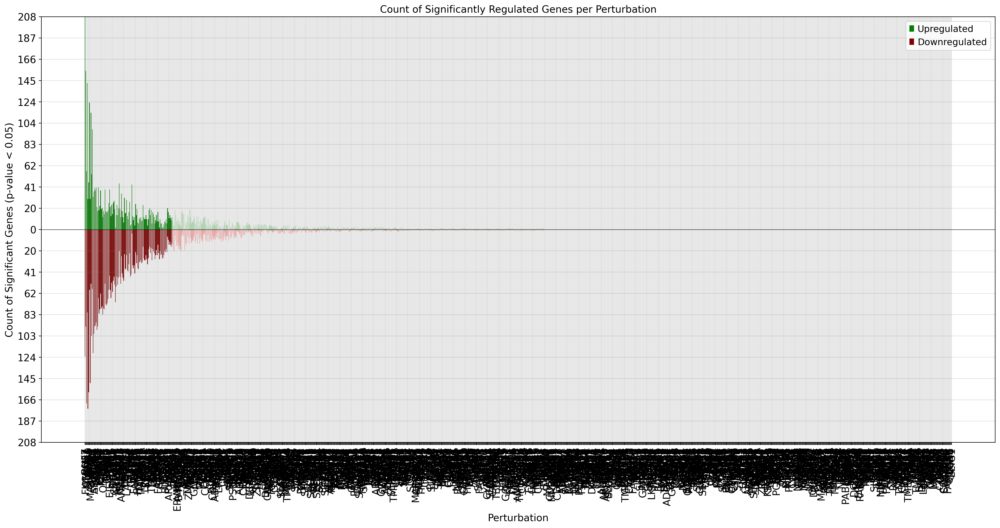

In [4]:
import anndata as ad

adata_alpha = ad.read_h5ad("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_ALPHA_Core_Cells.h5ad")
adata_alpha.X = adata_alpha.layers["counts"].copy()
results_dict_alpha = run_deseq2_analysis(adata_alpha)
deg_results_df_alpha = save_DEG_df(results_dict_alpha,filepath="/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/analysis_files/ALPHA_DEGs.xlsx");
plot_differentially_expressed_genes(results_dict_alpha)

adata_beta = ad.read_h5ad("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_BETA_Core_Cells.h5ad")
adata_beta.X = adata_beta.layers["counts"].copy()
results_dict_beta = run_deseq2_analysis(adata_beta)
deg_results_df_beta = save_DEG_df(results_dict_beta,filepath="/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/analysis_files/BETA_DEGs.xlsx");
plot_differentially_expressed_genes(results_dict_beta)

adata_gamma = ad.read_h5ad("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_GAMMA_Core_Cells.h5ad")
adata_gamma.X = adata_gamma.layers["counts"].copy()
results_dict_gamma = run_deseq2_analysis(adata_gamma)
deg_results_df_gamma = save_DEG_df(results_dict_gamma,filepath="/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/analysis_files/GAMMA_DEGs.xlsx");
plot_differentially_expressed_genes(results_dict_gamma)

In [5]:
all_res = results_dict_alpha | results_dict_beta | results_dict_gamma

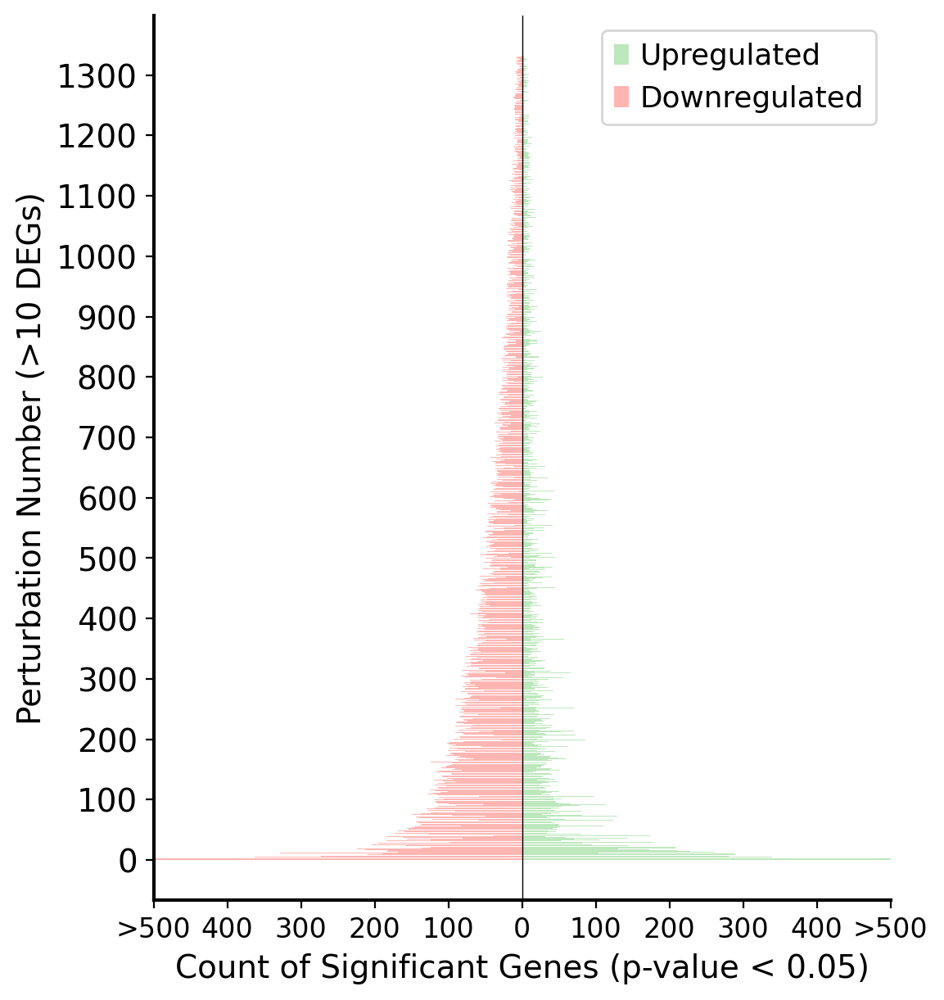

In [6]:
import matplotlib.pyplot as plt
import numpy as np

def plot_filtered_genes_inverted(results_dict, p_value_threshold=0.05, l2fc_threshold=0, deg_cutoff=25, min_total_deg=10):
    significant_counts = {}

    for perturbation, df in results_dict.items():
        p_values = df['padj']
        l2fc = df['log2FoldChange']
        upregulated = (p_values < p_value_threshold) & (l2fc > l2fc_threshold)
        downregulated = (p_values < p_value_threshold) & (l2fc < -l2fc_threshold)
        total_deg = upregulated.sum() + downregulated.sum()
        if total_deg >= min_total_deg:  # Filter to show only perturbations with more than min_total_deg DEGs
            significant_counts[perturbation] = (upregulated.sum(), downregulated.sum())

    if not significant_counts:
        print("No perturbations with significant DEGs above the specified threshold.")
        return

    max_count = 500
    # Sort in ascending order
    ordered_perturbations = sorted(significant_counts.keys(), key=lambda x: abs(sum(significant_counts[x])),reverse=True)

    fig, ax = plt.subplots(figsize=(6, 6))  # Inverted dimensions
    for idx, perturbation in enumerate(ordered_perturbations):
        total_deg = significant_counts[perturbation][0] + significant_counts[perturbation][1]
        color_up = '#BDE7BD' if total_deg > deg_cutoff else '#BDE7BD'
        color_down = '#FFB6B3' if total_deg > deg_cutoff else '#FFB6B3'
        ax.barh(idx, significant_counts[perturbation][0], color=color_up)  # Horizontal bar for upregulated
        ax.barh(idx, -significant_counts[perturbation][1], color=color_down)  # Horizontal bar for downregulated
    
    ax.set_ylabel('Perturbation Number (>10 DEGs)')
    ax.set_xlabel(f'Count of Significant Genes (p-value < {p_value_threshold})')

    # Place y-ticks every 100 perturbations and flip them
    ax.set_yticks(range(0, len(ordered_perturbations), 100))

    ax.set_xlim(-max_count, max_count)
    ax.set_xticks(np.arange(-max_count, max_count + 1, step=100))  # Set x-ticks every 100
    ax.set_xticklabels([str(abs(int(tick))) if abs(tick) != max_count else ">500" for tick in np.arange(-max_count, max_count + 1, step=100)], fontsize=12)
    ax.legend(['Upregulated', 'Downregulated'], loc='upper right')
    ax.axvline(0, color='black', linewidth=0.5)
    ax.grid(False)
    plt.subplots_adjust(left=0.2, right=0.95, top=0.95, bottom=0.05)

    # Style the axes
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_linewidth(1.5)
    ax.spines['left'].set_linewidth(1.5)

    plt.show()
    return fig, (ordered_perturbations, [significant_counts[pert] for pert in ordered_perturbations])

# Example usage:
f, strong_perts = plot_filtered_genes_inverted(all_res, deg_cutoff=0, min_total_deg=10)  # Adjust min_total_deg as needed
f.savefig("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/output_files/up_down_DEGs.svg")



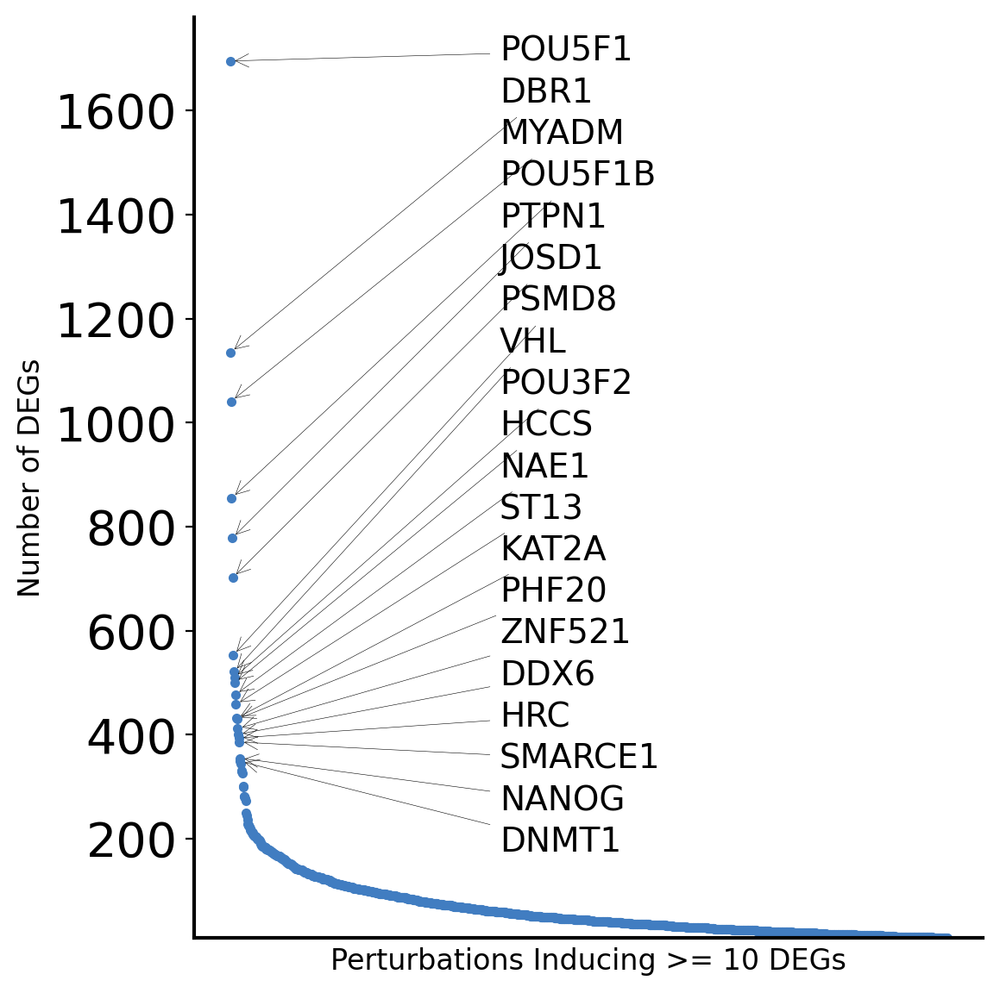

In [7]:
import matplotlib.pyplot as plt
import numpy as np

def plot_degs_dotplot(degs):
    """
    Plots a dot plot of DEGs, labeling the top 20 results with arrows for readability.
    """
    
    # Get the top 20 perturbations
    top_20 = list(degs.keys())[:20]  # Use the top 20 from the sorted list

    # Plotting
    fig, ax = plt.subplots(figsize=(6, 6))
    x_values = range(len(degs))
    y_values = list(degs.values())

    # Plot the data points
    ax.plot(x_values, y_values, '.', color='#417dc1')

    # Set a fixed x-coordinate for the annotations
    annotation_x = 500  # Position annotations to the right of the plot

    # Prepare y-offset for annotations
    y_offset = 80  # Adjust this value to control the spacing between labels
    y_positions = [max(y_values) - i * y_offset for i in range(len(top_20))]

    # Add labels with arrows for the top 20 perturbations
    for i, perturbation in enumerate(degs.keys()):
        if perturbation in top_20:
            ax.annotate(perturbation,
                        xy=(i, y_values[i]),  # Point being annotated
                        xytext=(annotation_x, y_positions[top_20.index(perturbation)]),  # Annotation position
                        textcoords='data',
                        ha='left',  # Horizontal alignment of the text
                        fontsize=14,
                        arrowprops=dict(facecolor='black', arrowstyle='->', lw=0.2))

    # Set labels
    ax.set_ylabel("Number of DEGs", fontsize=12)
    ax.set_xticks([])
    ax.set_ylim(bottom=10)
    ax.set_xlabel("Perturbations Inducing >= 10 DEGs", fontsize=12)
    ax.grid(False)
    ax.tick_params(axis='y', labelsize=20)

    # Style the axes
    ax.set_facecolor('white')
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_linewidth(1.5)
    ax.spines['left'].set_linewidth(1.5)

    plt.tight_layout()
    plt.show()
    return fig

# Example usage:
deg_names = strong_perts[0]
total_degs = [a+b for a,b in strong_perts[1]]
sorted_deg_list = {k:v for k,v in zip(deg_names, total_degs)}
f = plot_degs_dotplot(sorted_deg_list)
f.savefig("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/output_files/top_DEGs.svg")


In [8]:
strong_perturbations = strong_perts[0]
with open("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/input_files/strong_perturbations.txt",'w') as file:
    for item in strong_perturbations:
        file.write(f"{item}\n")

### Plotting Number of DEGs vs Fitness Score

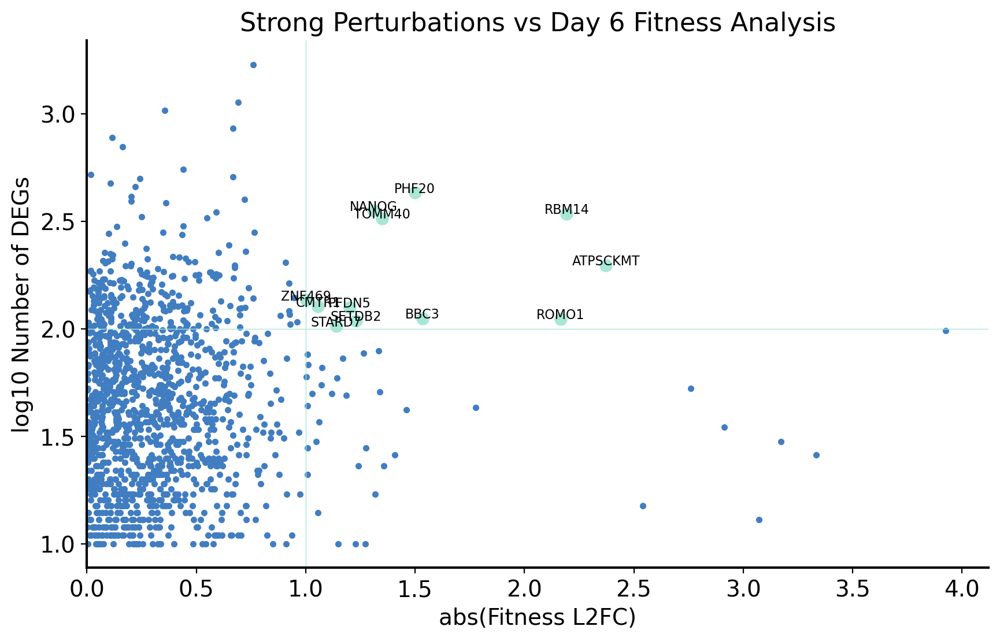

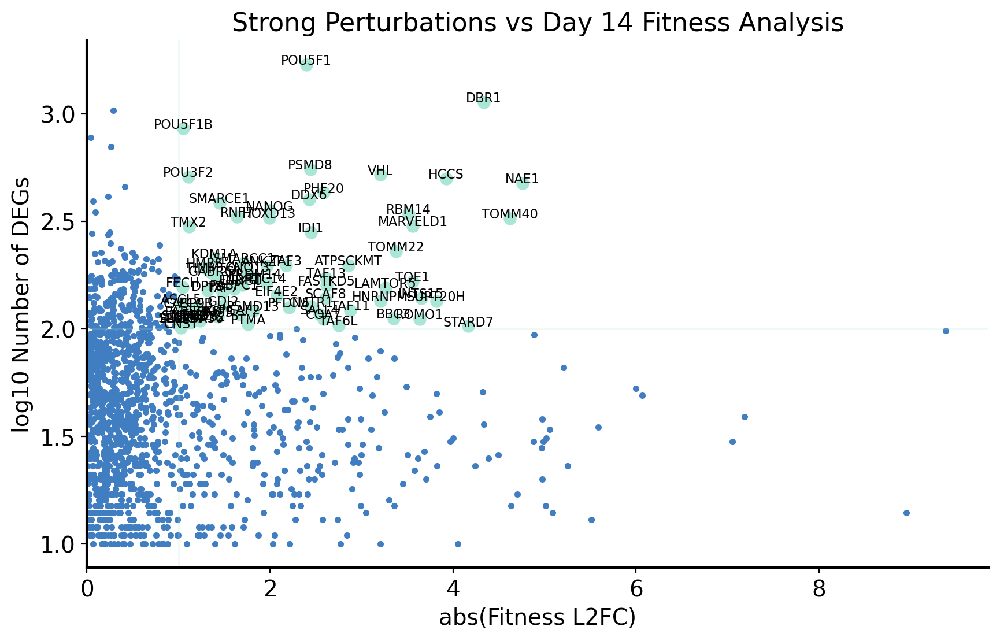

In [9]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Load the data
df = pd.read_csv("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/input_files/fitness_results.csv", sep='\t')
day_6_fitness = dict(zip(df["Gene_Day_6"], df["Day_6_Fitness"]))
day_14_fitness = dict(zip(df["Gene_Day_14"], df["Day_14_Fitness"]))
perturbations = [pert for pert in sorted_deg_list if pert in day_6_fitness.keys()]

# Prepare data for plotting
n_degs = [np.log10(sorted_deg_list[pert]) for pert in perturbations]
day_6_fitness_vals = [abs(day_6_fitness[pert]) for pert in perturbations]
day_14_fitness_vals = [abs(day_14_fitness[pert]) for pert in perturbations]

# Convert to DataFrame for plotting and include perturbation labels
plot_data_day6 = pd.DataFrame({
    'Perturbation': perturbations,
    'abs(Fitness L2FC)': day_6_fitness_vals, 
    'log10 Number of DEGs': n_degs
})
plot_data_day14 = pd.DataFrame({
    'Perturbation': perturbations,
    'abs(Fitness L2FC)': day_14_fitness_vals, 
    'log10 Number of DEGs': n_degs
})

# Function to create scatter plots with labels and cutoff lines
def degs_v_fitness(data, title, degs_cutoff=100, fitness_cutoff=2.5):
    fig, ax = plt.subplots(figsize=(10, 6))  # Increased figure size for better visibility
    # Scatter plot
    scatter = ax.scatter(x='abs(Fitness L2FC)', y='log10 Number of DEGs', data=data, color='#417dc1', marker='.')

    # Label and highlight specific perturbations based on conditions
    for i, row in data.iterrows():
        if row['log10 Number of DEGs'] > np.log10(degs_cutoff) and row['abs(Fitness L2FC)'] > fitness_cutoff:
            ax.scatter(row['abs(Fitness L2FC)'], row['log10 Number of DEGs'], color='#a9e6d5', s=50)  # Frosted mint color
            ax.annotate(row['Perturbation'], 
                        (row['abs(Fitness L2FC)'], row['log10 Number of DEGs']),
                        textcoords="offset points",
                        xytext=(0,0),
                        ha='center',
                        fontsize=8)

    # Add horizontal and vertical lines at cutoffs
    ax.axhline(y=np.log10(degs_cutoff), color='#a9e6d5', linestyle='-',linewidth=0.5)  # DEGs cutoff line
    ax.axvline(x=fitness_cutoff, color='#a9e6d5', linestyle='-',linewidth=0.5)  # Fitness cutoff line

    # Styling
    ax.set_facecolor('white')
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_linewidth(1.5)
    ax.spines['left'].set_linewidth(1.5)
    plt.xlabel('abs(Fitness L2FC)', fontsize=14)
    plt.ylabel('log10 Number of DEGs', fontsize=14)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.xlim(left=0)  # Setting x-axis limit to 3
    plt.title(title, fontsize=16)
    plt.grid(False)
    plt.show()
    return fig

# Create scatter plots for Day 6 and Day 14 with custom cutoffs
f = degs_v_fitness(plot_data_day6, 'Strong Perturbations vs Day 6 Fitness Analysis', degs_cutoff=100, fitness_cutoff=1)
f2 = degs_v_fitness(plot_data_day14, 'Strong Perturbations vs Day 14 Fitness Analysis', degs_cutoff=100, fitness_cutoff=1)
f.savefig("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/output_files/day_6_fitness_correlation.svg")
f2.savefig("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/output_files/day_14_fitness_correlation.svg")


### Generating MDE Plot

In [1]:
import os
import tempfile
import numpy as np
import requests
import scanpy as sc
import scvi
import seaborn as sns
import torch
import sys, os
import anndata as ad
import matplotlib.pyplot as plt
module_dir = os.path.join(os.getcwd(), "/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_TF/analyses_scripts/")
if module_dir not in sys.path:
    sys.path.append(module_dir)
import perturb_seq_heuristic_pipeline as qc
import importlib
import matplotlib.pyplot as plt
importlib.reload(qc)
import anndata as ad
import pymde #type: ignore
import plotly.io as pio #type: ignore
import igraph as ig #type: ignore
import plotly.express as px 
import leidenalg #type: ignore
from sklearn.neighbors import kneighbors_graph
from scipy.spatial.distance import pdist, squareform
from sklearn.manifold import SpectralEmbedding
from tqdm_joblib import tqdm_joblib
from joblib import delayed, parallel_backend, Parallel
adata_alpha = ad.read_h5ad("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_ALPHA_Core_Cells.h5ad")
adata_beta = ad.read_h5ad("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_BETA_Core_Cells.h5ad")
adata_gamma = ad.read_h5ad("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_GAMMA_Core_Cells.h5ad")
import pandas as pd
alpha_degs = pd.read_excel("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/analysis_files/ALPHA_DEGs.xlsx")
beta_degs = pd.read_excel("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/analysis_files/BETA_DEGs.xlsx")
gamma_degs = pd.read_excel("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/analysis_files/GAMMA_DEGs.xlsx")

def create_deg_list(alpha_degs,beta_degs,gamma_degs, deg_cutoff=10, write = False):
    # Assuming 'combined_degs' is your DataFrame
    combined_degs = pd.concat([alpha_degs,beta_degs,gamma_degs],axis=1)

    # Step 1: Identify the _DEGs columns
    deg_columns = [col for col in combined_degs.columns if '_DEGs' in col]

    # Step 2: Count the non-NaN values in each _DEGs column
    non_nan_counts = combined_degs[deg_columns].notna().sum()

    # Step 3: Filter out column trios with fewer than 10 DEGs
    valid_deg_columns = non_nan_counts[non_nan_counts >= deg_cutoff].index.tolist()

    # Step 4: Sort the remaining _DEGs columns based on the count
    sorted_deg_columns = non_nan_counts.loc[valid_deg_columns].sort_values(ascending=False).index.tolist()

    # Step 5: Rearrange the DataFrame keeping the valid three adjacent columns together
    sorted_columns = []
    for deg_col in sorted_deg_columns:
        # Identify the corresponding L2FC and Adj_P columns
        base_name = deg_col.replace('_DEGs', '')
        l2fc_col = f'{base_name}_L2FC'
        adj_p_col = f'{base_name}_Adj_P'
        
        # Add these columns to the sorted list
        sorted_columns.extend([deg_col, l2fc_col, adj_p_col])

    # Rearrange the DataFrame with only the valid columns
    filtered_combined_degs = combined_degs[sorted_columns]
    if write:
        filtered_combined_degs.to_excel("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/analysis_files/Aggregate_DEGs.xlsx")
    strong_perturbations = [pert.split('_')[0] for pert in sorted_deg_columns] + ["NTC"]
    print(f"{len(strong_perturbations)} Perturbations Left at a cutoff of {deg_cutoff} DEGs")
    return strong_perturbations, filtered_combined_degs

In [13]:
strong_perturbations, DEGs = create_deg_list(alpha_degs,beta_degs,gamma_degs, deg_cutoff=10)
adata_alpha_filtered = adata_alpha[adata_alpha.obs.gene_target.isin(strong_perturbations)].copy()
adata_beta_filtered = adata_beta[adata_beta.obs.gene_target.isin(strong_perturbations)].copy()
adata_gamma_filtered = adata_gamma[adata_gamma.obs.gene_target.isin(strong_perturbations)].copy()
def _get_ntc_view(adata):
  return adata[adata.obs.perturbed=="False"]
adata_combined = ad.concat([adata_alpha_filtered,adata_beta_filtered,adata_gamma_filtered])
adata_combined.X = adata_combined.layers["counts"].copy()
median_NTC_UMIs = np.median(_get_ntc_view(adata_combined).obs.n_UMI_counts)
sc.pp.normalize_total(adata_combined, target_sum=median_NTC_UMIs)

1333 Perturbations Left at a cutoff of 10 DEGs
normalizing counts per cell
    finished (0:00:00)


In [14]:
def extract_top_n_degs_pval(combined_df, n):
    """
    Extract the top n DEGs (genes) for each perturbation with the lowest p-values.
    
    Parameters:
    - combined_df (pd.DataFrame): The combined DataFrame with DEGs, L2FC, and Adj_P columns for each perturbation.
    - n (int): The number of top DEGs to extract for each perturbation.
    
    Returns:
    - top_degs (dict): A dictionary where keys are perturbation names and values are lists of the top n DEGs (genes).
    """
    top_degs = set()
    perturbations = [col.split('_DEGs')[0] for col in combined_df.columns if '_DEGs' in col]
    
    for perturbation in perturbations:
        # Select the DEGs, L2FC, and Adj_P columns for the perturbation
        degs_col = f'{perturbation}_DEGs'
        adj_p_col = f'{perturbation}_Adj_P'
        
        # Create a DataFrame for the perturbation
        perturbation_df = combined_df[[degs_col, adj_p_col]].dropna()
        
        # Sort by p-value and select the top n DEGs
        top_degs.update(perturbation_df.sort_values(by=adj_p_col).head(n)[degs_col].tolist())
    
    return top_degs

def extract_top_up_down_degs(combined_df, up_degs, down_degs):
    """
    Extract the top x upregulated (L2FC > 0) and top y downregulated (L2FC < 0) DEGs (genes) for each perturbation.
    
    Parameters:
    - combined_df (pd.DataFrame): The combined DataFrame with DEGs, L2FC, and Adj_P columns for each perturbation.
    - x (int): The number of top upregulated DEGs to extract.
    - y (int): The number of top downregulated DEGs to extract.
    
    Returns:
    - up_down_degs (dict): A dictionary where keys are perturbation names and values are lists of the top upregulated and downregulated DEGs (genes).
    """
    up_down_degs = set()
    perturbations = [col.split('_DEGs')[0] for col in combined_df.columns if '_DEGs' in col]
    
    for perturbation in perturbations:
        # Select the DEGs and L2FC columns for the perturbation
        degs_col = f'{perturbation}_DEGs'
        l2fc_col = f'{perturbation}_L2FC'
        
        # Create a DataFrame for the perturbation
        perturbation_df = combined_df[[degs_col, l2fc_col]].dropna()
        
        # Extract top x upregulated DEGs
        upregulated_df = perturbation_df[perturbation_df[l2fc_col] > 0].sort_values(by=l2fc_col, ascending=False).head(up_degs)
        top_upregulated = upregulated_df[degs_col].tolist()
        
        # Extract top y downregulated DEGs
        downregulated_df = perturbation_df[perturbation_df[l2fc_col] < 0].sort_values(by=l2fc_col, ascending=True).head(down_degs)
        top_downregulated = downregulated_df[degs_col].tolist()
        
        # Combine the results
        up_down_degs.update(top_upregulated + top_downregulated)
    
    return up_down_degs

def create_HVG_set_pval(adata, DEG_df, top_n_DEGs=20, num_hvg=2000):
    """
    Create a set of highly variable genes (HVG) from the given AnnData object and a DataFrame of differentially expressed genes (DEGs).

    Parameters:
    adata (AnnData): AnnData object containing single-cell RNA-seq data.
    DEG_df (DataFrame): DataFrame containing differentially expressed genes.
    top_n_DEGs (int): Number of top DEGs to consider for each perturbation.

    Returns:
    AnnData: A subset of the input AnnData object containing only the HVGs.
    """
    
    # Select top_n_DEGs for each perturbation, or the maximum possible if fewer than top_n_DEGs
    top_DEGs = extract_top_n_degs_pval(DEG_df,n=top_n_DEGs)
    
    # Filter out any None or NaN values that may have been introduced
    deg_values = [gene for gene in top_DEGs if pd.notnull(gene)]
    unique_degs = set(deg_values)
    
    # Get the set of highly variable genes from adata
    if num_hvg > 0:
        sc.pp.highly_variable_genes(adata, n_top_genes=num_hvg, subset=False, flavor='seurat_v3', layer='counts',batch_key='run')
        unique_hvg = set(adata[:, adata.var['highly_variable']].var.index)
    else:
        unique_hvg = set()
    
    # Create the union of the two sets
    HVG_set = list(unique_degs.union(unique_hvg))
    
    # Print the size of the resulting HVG set
    print(f"Constructing a set of {len(HVG_set)} unique HVGs from {len(unique_degs)} unique DEGs and {len(unique_hvg)} unique HVGs")

    # Return the subset of adata containing only the HVGs
    return adata[:, adata.var.index.isin(HVG_set)].copy()


def create_HVG_set_top_n_degs(adata, DEG_df, up_DEGs=20, down_DEGs=20, num_hvg=2000):
    """
    Create a set of highly variable genes (HVG) from the given AnnData object and a DataFrame of differentially expressed genes (DEGs).

    Parameters:
    adata (AnnData): AnnData object containing single-cell RNA-seq data.
    DEG_df (DataFrame): DataFrame containing differentially expressed genes.
    top_n_DEGs (int): Number of top DEGs to consider for each perturbation.

    Returns:
    AnnData: A subset of the input AnnData object containing only the HVGs.
    """
    
    # Select top_n_DEGs for each perturbation, or the maximum possible if fewer than top_n_DEGs
    top_DEGs = extract_top_up_down_degs(DEG_df,up_DEGs,down_DEGs)
    
    # Filter out any None or NaN values that may have been introduced
    deg_values = [gene for gene in top_DEGs if pd.notnull(gene)]
    unique_degs = set(deg_values)
    
    # Get the set of highly variable genes from adata
    if num_hvg > 0:
        sc.pp.highly_variable_genes(adata, n_top_genes=num_hvg, subset=False, flavor='seurat_v3', layer='counts', batch_key='run')
        unique_hvg = set(adata[:, adata.var['highly_variable']].var.index)
    else:
        unique_hvg = set()
    
    # Create the union of the two sets
    HVG_set = list(unique_degs.union(unique_hvg))
    
    # Print the size of the resulting HVG set
    print(f"Constructing a set of {len(HVG_set)} unique HVGs from {len(unique_degs)} unique DEGs and {len(unique_hvg)} unique HVGs")

    # Return the subset of adata containing only the HVGs
    return adata[:, adata.var.index.isin(HVG_set)].copy()

def create_HVG_set_top_n_degs_replogle(adata, top_degs=10, num_hvg=2000):
    """
    Create a set of highly variable genes (HVG) from the given AnnData object and a DataFrame of differentially expressed genes (DEGs).

    Parameters:
    adata (AnnData): AnnData object containing single-cell RNA-seq data.
    DEG_df (DataFrame): DataFrame containing differentially expressed genes.
    top_n_DEGs (int): Number of top DEGs to consider for each perturbation.

    Returns:
    AnnData: A subset of the input AnnData object containing only the HVGs.
    """
    
    # Select top_n_DEGs for each perturbation, or the maximum possible if fewer than top_n_DEGs
    with open("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/input_files/pertubation_associated_DEGs.txt",'r') as f:
        top_DEGs = [line.strip("\n") for line in f.readlines()]

    unique_degs = set(top_DEGs[:top_degs])

    adata_filtered = adata.copy()
    sc.pp.filter_genes(adata_filtered, min_cells=25)
    sc.pp.highly_variable_genes(adata_filtered, n_top_genes=num_hvg, subset=False, flavor='seurat_v3', layer='counts', batch_key='run')
    unique_hvg = set(adata_filtered[:, adata_filtered.var['highly_variable']].var.index)
    # Create the union of the two sets
    HVG_set = list(unique_degs.union(unique_hvg))
    
    # Print the size of the resulting HVG set
    print(f"Constructing a set of {len(HVG_set)} unique HVGs from {len(unique_degs)} unique DEGs and {len(unique_hvg)} unique HVGs")

    # Return the subset of adata containing only the HVGs
    return adata[:, adata.var.index.isin(HVG_set)].copy()


def relative_z_normalization(adata):
    ntc_adata = adata[adata.obs.perturbed == "False", :].copy()
    
    # Convert sparse matrix to dense if necessary
    X_dense = ntc_adata.X.toarray() if hasattr(ntc_adata.X, 'toarray') else ntc_adata.X
    
    # Compute mean and standard deviation
    mu_ntc = X_dense.mean(axis=0)
    std_ntc = X_dense.std(axis=0)
    
    # Handle division by zero by replacing zeros with ones
    std_ntc[std_ntc == 0] = 1
    
    # Normalize the entire dataset using the computed mean and std from control cells
    X_normalized = np.clip((adata.X - mu_ntc) / std_ntc,a_max=10,a_min=-10)

    
    # Replace the data in adata with the normalized data
    adata.layers["pre_z_normalization"] = adata.X.copy()
    adata.X = np.asarray(X_normalized)


def subtraction_normalization(adata):
    ntc_adata = adata[adata.obs.perturbed == "False", :].copy()
    
    # Convert sparse matrix to dense if necessary
    X_dense = ntc_adata.X.toarray() if hasattr(ntc_adata.X, 'toarray') else ntc_adata.X
    
    # Compute mean and standard deviation
    mu_ntc = X_dense.mean(axis=0)
    
    # Normalize the entire dataset using the computed mean and std from control cells
    X_normalized = adata.X - mu_ntc

    
    # Replace the data in adata with the normalized data
    adata.layers["pre_z_normalization"] = adata.X.copy()
    adata.X = np.asarray(X_normalized)

def z_normalization(adata):
    X_dense = adata.X.toarray()
    mu = X_dense.mean(axis=0)
    std =  X_dense.std(axis=0)
    plt.hist(std)
    z_norm = (X_dense-mu)/std
    z_norm = np.asarray(z_norm)
    ntc_mean = z_norm[adata.obs.perturbed == "False"].mean(axis=0)
    z_norm = z_norm - ntc_mean
    np.clip(z_norm, a_max=10, a_min=-10)
    adata.layers["pre_z_normalization"] = adata.X.copy()
    adata.X = np.asarray(z_norm)

In [15]:
sc.pp.log1p(adata_combined)
a = adata_combined[adata_combined.obs.run == 'ALPHA'].copy()
b = adata_combined[adata_combined.obs.run == 'BETA'].copy()
c = adata_combined[adata_combined.obs.run == 'GAMMA'].copy()
relative_z_normalization(a)
relative_z_normalization(b)
relative_z_normalization(c)
normalized_adata = ad.concat([a,b,c])
#normalized_adata.write("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_Strong_Perturbations_Batch_Normalized.h5ad")
adata_mde_z_normalized = create_HVG_set_top_n_degs(normalized_adata,DEGs,up_DEGs=0,down_DEGs=0,num_hvg=2000)

extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)
Constructing a set of 2000 unique HVGs from 0 unique DEGs and 2000 unique HVGs


Computing mean profiles:   0%|          | 0/1333 [00:00<?, ?it/s]

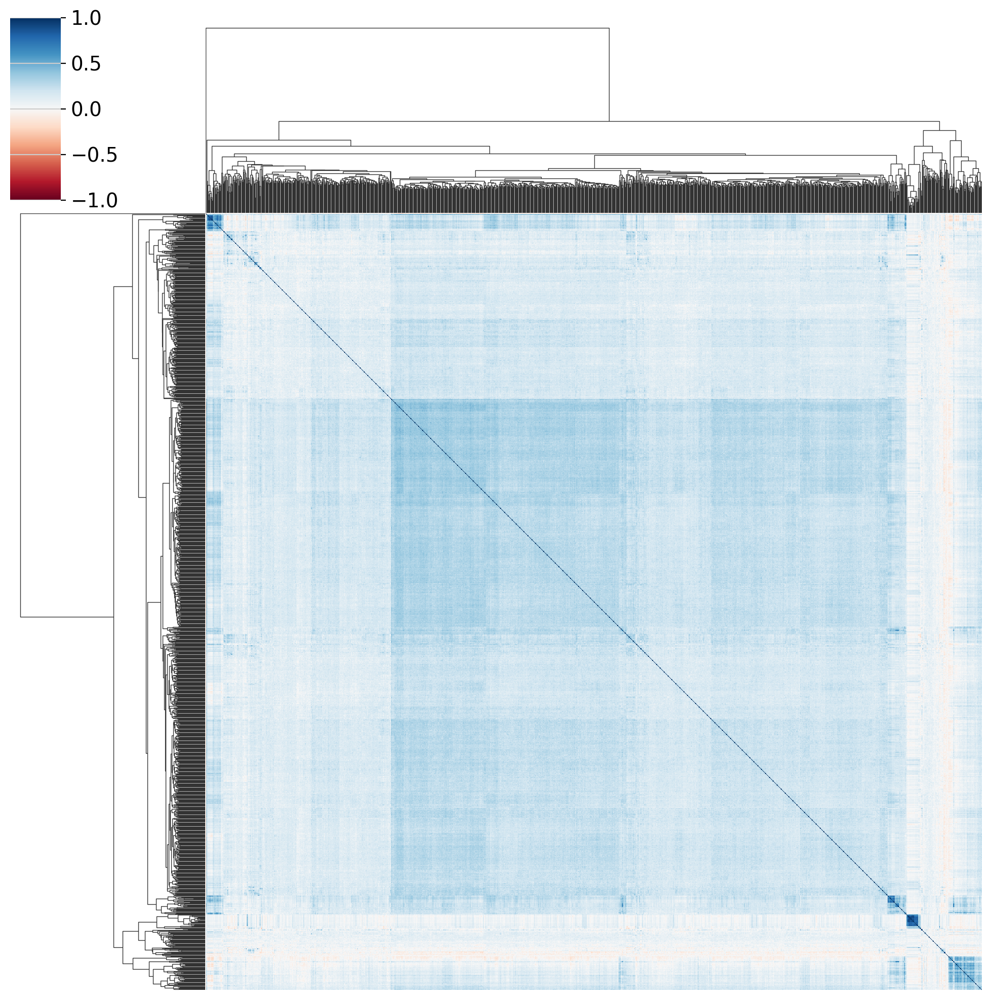

In [25]:
from scipy.spatial.distance import squareform, pdist
from tqdm_joblib import tqdm_joblib
from scipy.stats import spearmanr

# Define the function to compute the mean normalized profile
def compute_mean_profile(adata, group_indices):
    mean_vector = adata[group_indices, :].X.mean(axis=0)
    return mean_vector.A1 if hasattr(mean_vector, 'A1') else mean_vector

def create_corrmatrix(adata, title):
    gene_target_groups = adata.obs.groupby('gene_target').indices
        # Initialize tqdm progress bar
    with tqdm_joblib(desc="Computing mean profiles", total=len(gene_target_groups)) as progress_bar:
        # Compute the mean expression profile for each group in parallel
        with parallel_backend('threading'):
            mean_profiles = Parallel(n_jobs=-1)(
                delayed(compute_mean_profile)(adata, indices) 
                for indices in gene_target_groups.values()
            )
    mean_profiles = np.array(mean_profiles)
    corr_matrix = np.corrcoef(mean_profiles)
    gene_target_labels = list(gene_target_groups.keys())
    distance_df = pd.DataFrame(corr_matrix, index=gene_target_labels, columns=gene_target_labels)
    fig = sns.clustermap(distance_df,cmap="RdBu",xticklabels=False, yticklabels=False,vmax=1,vmin=-1,center=0)
    fig.ax_heatmap.set_xlabel('')
    fig.ax_heatmap.set_ylabel('');
    fig.ax_heatmap.set_title(title)
    #distance_df.to_csv("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/output_files/Aggregate_correlation_distances.csv")
    #fig.savefig("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/output_files/Aggregate_clustermap.svg")
    return(distance_df,mean_profiles)

data, mp = create_corrmatrix(adata_mde_z_normalized,title='')

<Axes: >

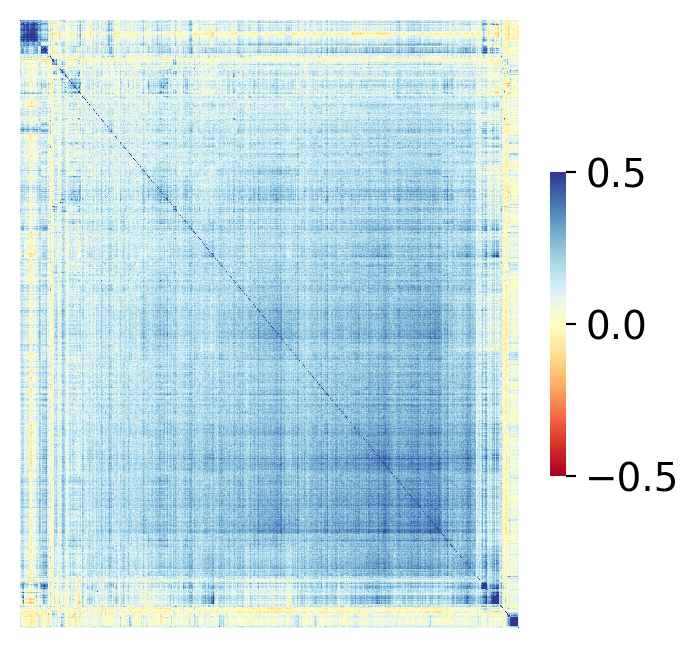

In [26]:
import anndata as ad
from scipy.spatial.distance import squareform, pdist
from tqdm_joblib import tqdm_joblib
from scipy.stats import spearmanr
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import linkage
import scanpy as sc
from joblib import delayed, parallel_backend, Parallel

# Generate the linkage matrix using 'average' method and 'correlation' metric
linkage_matrix = linkage(data, method='average', metric='correlation')
# Reorder the data based on the clustering results
from scipy.cluster.hierarchy import leaves_list
reordered_index = leaves_list(linkage_matrix)
data_reordered = data.iloc[reordered_index, reordered_index]
# Create a heatmap using seaborn's heatmap function without labels and without dendrograms
sns.heatmap(data_reordered, cmap='RdYlBu', center=0, vmin=-0.5, vmax=0.5,
            xticklabels=False, yticklabels=False, cbar_kws={'shrink': 0.5})

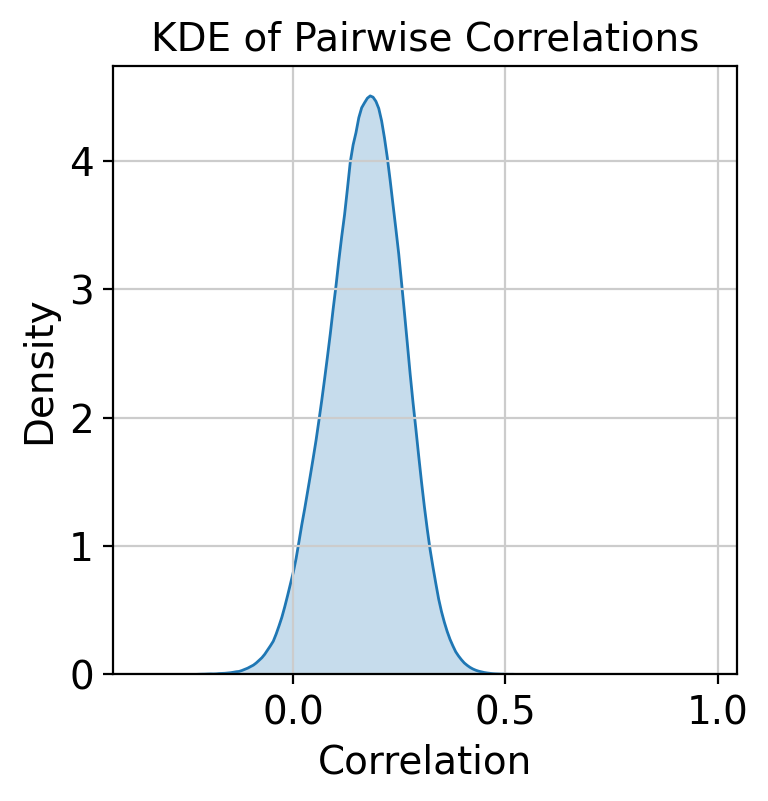

In [33]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Compute correlations (assuming 'mp' is the mean profiles matrix)
correlations = np.corrcoef(mp)

# Mask the diagonal and extract non-diagonal elements
mask = np.where(~np.eye(correlations.shape[0], dtype=bool))
all_corr = correlations[mask].flatten()

# Create the KDE plot
sns.kdeplot(all_corr, fill=True)  # 'fill=True' adds color fill under the KDE curve

# Add labels and show the plot
plt.xlabel('Correlation')
plt.ylabel('Density')
plt.title('KDE of Pairwise Correlations')
plt.show()


In [59]:
def compute_UMAP(adata):
    adata_copy = adata.copy()
    sc.pp.scale(adata_copy)
    sc.pp.pca(adata_copy)
    sc.pp.neighbors(adata_copy)
    sc.tl.umap(adata_copy,min_dist=0.9)
    sc.pl.umap(adata_copy,color=["perturbed","run"])
    sc.pl.umap(_get_ntc_view(adata_copy),color=["perturbed","run"],title="NTC Cells")
    sc.tl.embedding_density(adata_copy, groupby="perturbed")
    sc.pl.embedding_density(adata_copy, groupby="perturbed",fg_dotsize=100,color_map='Reds')
    sc.tl.embedding_density(adata_copy, groupby="gene_target")
    sc.pl.embedding_density(adata_copy, groupby="gene_target",group=["NTC","POU5F1","FLYWCH2","MYADM","DBR1","DNMT1","JOSD1","ST13"],return_fig=True,color_map="Reds",frameon=False,fg_dotsize=100)
    return adata_copy

computing PCA
    with n_comps=50
    finished (0:00:32)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)
computing neighbors
    computing neighbors
    using 'X_pca' with n_pcs = 50
    computed neighbors (0:00:12)
    computed connectivities (0:00:00)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:12)
computing UMAP


  0%|          | 0/200 [00:00<?, ?it/s]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:06)


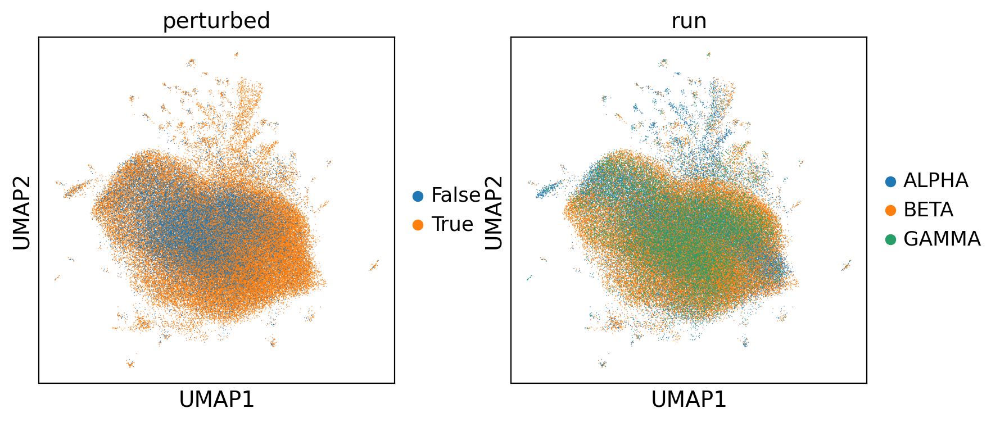

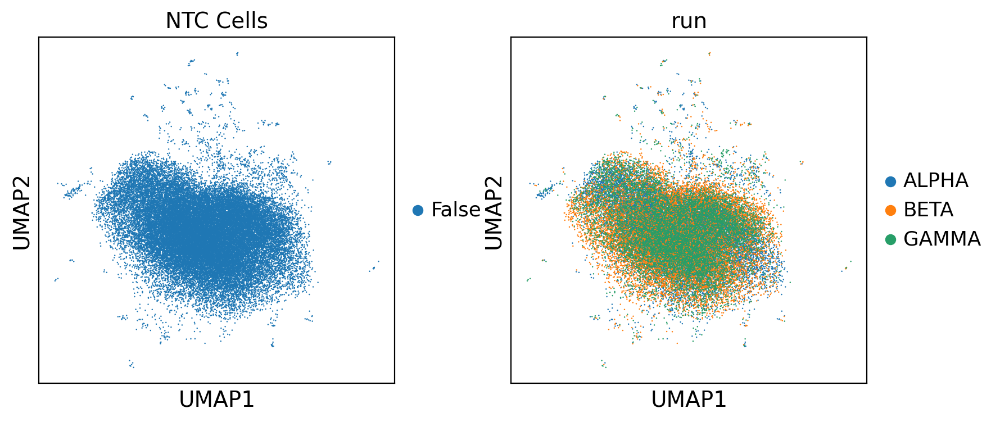

computing density on 'umap'
--> added
    'umap_density_perturbed', densities (adata.obs)
    'umap_density_perturbed_params', parameter (adata.uns)


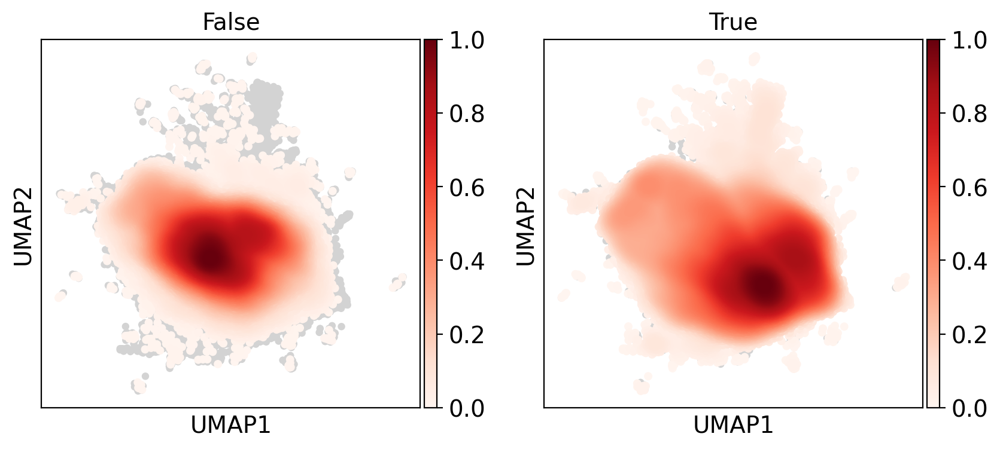

computing density on 'umap'
--> added
    'umap_density_gene_target', densities (adata.obs)
    'umap_density_gene_target_params', parameter (adata.uns)


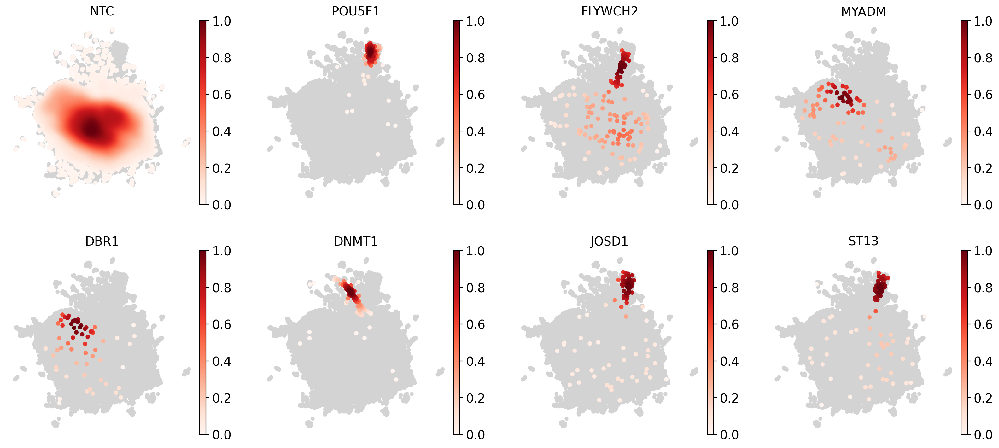

In [60]:
adata_copy = compute_UMAP(adata_mde_z_normalized)

running Leiden clustering
    finished: found 31 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:28)


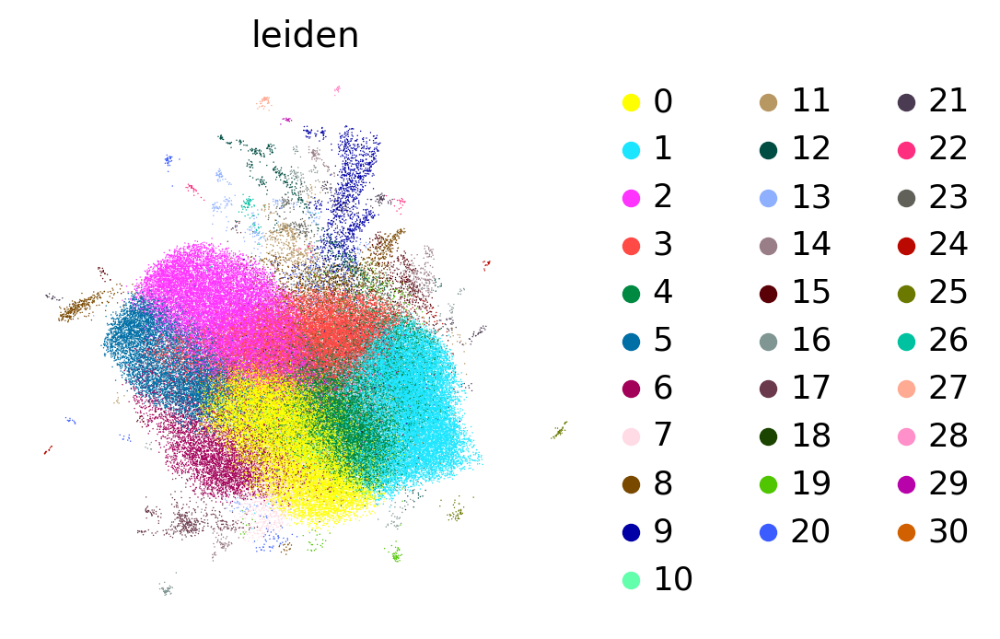

In [71]:
sc.tl.leiden(adata_copy,n_iterations=2)
sc.pl.umap(adata_copy, color="leiden",frameon=False)

In [67]:
adata_copy.write("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_UMAP_Computed.h5ad")

In [ ]:
import anndata as ad
adata_full = ad.read_h5ad("/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/adata_files/Aggregate_Strong_Perturbations_Batch_Normalized.h5ad")

In [ ]:
ntc = adata_full[adata_full.obs.perturbed == "False"].copy()

In [ ]:
import scanpy as sc
sc.pp.highly_variable_genes(ntc, n_top_genes=2000, subset=True, flavor='seurat_v3', layer='counts', batch_key='run')

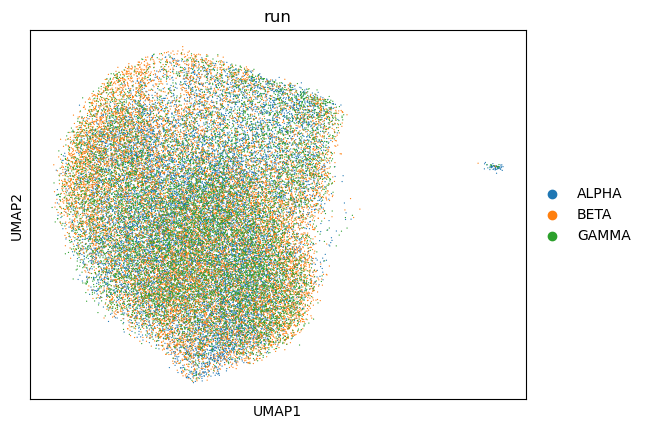

In [ ]:
sc.pp.pca(ntc)
sc.pp.neighbors(ntc)
sc.tl.umap(ntc)
sc.pl.umap(ntc, color=['run'])

In [51]:
import pymde #type: ignore
import plotly.io as pio #type: ignore
import igraph as ig #type: ignore
import plotly.express as px 
import leidenalg #type: ignore
from sklearn.neighbors import kneighbors_graph
from scipy.spatial.distance import pdist, squareform
from sklearn.manifold import SpectralEmbedding
from tqdm_joblib import tqdm_joblib
from joblib import delayed, parallel_backend, Parallel

# Define the function to compute the mean normalized profile
def compute_mean_normalized_profile(adata, group_indices):
    mean_vector = adata[group_indices, :].X.mean(axis=0)
    normalized_mean_vector = (mean_vector - np.mean(mean_vector)) / np.std(mean_vector)
    return normalized_mean_vector.A1 if hasattr(normalized_mean_vector, 'A1') else normalized_mean_vector

def compute_MDE_2(adata, save=True, save_dir_stem=None, leiden_neighbors=5, preserve='neighbors', spectral=False):
    adata_mde = adata

    # Group by gene_target and get indices for each group
    gene_target_groups = adata_mde.obs.groupby('gene_target').indices

    # Initialize tqdm progress bar
    with tqdm_joblib(desc="Computing mean profiles", total=len(gene_target_groups)) as progress_bar:
        # Compute the mean expression profile for each group in parallel
        with parallel_backend('threading'):
            mean_profiles = Parallel(n_jobs=-1)(
                delayed(compute_mean_normalized_profile)(adata_mde, indices) 
                for indices in gene_target_groups.values()
            )
    
    # Convert the list of mean profiles to a numpy array
    mean_profiles_array = np.array(mean_profiles)

    # Compute MDE
    mde = None
    embedding = None
    if preserve == "neighbors":
        if spectral:
            spectral_embedding = SpectralEmbedding(
                n_components=30,  # Ensure this matches the pymde embedding dimension
                affinity='nearest_neighbors',
                n_neighbors=10,
                eigen_solver='arpack'
            )
            initial_embedding = spectral_embedding.fit_transform(mean_profiles_array)
            mde = pymde.preserve_neighbors(initial_embedding, repulsive_fraction=15, n_neighbors = 15)
            embedding = mde.embed(max_iter=2000,print_every=100,verbose=True)
        else:
            mde = pymde.preserve_neighbors(mean_profiles_array, repulsive_fraction=15, n_neighbors=5)
            embedding = mde.embed(max_iter=4000,print_every=100,verbose=True)
    else:
        mde = pymde.preserve_distances(mean_profiles_array)
        embedding = mde.embed(max_iter=1000,print_every=100,verbose=True)
    
    
    # Run Leiden clustering on the embeddings
    knn_graph = kneighbors_graph(embedding, n_neighbors=leiden_neighbors, include_self=False)
    sources, targets = knn_graph.nonzero()
    g = ig.Graph(directed=False)
    g.add_vertices(embedding.shape[0])
    g.add_edges(zip(sources, targets))
    partition = leidenalg.find_partition(g, leidenalg.RBConfigurationVertexPartition)
    
    # Get cluster labels and make pairwise correlation plot
    clusters = np.array(partition.membership)
    gene_targets = list(gene_target_groups.keys())
    embedding_df = pd.DataFrame(embedding, columns=['x', 'y'])
    embedding_df['gene_target'] = gene_targets
    embedding_df['cluster'] = clusters
    embedding_df['cluster'] = embedding_df['cluster'].astype(str)
    cluster_groups = embedding_df.groupby('cluster')
    centroids = cluster_groups[['x', 'y']].mean()
    pairwise_distances = pd.DataFrame(
        squareform(pdist(centroids, metric='euclidean')),
        index=centroids.index,
        columns=centroids.index
    )
    sns.clustermap(pairwise_distances, cmap='PuBuGn')
    plt.title('Pairwise Distance Matrix of Cluster Centroids')
    plt.show()


    # Plot using Plotly with Pastel colormap for discrete clusters
    fig = px.scatter(embedding_df, x='x', y='y', text='gene_target', color='cluster',
                     hover_data={'x': True, 'y': True, 'gene_target': True},
                     title='MDE Embedding of Mean Normalized Profiles',
                     color_discrete_sequence=px.colors.qualitative.Bold)
    fig.update_traces(marker=dict(size=7,opacity=0.7),textposition='middle center',textfont=dict(size=4))
    
    
    fig.update_layout(
        showlegend=True,
        xaxis=dict(visible=False),
        yaxis=dict(visible=False),
        plot_bgcolor='white',
        width=1200,  # Increase plot width
        height=1000,  # Increase plot height
        legend_title_text='Cluster',
        coloraxis_showscale=False
    )
    if save:
        pio.write_html(fig, file=save_dir_stem+"_MDE.html")
        embedding_df.to_excel(save_dir_stem+"_clusters.xlsx", index=False)
        fig.update_traces(text=None)
        fig.write_image(save_dir_stem+"_MDE.svg")
   
    fig.show()
    
    return adata_mde, embedding, clusters, mean_profiles_array


def compute_corum(fp):
    corum_complex_file_path = "/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_TF/utility_files/humanComplexes.json"
    entrez_to_ensg_file_path = "/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_TF/utility_files/entrez_to_ensg.txt"
    clusters_file_path = f"/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/output_files/{fp}_clusters.xlsx"
    gene_to_ensg_filepath = "/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/input_files/gene_ids.txt"


    def gene_ids_to_ensg(filepath):
            ensembl_ids = {}
            with open(filepath, 'r') as file:
                for line in file:
                    gene, ensg = line.strip().split('\t')
                    ensembl_ids[gene] = ensg
            return ensembl_ids

    def check_two_thirds(A, B):
        # Calculate the total number of elements in B
        total_b = len(B)
        
        # Calculate the number of elements in B that are also in A
        count = sum(1 for element in B if element in A)
        
        # Calculate two-thirds of the total elements in B
        two_thirds_b = total_b * 2 / 3
        
        # Check if the count of common elements is at least two-thirds of B
        return count >= two_thirds_b

    ensg_to_entrez = {"NTC":-1}
    df = pd.read_json(corum_complex_file_path)
    complexes = {comp:ids for comp,ids in zip(df["ComplexName"],df["subunits(Entrez IDs)"])}
    complexes = {k:v.split(';') for k,v in complexes.items() if "homo" not in k}
    clusters = pd.read_excel(clusters_file_path)
    associated_complexes = {}
    with open(entrez_to_ensg_file_path,'r') as f:
        for line in f.readlines():
            entrez,ensg = line.strip().split("\t")
            ensg_to_entrez[ensg] = entrez
    gene_to_ensg = gene_ids_to_ensg(gene_to_ensg_filepath)
    for cluster,data in clusters.groupby('cluster'):
        associated_complexes[cluster] = []
        genes = [ensg_to_entrez[gene_to_ensg[gene]] for gene in data.gene_target]
        for comp in complexes:
            if check_two_thirds(genes, complexes[comp]):
                associated_complexes[cluster].append(comp)

    tot = 0
    for complex in associated_complexes:
        if len(associated_complexes[complex]) > 0:
            tot += len(associated_complexes[complex])
            print(complex, '\t|', ', '.join(associated_complexes[complex]))
    print(f"Total complexes: {tot}")

Computing mean profiles:   0%|          | 0/1333 [00:00<?, ?it/s]

Sep 11 11:16:44 AM: Fitting a centered embedding into R^2, for a graph with 1333 items and 238460 edges.
Sep 11 11:16:44 AM: `embed` method parameters: eps=1.0e-05, max_iter=2000, memory_size=10
Sep 11 11:16:44 AM: iteration 0000 | distortion 1.616086 | residual norm 0.26088 | step length 0.528082 | percent change 0.266816
Sep 11 11:16:46 AM: iteration 0100 | distortion 0.095355 | residual norm 0.000130708 | step length 1 | percent change 0.230671
Sep 11 11:16:48 AM: iteration 0200 | distortion 0.094099 | residual norm 4.05755e-05 | step length 1 | percent change 0.0811736
Sep 11 11:16:50 AM: iteration 0300 | distortion 0.093902 | residual norm 4.06481e-05 | step length 1 | percent change 0.0249572
Sep 11 11:16:52 AM: iteration 0400 | distortion 0.093758 | residual norm 2.2966e-05 | step length 1 | percent change 0.0286702
Sep 11 11:16:52 AM: Converged in 449 iterations, with residual norm 8.51341e-06
Sep 11 11:16:52 AM: Finished fitting in 8.110 seconds and 449 iterations.
Sep 11 11:1

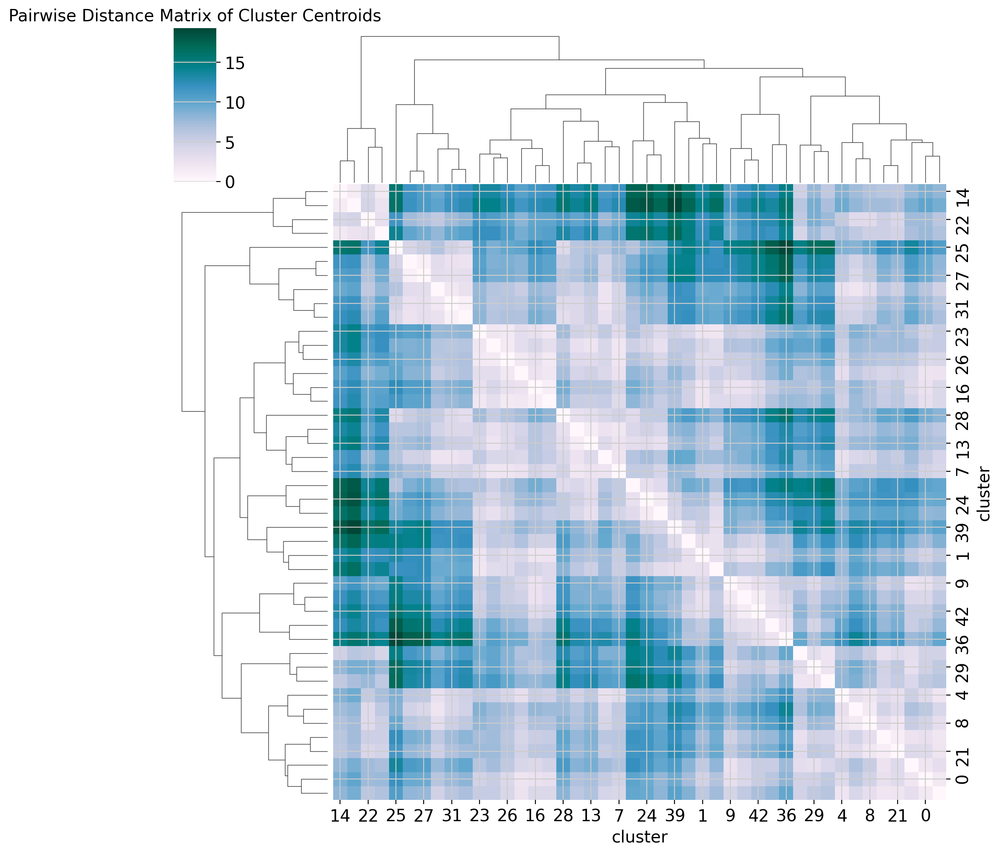

3 	| VHL-ElonginB-ElonginC complex
4 	| HSP90AA1-TSC1-TSC2 complex
9 	| hMediator complex (MED23, CDK8, CCNC), CDK8-CyclinC-Mediator complex, CNOT1-CNOT2-CNOT3 complex, CDK8 subcomplex (CCNC, CDK8, MED12), CDK8 subcomplex (CCNC, CDK8, MED13)
18 	| DNMT1-EHMT2-PCNA complex, DNMT1-EHMT2 complex
19 	| Cofilin-actin-CAP1 complex
22 	| p14-Mp1-MEK1 complex, p14-Mp1-ERK2 complex, Ragulator complex, Ragulator-Rag complex
24 	| MBD1-MCAF1-SETDB1 complex, SETDB1-containing HMTase complex
25 	| Apoptosome, Apoptosome, 700 kDa, TOM subcomplex (TOMM7, TOMM22, TOMM40), mitochondrial, Aposome complex
28 	| TGF-beta-receptor-PAR6 complex, TGF-beta receptor II-TGF-beta receptor I-TGF-beta3 complex, TGFbetaRII-TGFbetaRI-TGFbeta1 complex, SMAD3-TGFBR1-TGFBR2 complex, SEPTIN3A-SEPTIN3B-SEPTIN5 complex
29 	| PRMT5 complex, MEP50-PRMT5-ICLN complex, BRD7-EZH2-SUZ12 complex
34 	| HUSH complex
Total complexes: 29


In [61]:
compute_MDE_2(adata_mde_z_normalized, save=True, save_dir_stem="/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/output_files/Aggregate_Spectral_Sub", spectral=True,leiden_neighbors=8);
compute_corum("Aggregate_Spectral_Sub")

In [9]:
compute_MDE_2(adata_mde_z_normalized, save=True, save_dir_stem="/tscc/projects/ps-malilab/ydoctor/iPSC_Pan_Genome/Pan_Genome/output_files/Aggregate_Spectral", spectral=True,leiden_neighbors=8);
compute_corum("Aggregate_Spectral")

Computing mean profiles:   0%|          | 0/1333 [00:00<?, ?it/s]

/tscc/nfs/home/ydoctor/.local/lib/python3.11/site-packages/anndata/_core/anndata.py:1096: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
Exception ignored on calling ctypes callback function: <function ThreadpoolController._find_libraries_with_dl_iterate_phdr.<locals>.match_library_callback at 0x15550e7bb600>
Traceback (most recent call last):
  File "/opt/conda/lib/python3.11/site-packages/threadpoolctl.py", line 1008, in match_library_callback
    self._make_controller_from_path(filepath)
  File "/opt/conda/lib/python3.11/site-packages/threadpoolctl.py", line 1147, in _make_controller_from_path
    lib_controller = controller_class(
                     ^^^^^^^^^^^^^^^^^
  File "/opt/conda/lib/python3.11/site-packages/threadpoolctl.py", line 113, 

Sep 11 10:04:18 AM: Fitting a centered embedding into R^2, for a graph with 1333 items and 152496 edges.
Sep 11 10:04:18 AM: `embed` method parameters: eps=1.0e-05, max_iter=2000, memory_size=10
Sep 11 10:04:19 AM: iteration 0000 | distortion 2.667135 | residual norm 1.07692 | step length 0.0229335 | percent change 0.0478328
Sep 11 10:04:20 AM: iteration 0100 | distortion 0.086760 | residual norm 0.000167486 | step length 1 | percent change 0.602429
Sep 11 10:04:21 AM: iteration 0200 | distortion 0.084295 | residual norm 0.000169707 | step length 1 | percent change 0.370771
Sep 11 10:04:22 AM: iteration 0300 | distortion 0.083607 | residual norm 0.000101664 | step length 1 | percent change 0.208964
Sep 11 10:04:24 AM: iteration 0400 | distortion 0.082099 | residual norm 8.0721e-05 | step length 1 | percent change 0.0355582
Sep 11 10:04:25 AM: iteration 0500 | distortion 0.081920 | residual norm 5.67228e-05 | step length 1 | percent change 0.0653342
Sep 11 10:04:26 AM: iteration 0600 | 

KeyboardInterrupt: 